In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy import stats

import matplotlib as mpl
import matplotlib.lines as mlines


import FlowCal
from sklearn.mixture import GaussianMixture

In [2]:
mpl.rcParams["pdf.use14corefonts"] = False # True
mpl.rcParams['pdf.fonttype'] = 42  # Embed fonts as text, not outlines
mpl.rcParams["font.family"] = "sans-serif"
mpl.rcParams["font.sans-serif"] = ["Arial"]
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams["savefig.transparent"]=True
pd.set_option('display.max_columns', None)

cm = 1/2.54

fig_dir = '../figures/'

In [3]:
data_dir = '../data/'
exp_dir = data_dir+'fluor/04-30-24_Y1C1/'

#experiment to position on the 24 well block
def get_exp_to_pos():
    exp_to_pos = {}
    var_list = ['YC1.', 'YC3.', 'YC4.', 'YC5.', 'YC7.', 'YC8.', 'J.', 'Y.'] #variants
    pos_list = [(i//6, i%6) for i in range(24)]
    c = 0
    for v in range(len(var_list)):
        for j in range(3):
            exp_to_pos[var_list[v]+str(j+1)]=pos_list[c+j]
        c += 3
    return exp_to_pos

#timepoints ordered on plates as follows:
        
#plate 1
#_ T0
#_ _

#plate 2
#T1 T3
#T2 T4

def get_pos_to_wells(pos, timepoints=5):
    #well columns are 1index
    well_cols = [ 1+pos[1]+6, 1+pos[1], 1+pos[1], 1+pos[1]+6, 1+pos[1]+6]
    well_cols = [str(x) for x in well_cols]
    row_names = "ABCDEFGH"
    well_rows = [pos[0], pos[0], pos[0]+4, pos[0], pos[0]+4]
    well_rows= [row_names[i] for i in well_rows]
    prefix = ["plate1"]+["plate2"]*4
    return [(well_rows[i], well_cols[i], prefix[i]) for i in range(timepoints)]

exp_to_pos =  get_exp_to_pos()  #connect experiment to position on quadrant
pos_to_wells =  {pos:get_pos_to_wells(pos) for pos in exp_to_pos.values()}   #connect position on quadrant to list of wells

In [4]:
wells = []
for x in pos_to_wells.values():
    wells += x

In [16]:
exp_dir = data_dir + 'fluor/4-30-24_Y1C1/'
spec_names = {}
#specimen names, map well -> filename 
#well is (row, col, plate)

#for each quandrant of a plate, layout is:
# YC1x3 YC3x3
# YC4x3 YC5x3
# YC7x3 YC8x3
#   Jx3   Yx3

#for plate1, T0, this would be wells ABCD 7-11


c = 0
for row in "ABCD":
    for i in range(7,13):
        mod_str = str(i)
        if len(mod_str) == 1:
            mod_str = "0"+str(i)
        c+=1
        mod_c = "0"+str(c)
        if len(mod_c) == 2:
            mod_c = "0"+mod_c
        spec_names[(row, str(i), 'plate1')] = "T0/Specimen_001_"+row+str(i)+"_"+row+mod_str+"_"+mod_c+".fcs"      
#plate2
#T1 T3
#T2 T4
c = 0
for row in "ABCDEFGH":
    for i in range(1,13):
        mod_str = str(i)
        if len(mod_str) == 1:
            mod_str = "0"+str(i)
        c+=1
        mod_c = "0"+str(c)
        if len(mod_c) == 2:
            mod_c = "0"+mod_c
        spec_names[(row, str(i), 'plate2')] = "T1-T4/Specimen_001_"+row+str(i)+"_"+row+mod_str+"_"+mod_c+".fcs"

In [6]:
#label cells as yellow or red based on fluorescence thresholds. Return proportion of variant (yellow) cells
def split_red_yellow(fcs, visual=True, fs_visual=True, title="No Title", compare_to_wt = False):
    data=np.vstack((fcs[:, 'PE-Texas Red-A'],fcs[:, 'FITC-A']))#first row = red
    data_g=np.log10(data)
    #drop nan
    data_g = data_g[:,~np.isnan(data_g).any(axis=0)]
    #drop inf
    data_g = data_g[:,~np.isinf(data_g).any(axis=0)]
    
    fs_data = np.vstack((fcs[:, 'FSC-A'],fcs[:, 'SSC-A'])) #first row - forward scatter
    fs_data = fs_data[:, ~((np.isinf(np.log10(data)).any(axis=0)) | (np.isnan(np.log10(data)).any(axis=0)))]
    
    red_cutoff = 4.5
    red_mod = -1.7
    yellow_cutoff = 3
    yellow_mod = 0
    
    data_red = data_g[ :, data_g[1] < data_g[0] + red_mod]
    data_red = data_red[:, data_red[0] > red_cutoff]
    data_yellow =  data_g[:,  data_g[1]>data_g[0]+yellow_mod]
    data_yellow = data_yellow[:, data_yellow[1] > yellow_cutoff]
    
    
    fs_data_red = fs_data[:, (data_g[1] < data_g[0] + red_mod) & (data_g[0] > red_cutoff) ]
    fs_data_yellow = fs_data[:, (data_g[1] > data_g[0] + yellow_mod) & (data_g[1] > yellow_cutoff)]
    both_index = ((data_g[1] < data_g[0]+red_mod) & (data_g[0] > red_cutoff)) | ((data_g[1] > data_g[0] + yellow_mod) & (data_g[1] > yellow_cutoff))
    fs_data_none = fs_data[:, ~both_index]
    fs_data_both = fs_data[:, both_index] 
    if visual: #show fluorescence values and labeled populations
        plt.figure(figsize=(5,3), dpi=160)
        plt.plot(data_g[0], data_g[1], linestyle="None", marker="o", markersize=1, color="black", label="Uncategorized")
        plt.plot(data_red[0], data_red[1], linestyle="None", marker="o", markersize=1, color="red", label="RFP WT")
        plt.plot(data_yellow[0], data_yellow[1], linestyle="None", marker="o", 
                 markersize=1, color="orange", label="YFP Variant")
        plt.title(title)
        plt.xlabel("log10 PE-Texas Red-A")
        plt.ylabel("log10 FITC-A")
        plt.legend()
        plt.show()
    if fs_visual: #show forward and side scatter
        plt.figure(figsize=(5,3), dpi=160)
        plt.plot(fs_data_both[0], fs_data_both[1], markersize=0.5, linestyle="None", marker="o", color="orangered", label="WT/Variant")
        plt.plot(fs_data_none[0], fs_data_none[1], markersize=0.5, linestyle="None", marker="o", color="black", label="Uncategorized")
        plt.title(title)
        plt.xlabel("FSC-A")
        plt.ylabel("SSC-A")
        plt.legend()
        plt.show()
    if compare_to_wt:
        return max(data_yellow.shape[1], data_red.shape[1])/data_g.shape[1]
    return data_yellow.shape[1]/(data_red.shape[1] + data_yellow.shape[1])
        

('A', '7', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


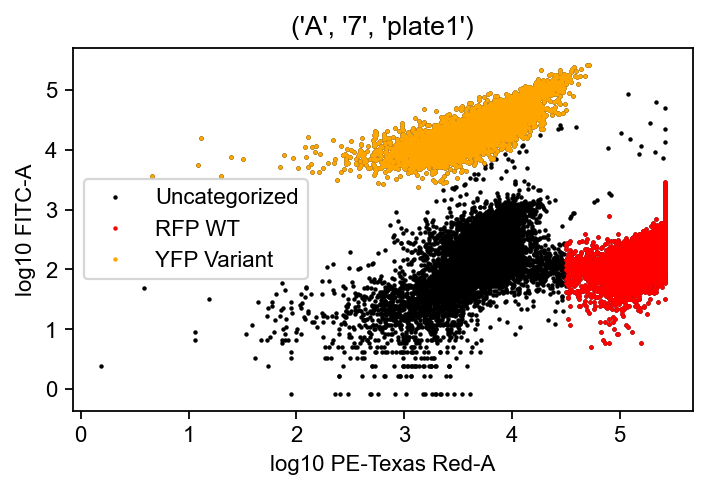

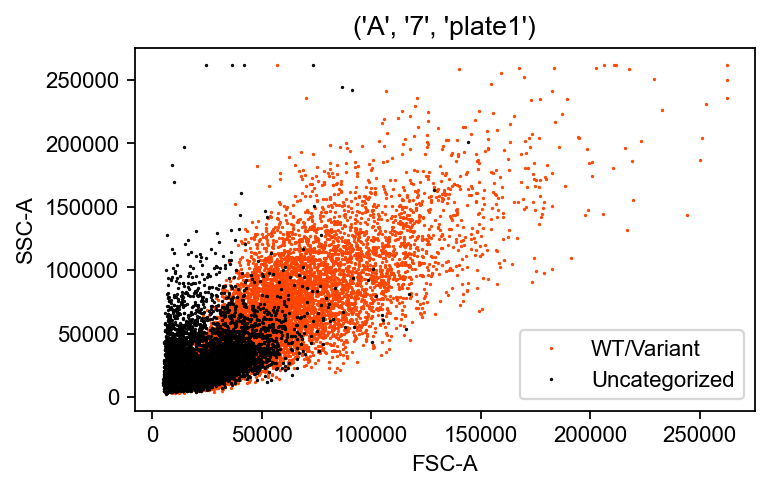

0.4417158090314242
('A', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


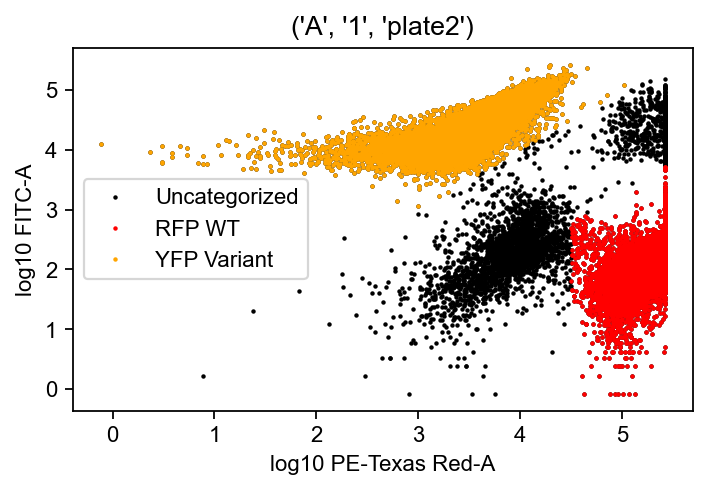

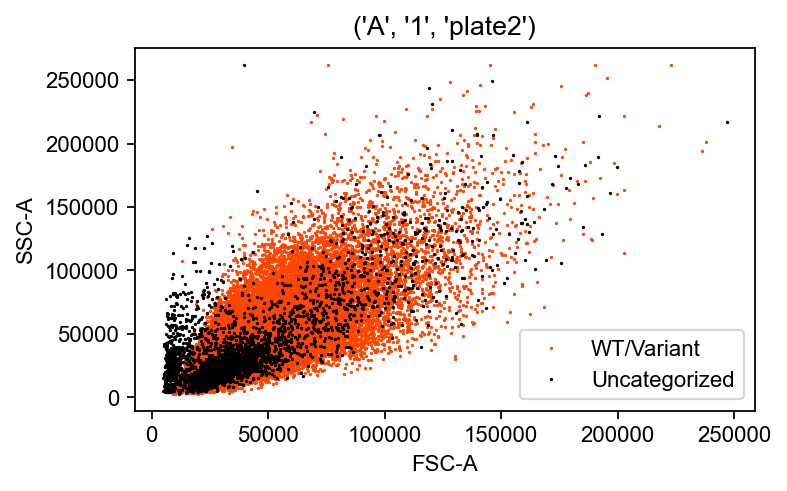

0.40395948836600165
('E', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


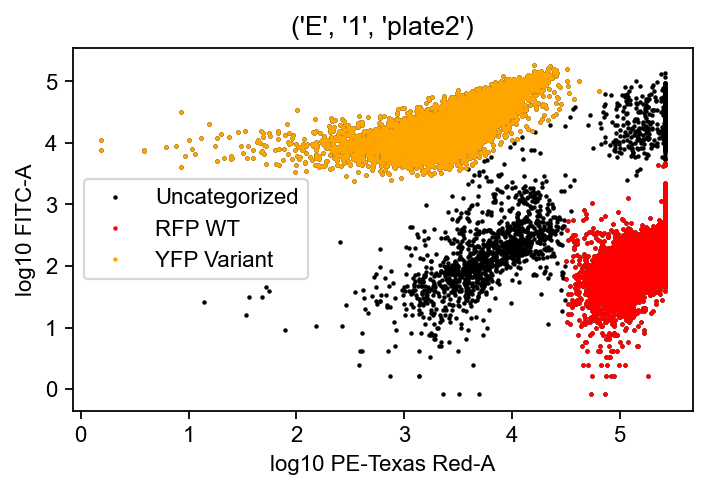

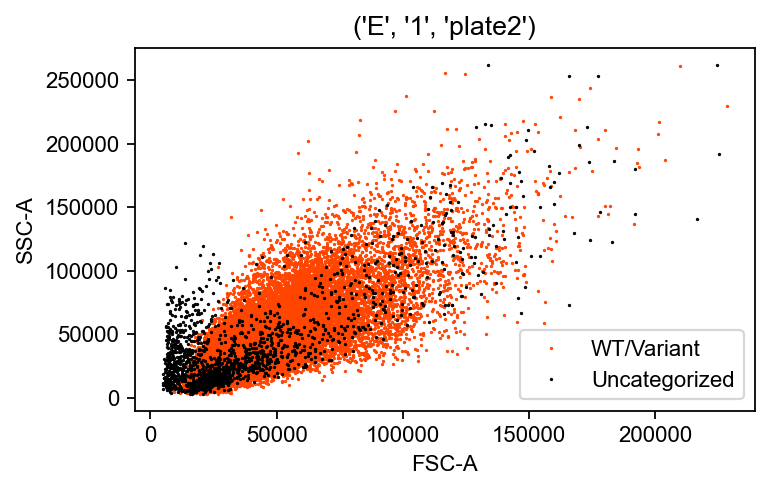

0.383143687856707
('A', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


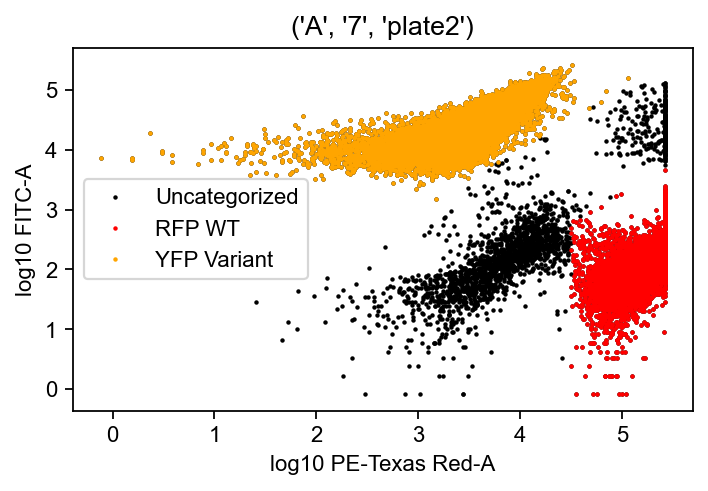

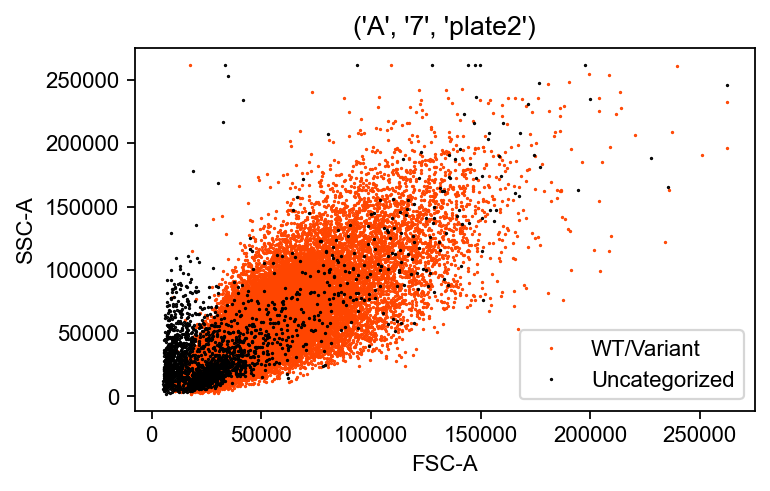

0.3566784557063894
('E', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


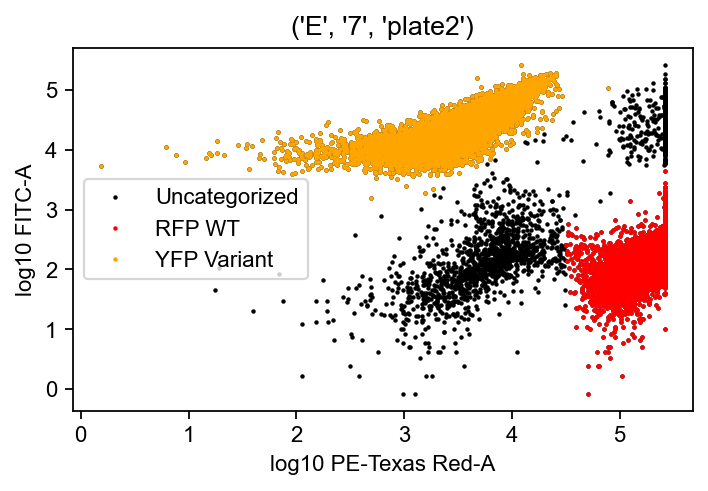

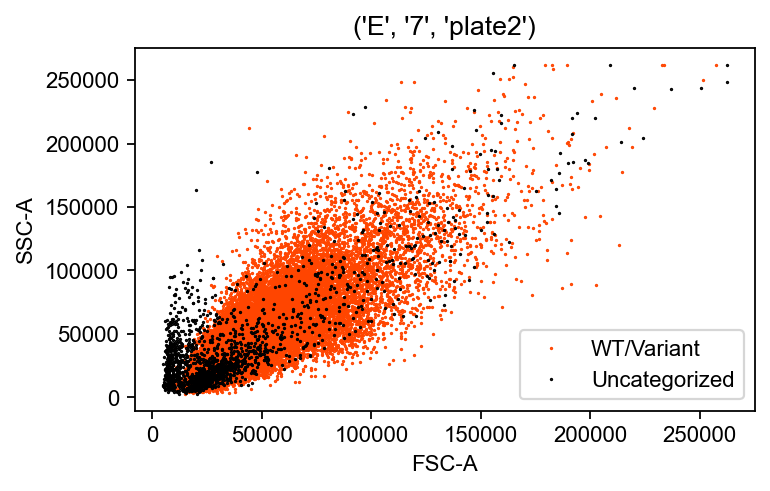

0.33938268076593314
('A', '8', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


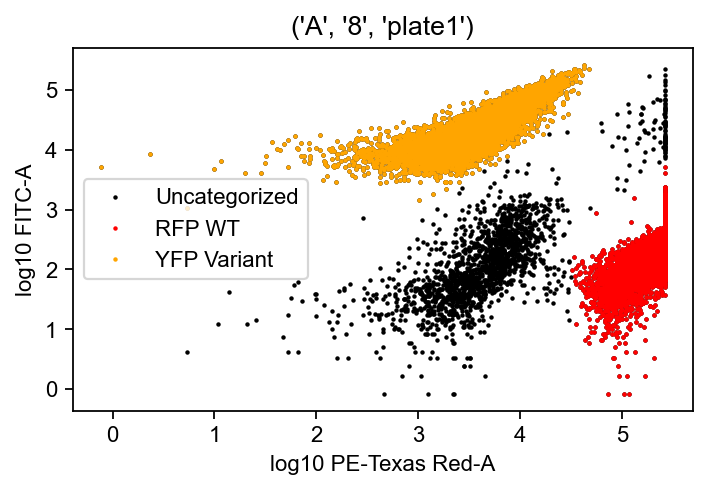

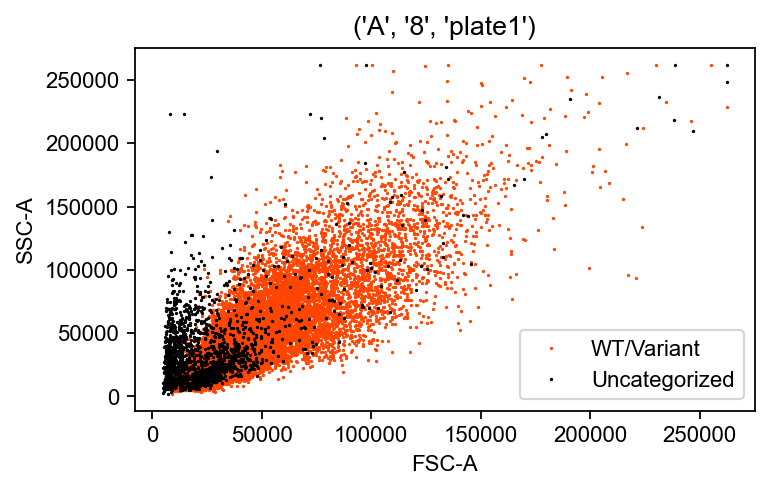

0.46069905278901013
('A', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


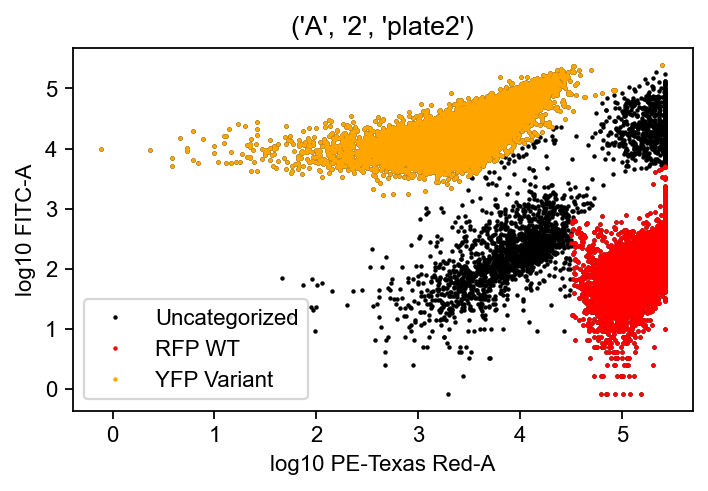

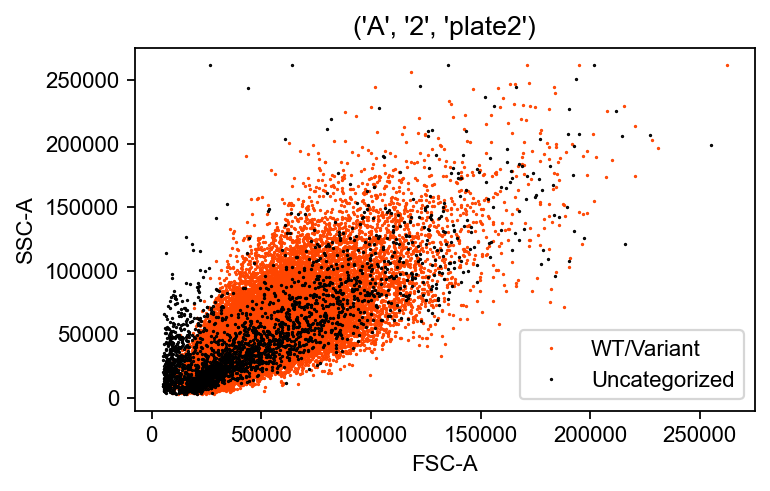

0.41835299210042204
('E', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


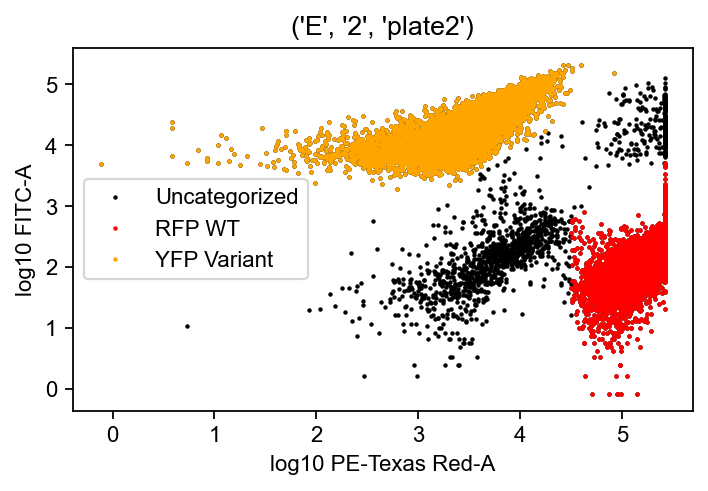

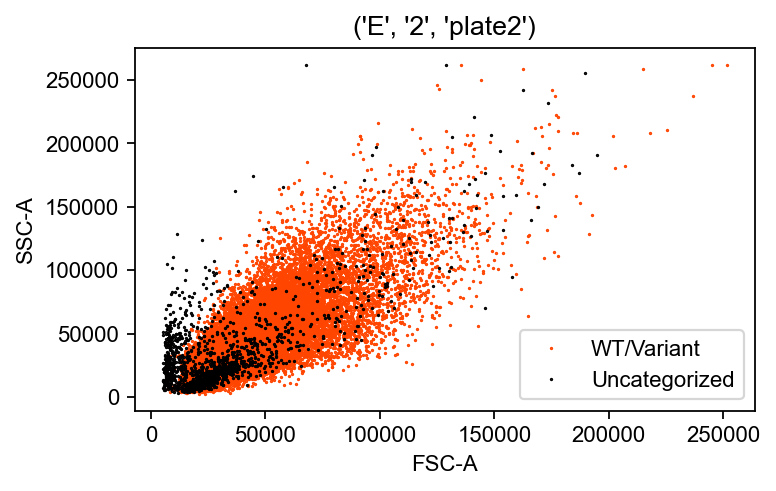

0.3969965481655457
('A', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


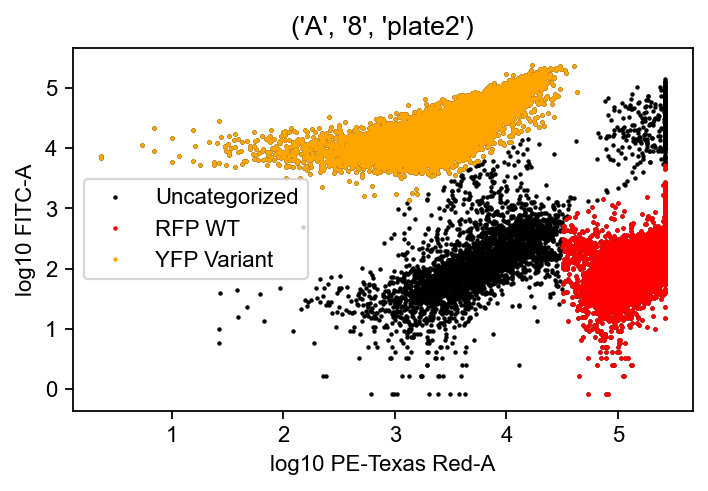

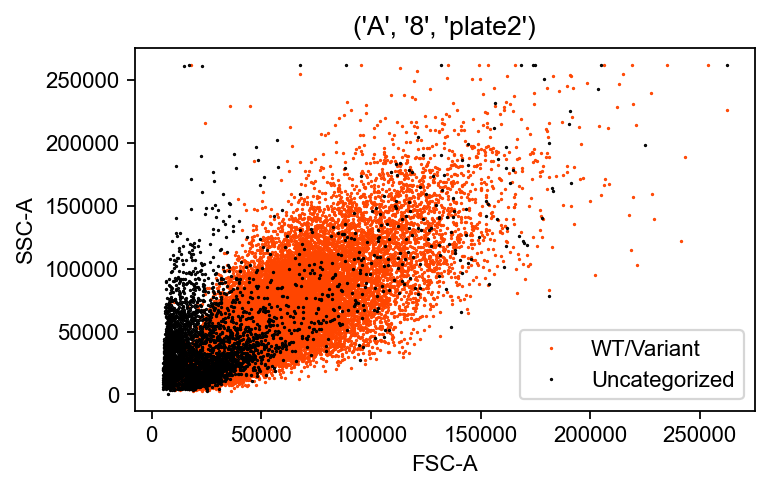

0.3811489810260014
('E', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


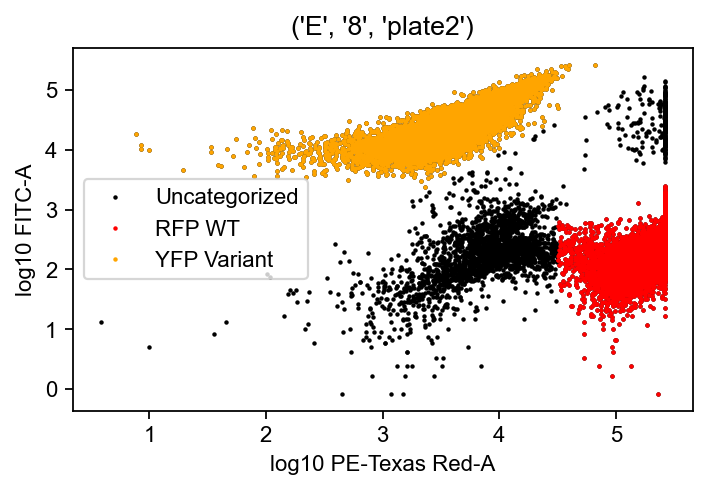

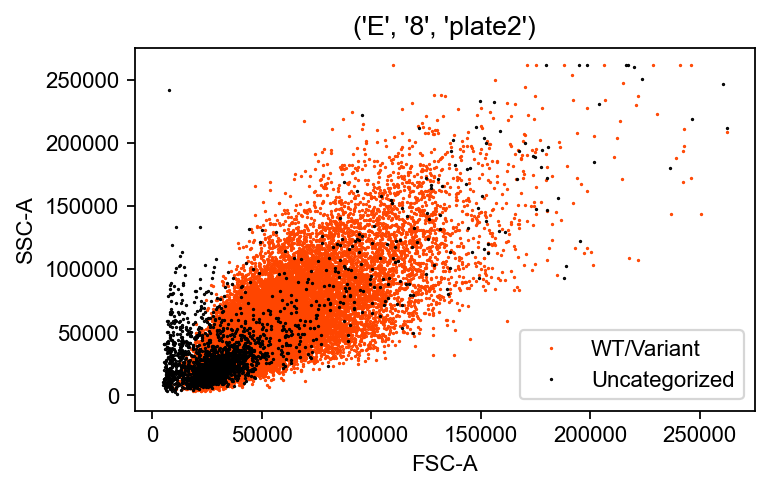

0.37417351598173515
('A', '9', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


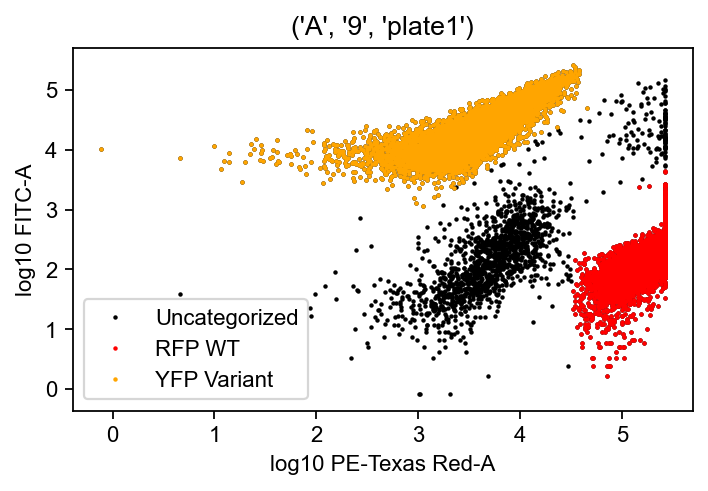

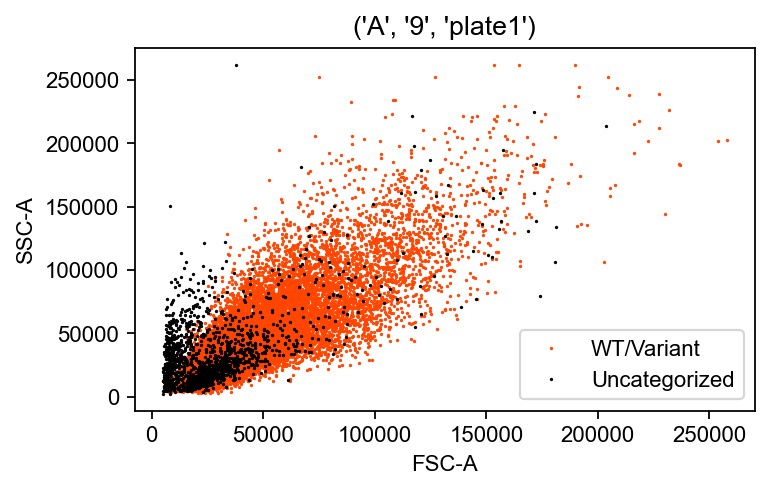

0.48539944903581267
('A', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


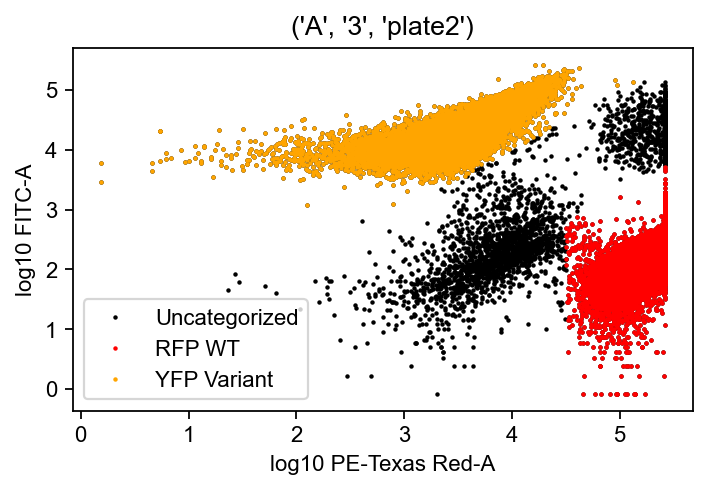

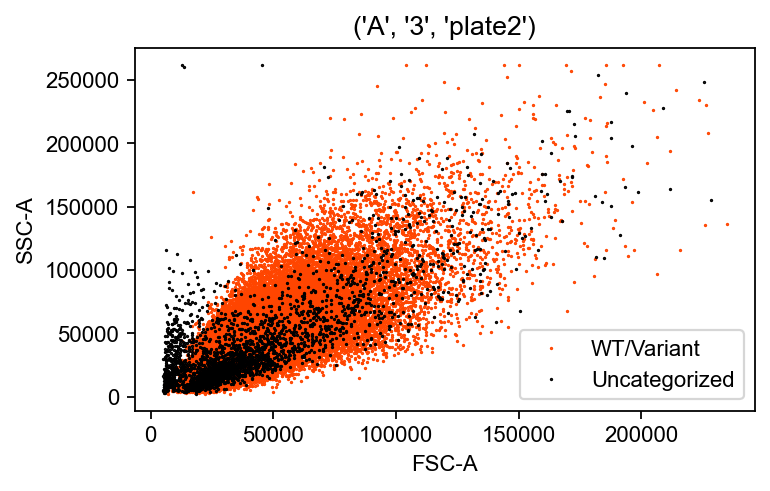

0.4338411669367909
('E', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


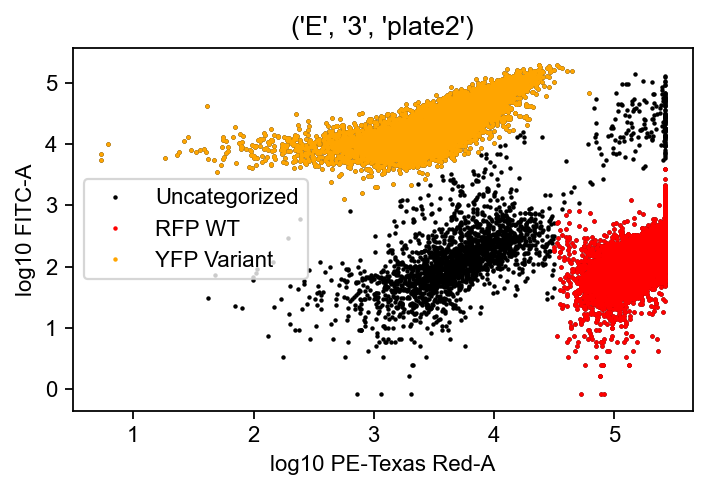

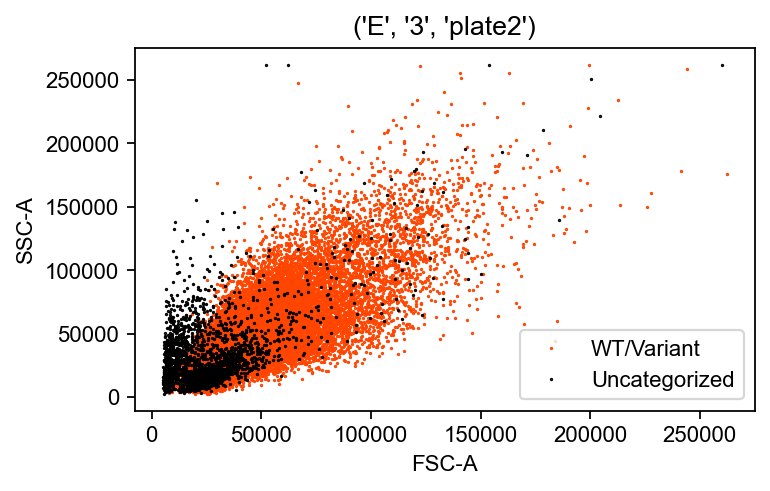

0.4115773286467487
('A', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


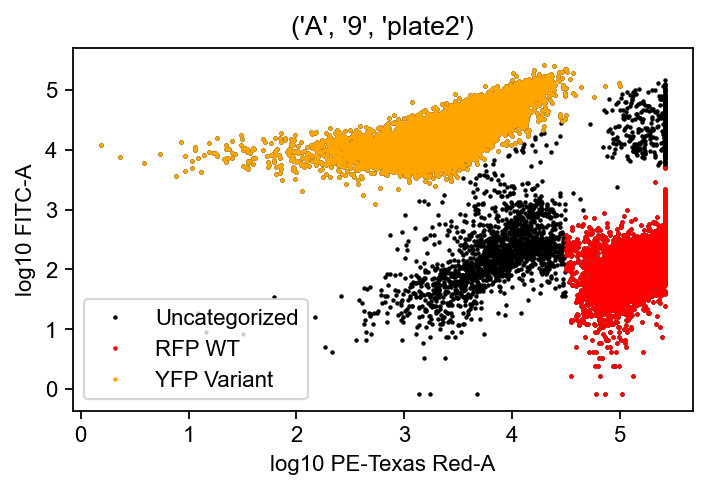

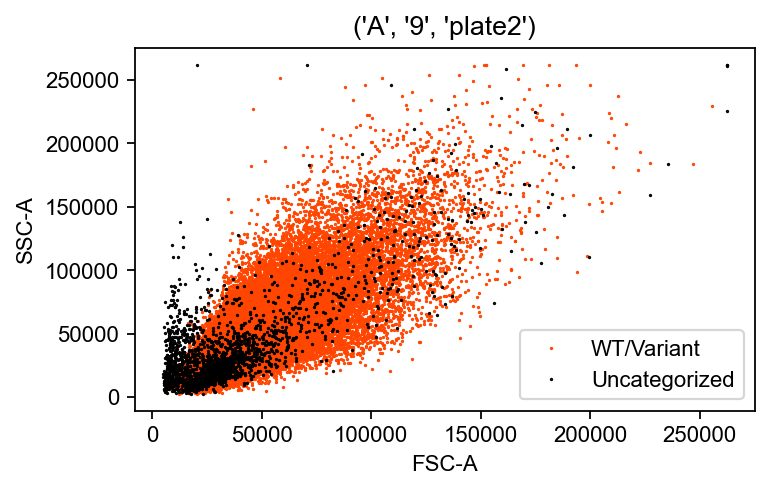

0.39150484410035113
('E', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


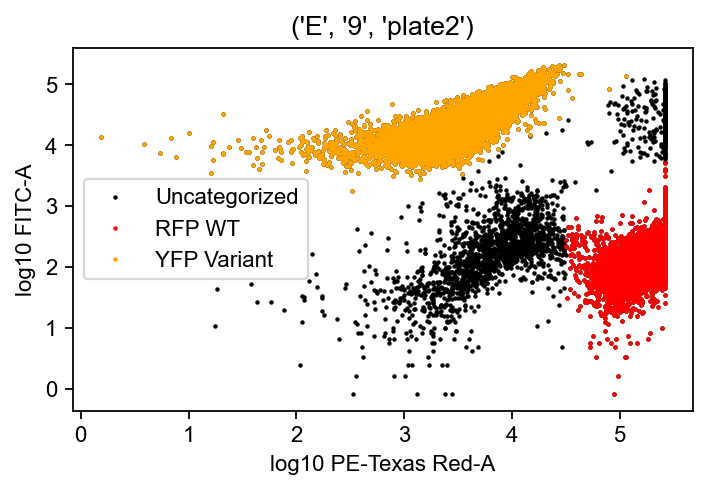

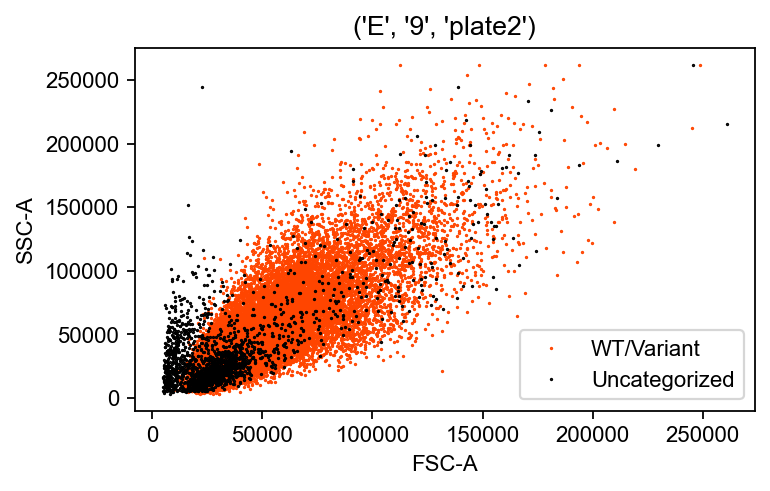

0.3738933275750378
('A', '10', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


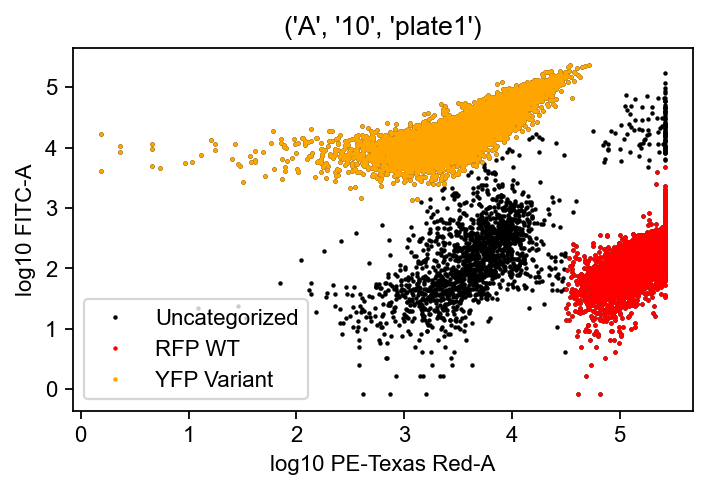

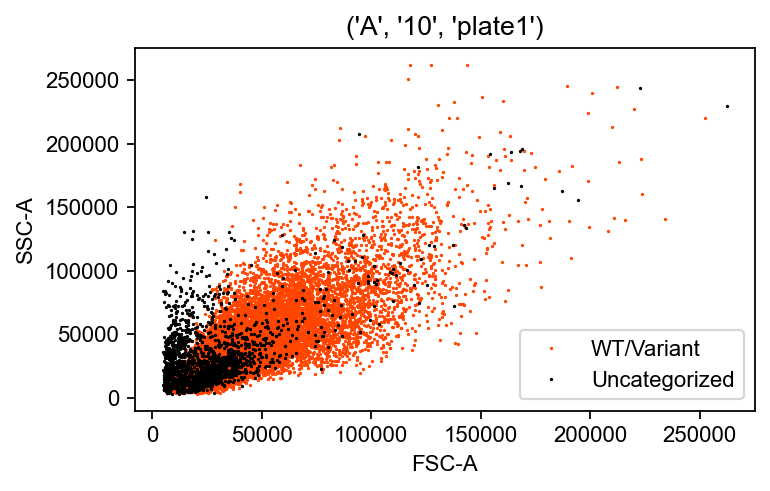

0.5150787445548978
('A', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


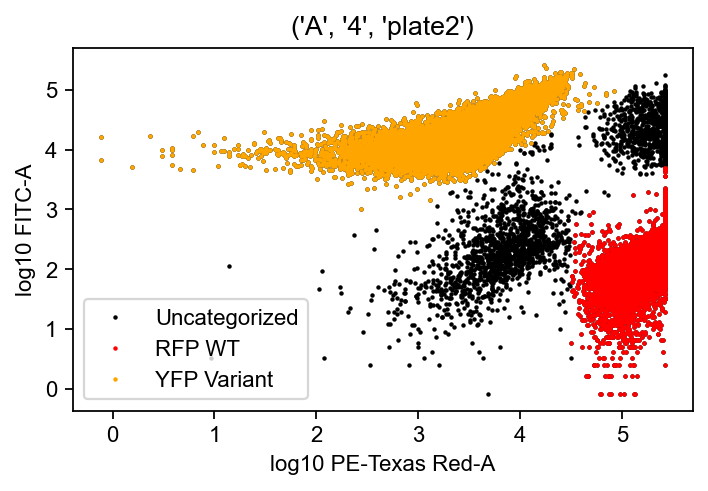

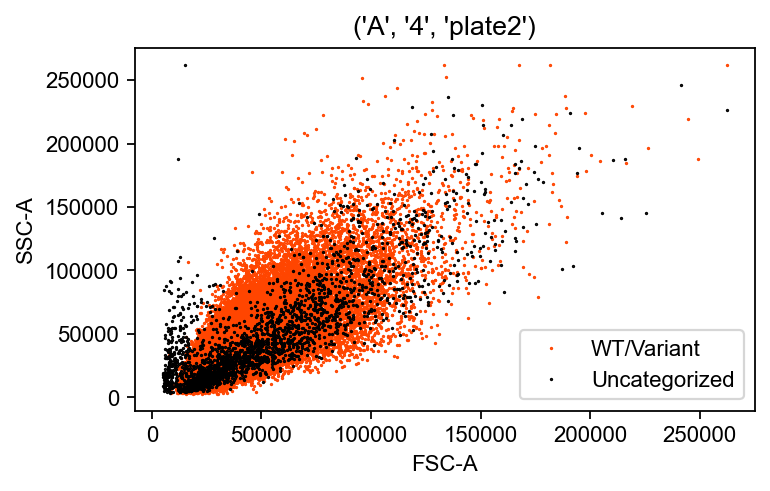

0.5461029810298103
('E', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


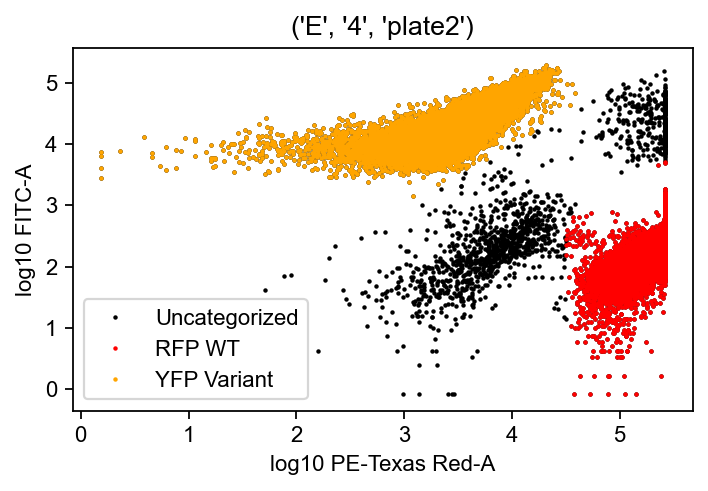

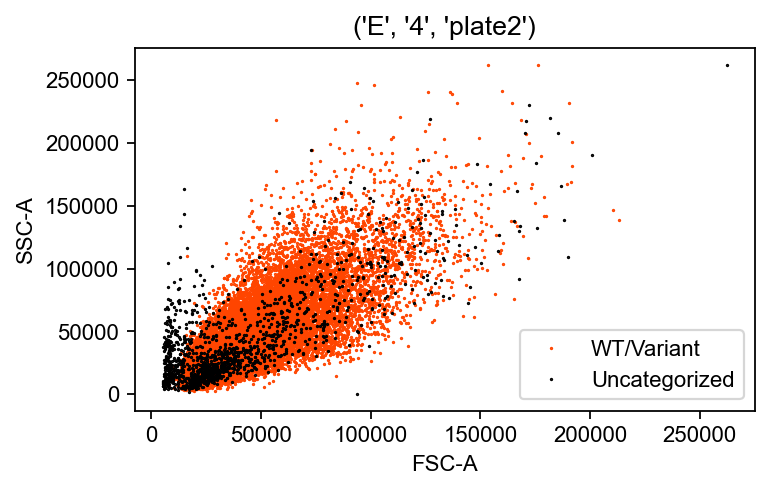

0.583943692164779
('A', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


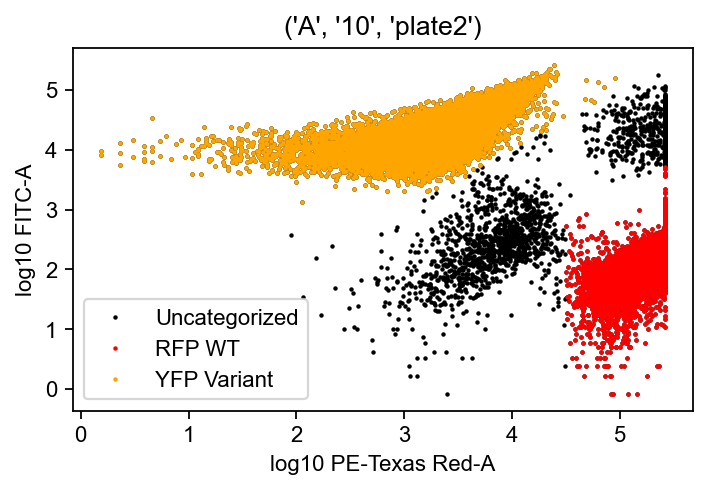

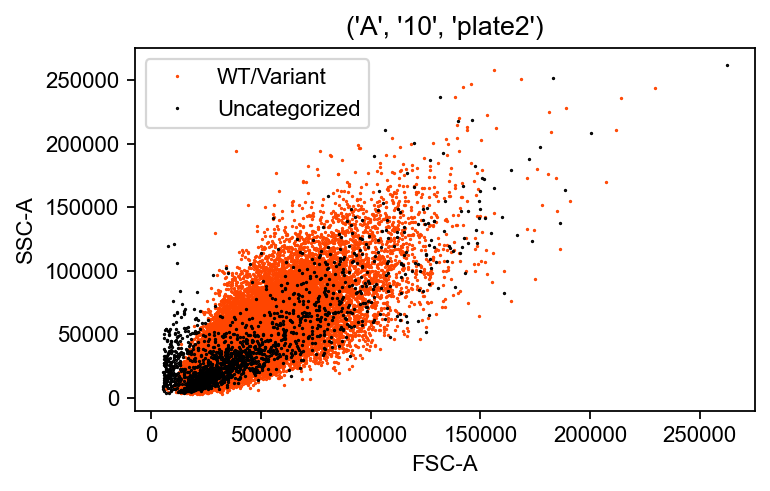

0.6217836194716787
('E', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


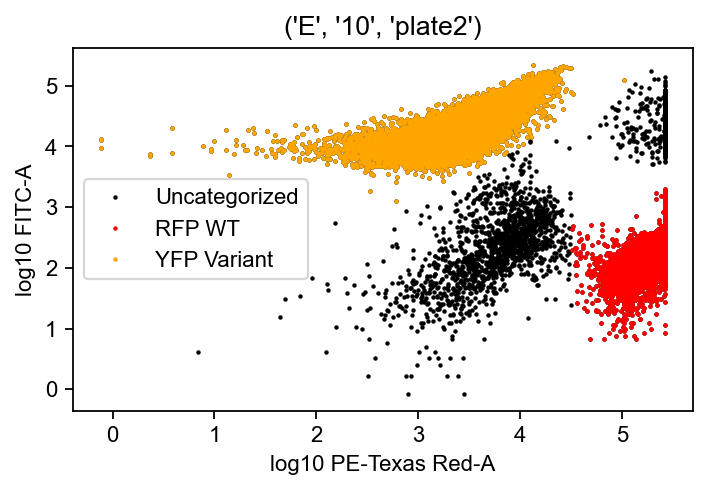

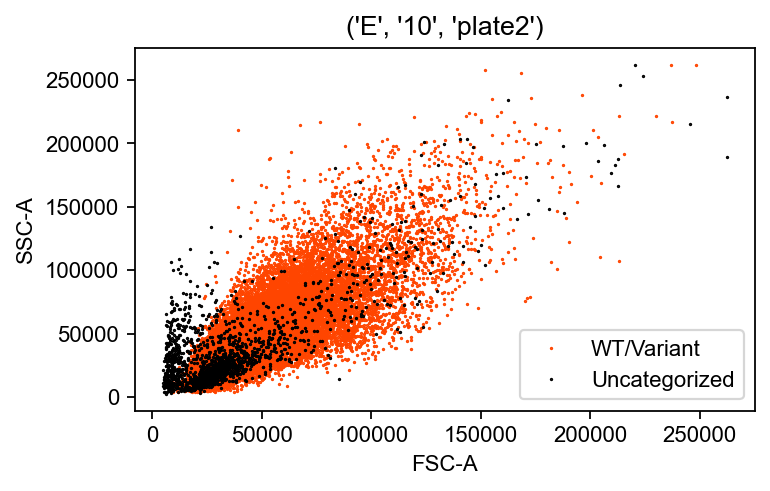

0.6694674853675177
('A', '11', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


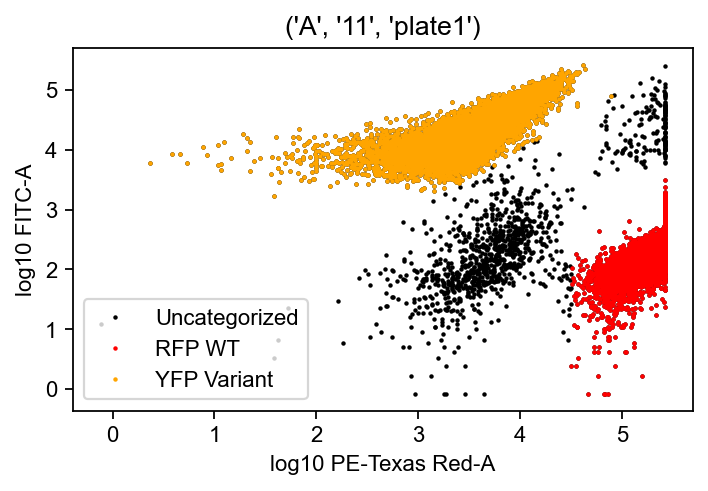

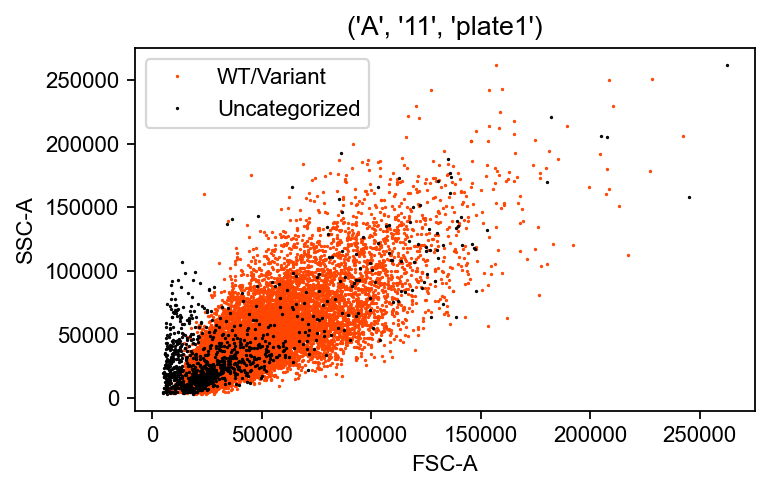

0.6221789251501867
('A', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


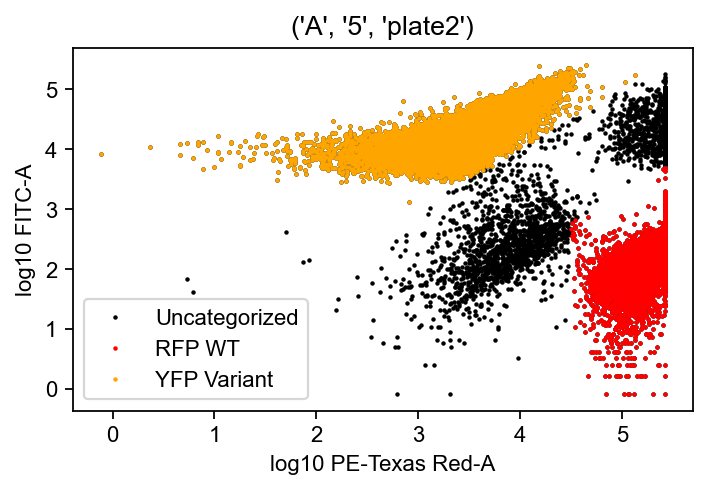

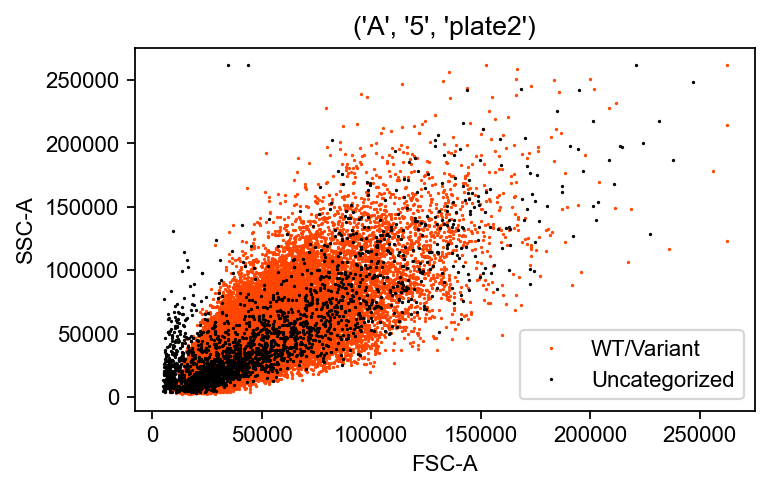

0.6704188368989712
('E', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


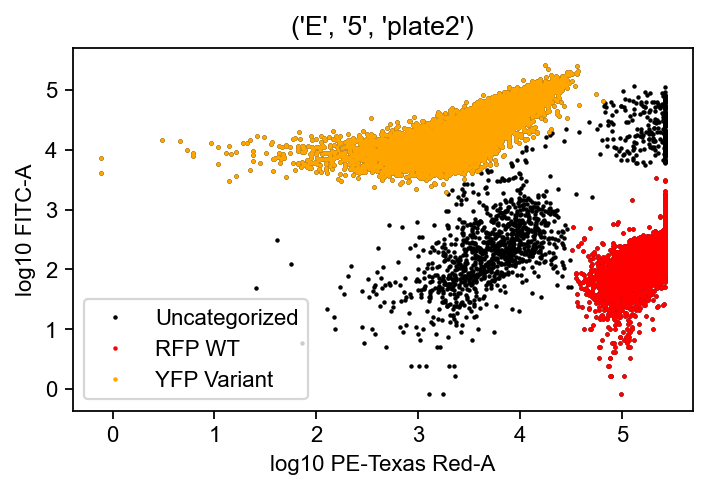

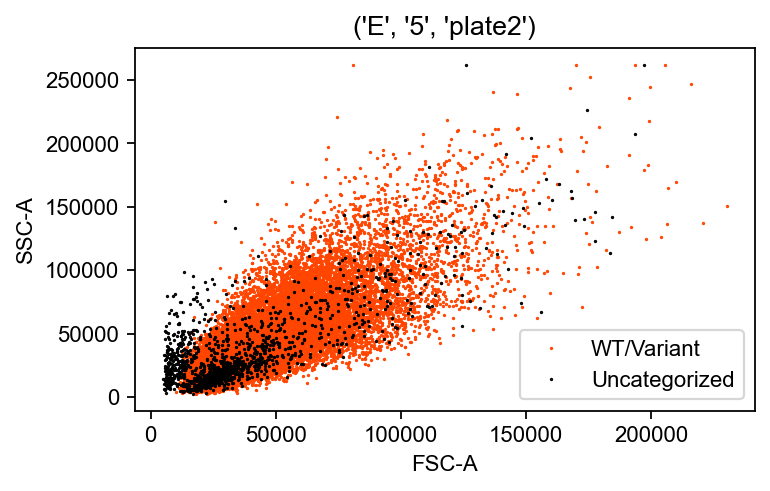

0.6986685602698385
('A', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


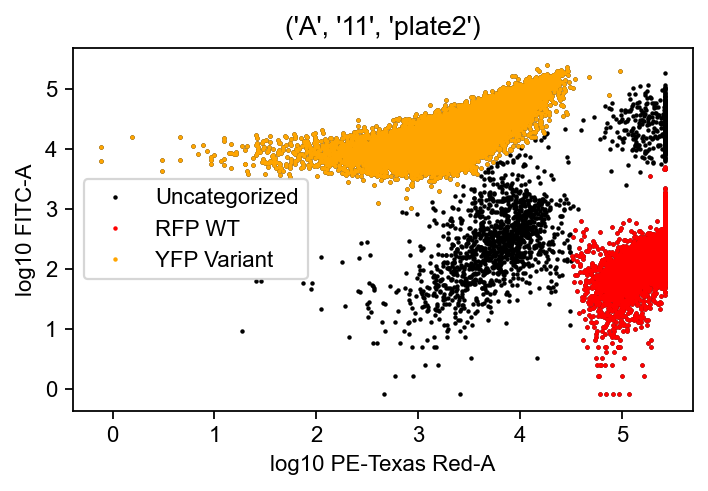

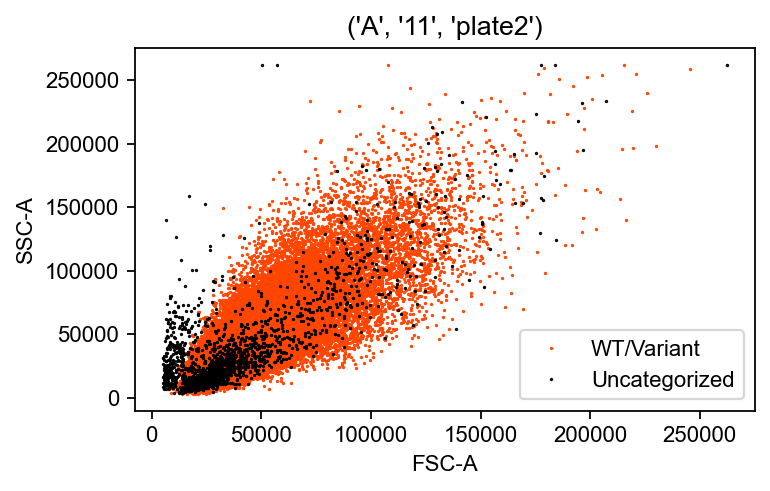

0.7386416367854883
('E', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


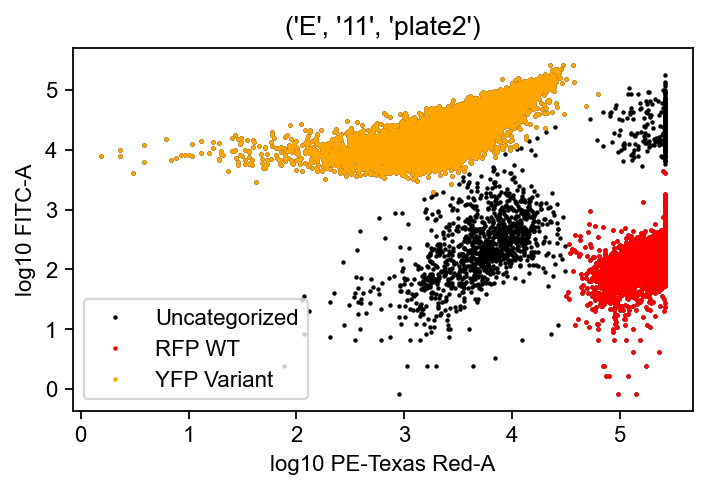

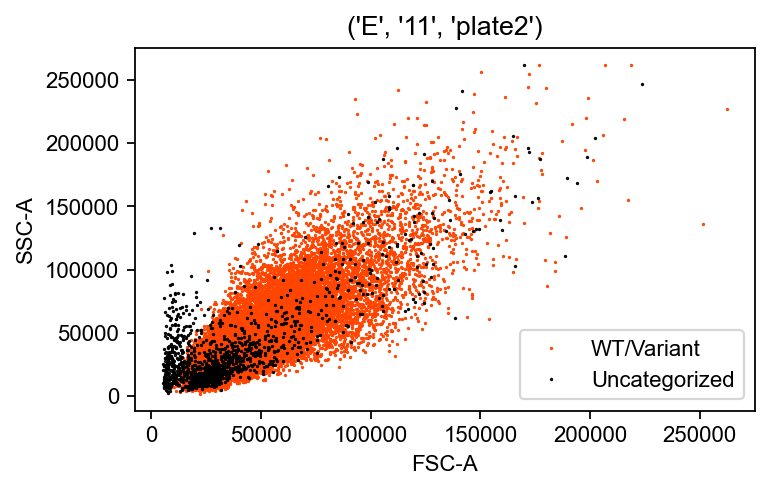

0.7689609975557051
('A', '12', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


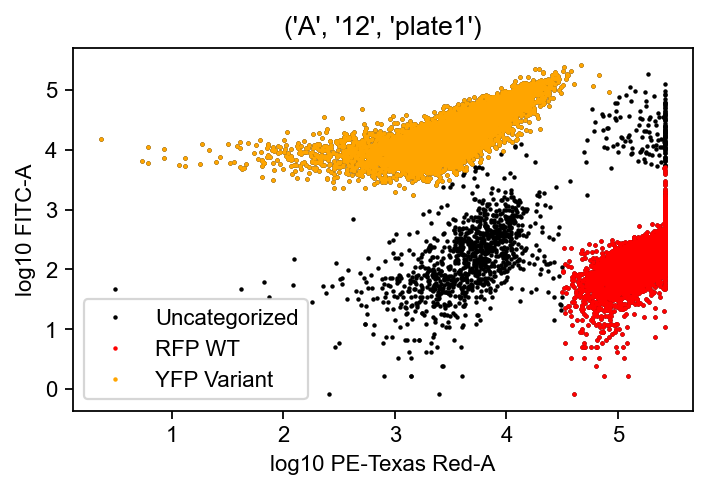

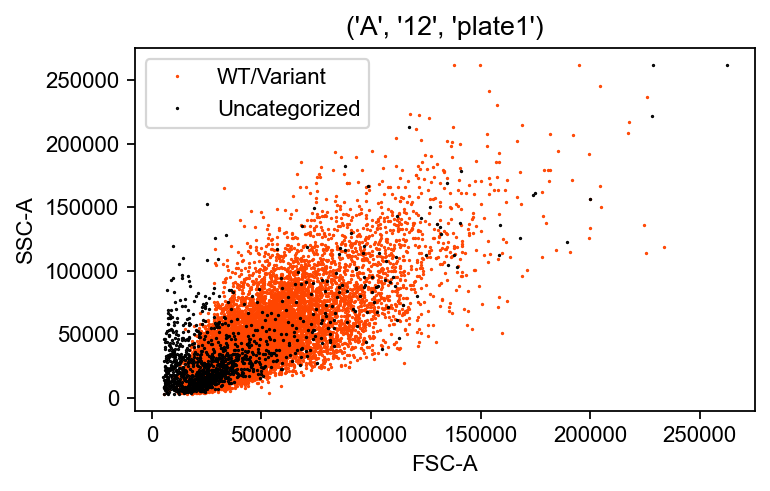

0.5302560756809656
('A', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


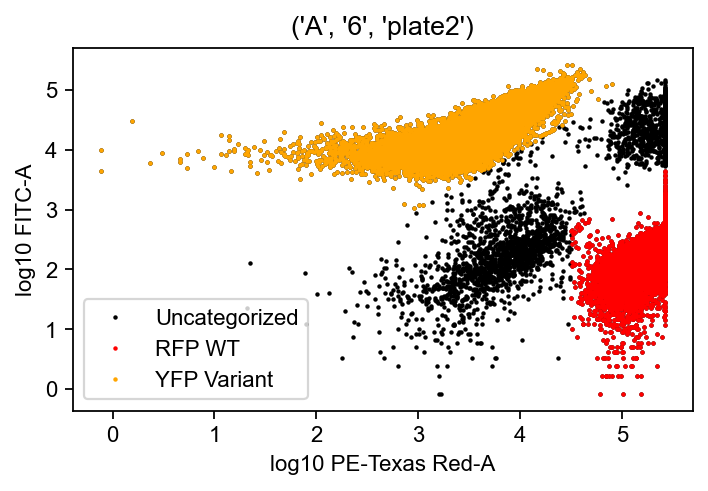

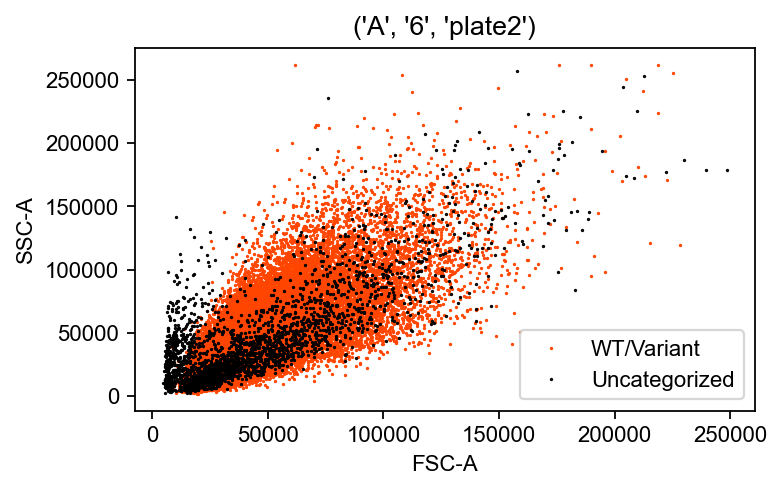

0.5643291237446662
('E', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


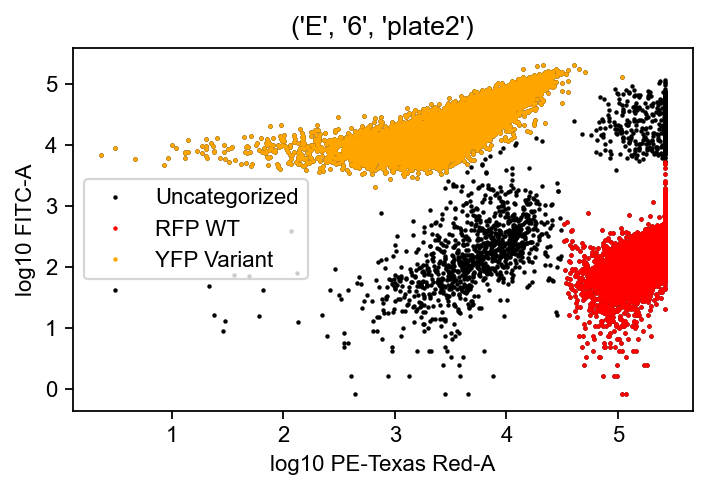

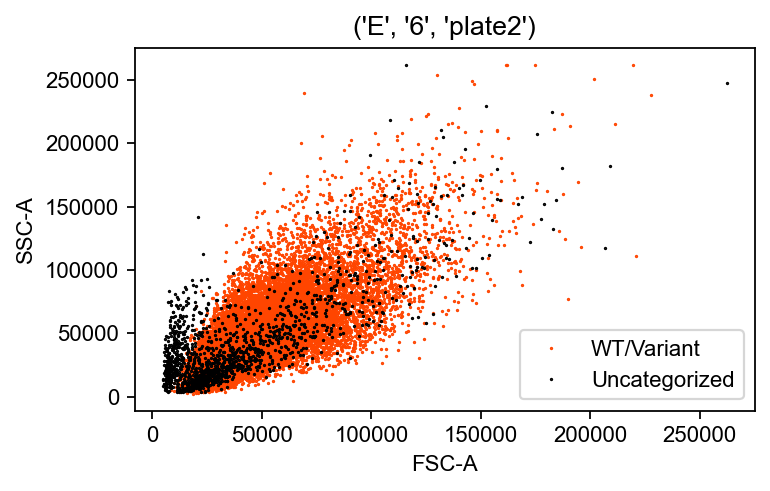

0.5990806399885971
('A', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


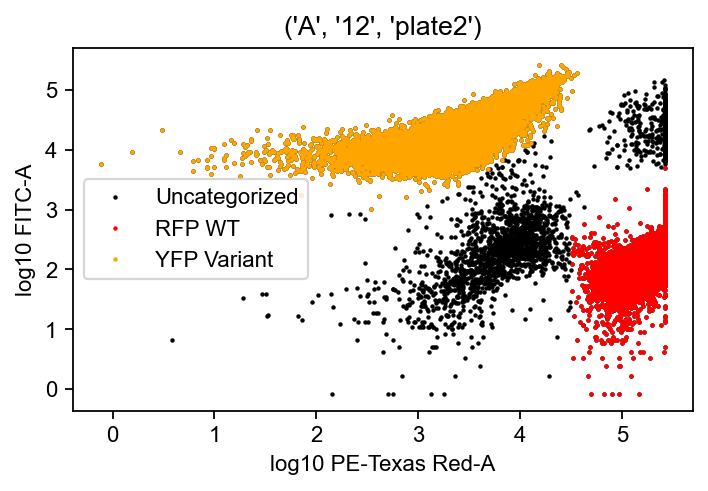

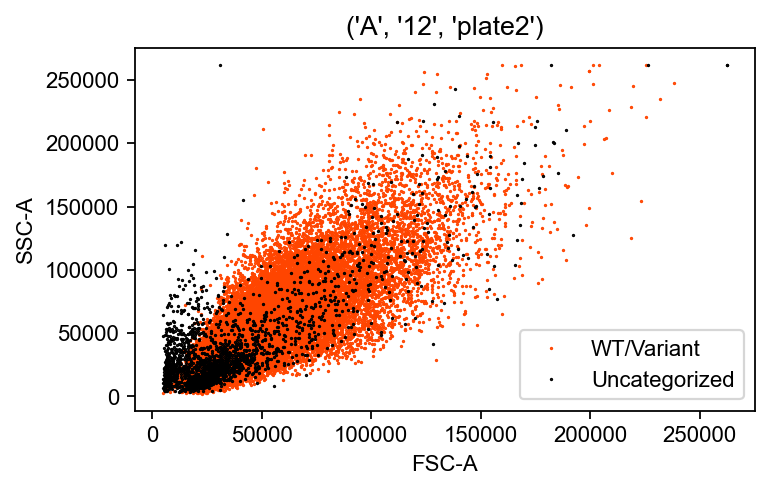

0.6385883946906027
('E', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


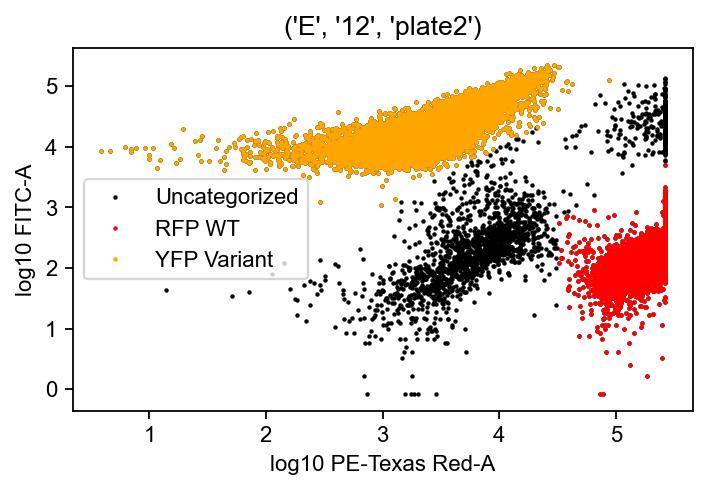

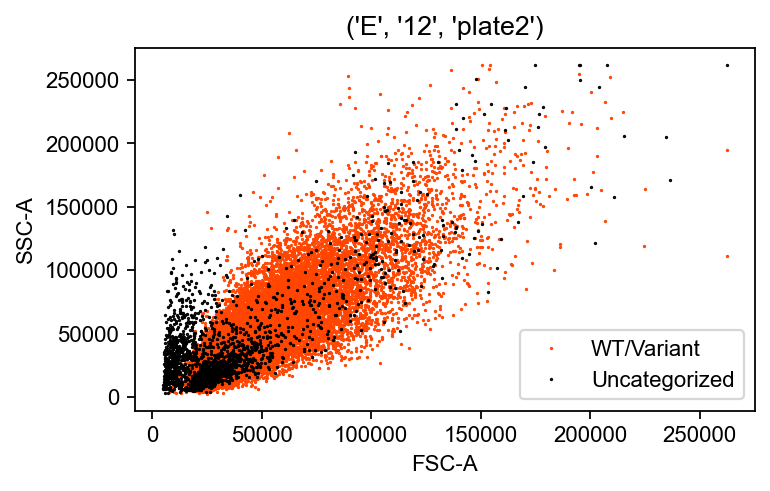

0.6750027026053115
('B', '7', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


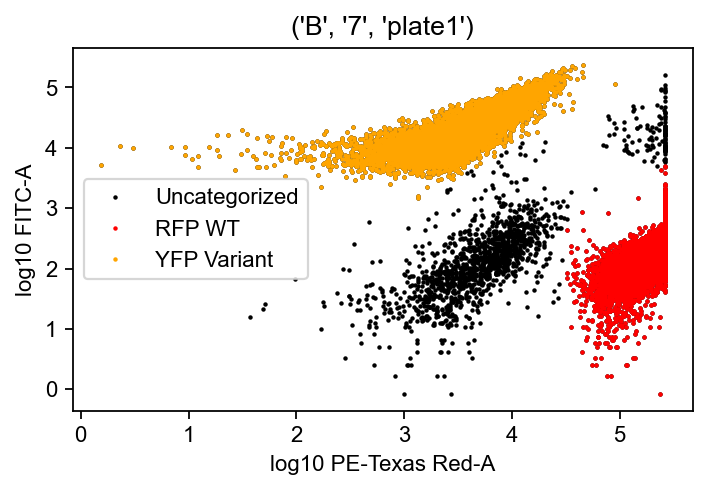

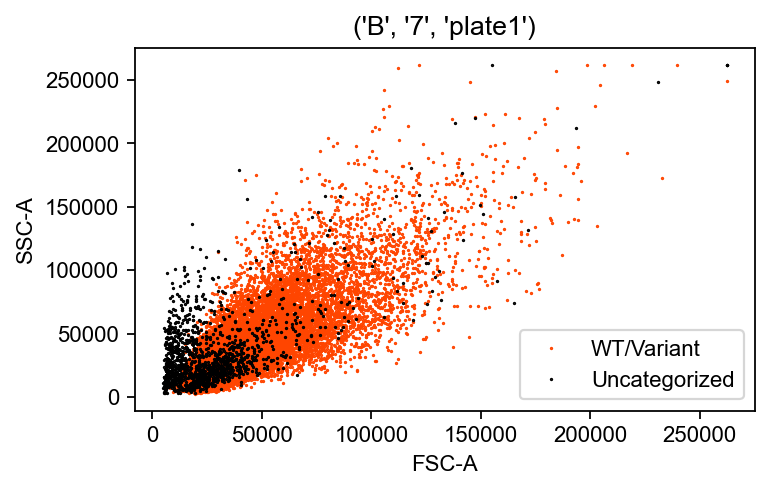

0.487457963504052
('B', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


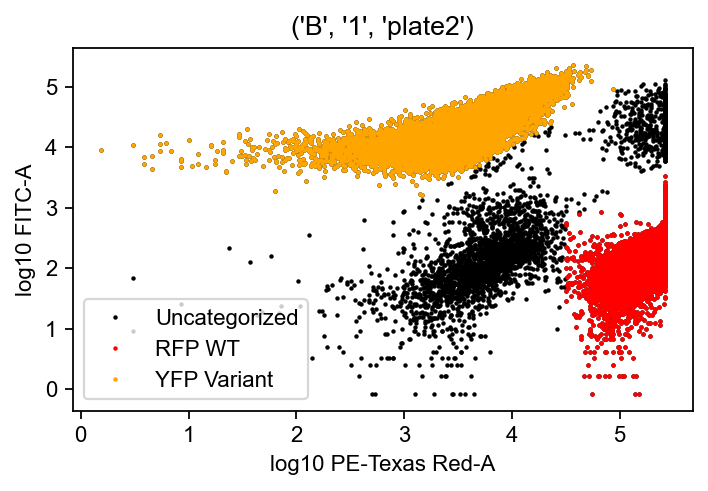

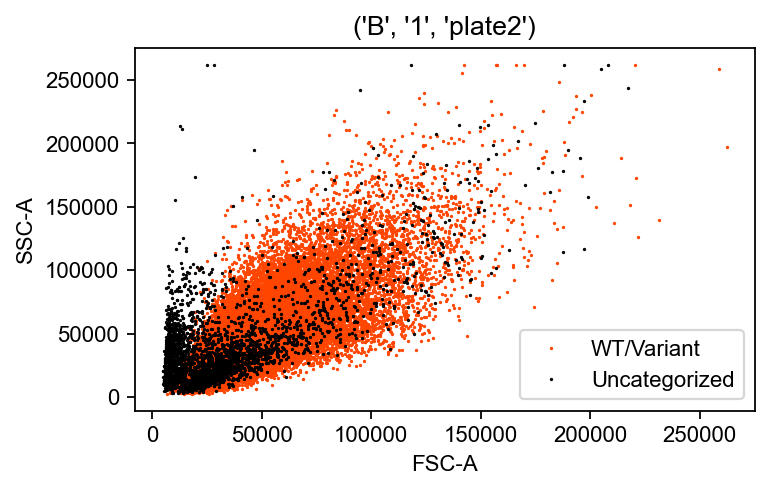

0.5191443388072602
('F', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


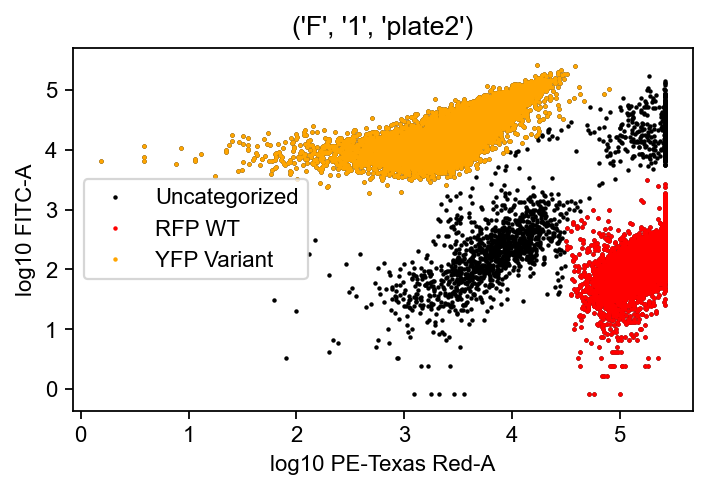

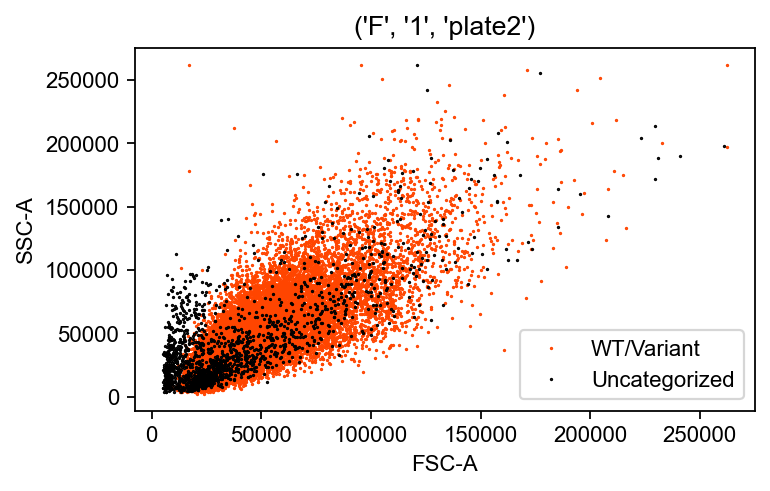

0.5551757636815026
('B', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


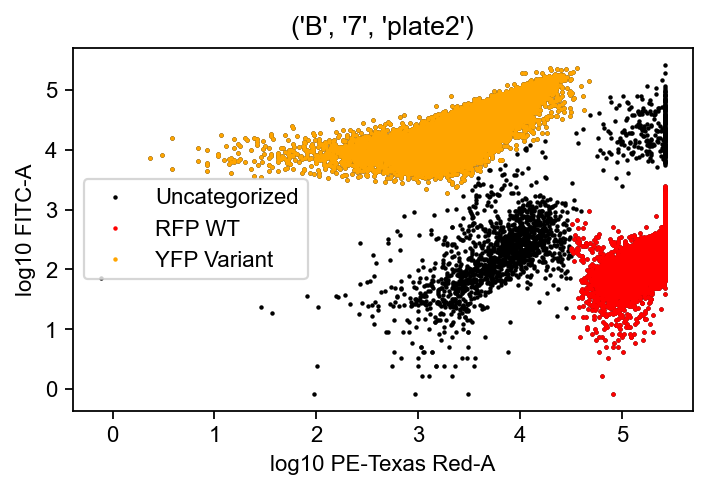

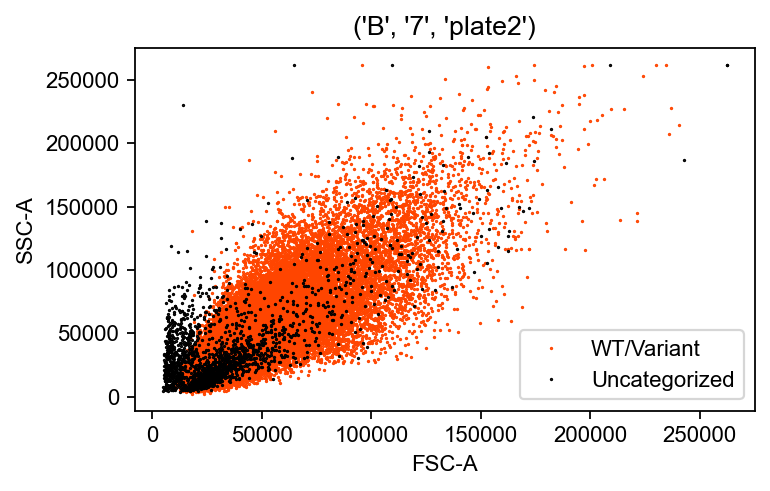

0.6017313281941109
('F', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


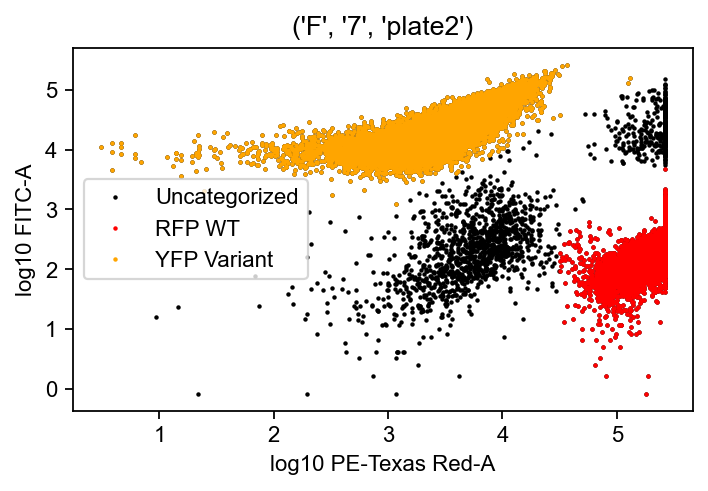

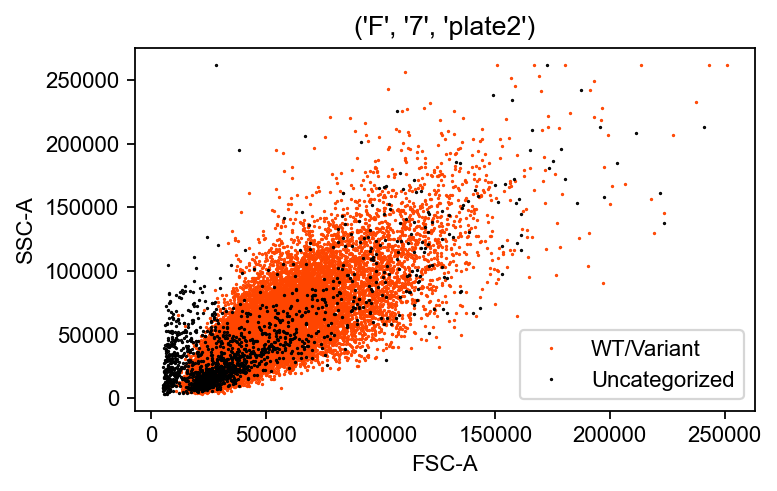

0.635588077815456
('B', '8', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


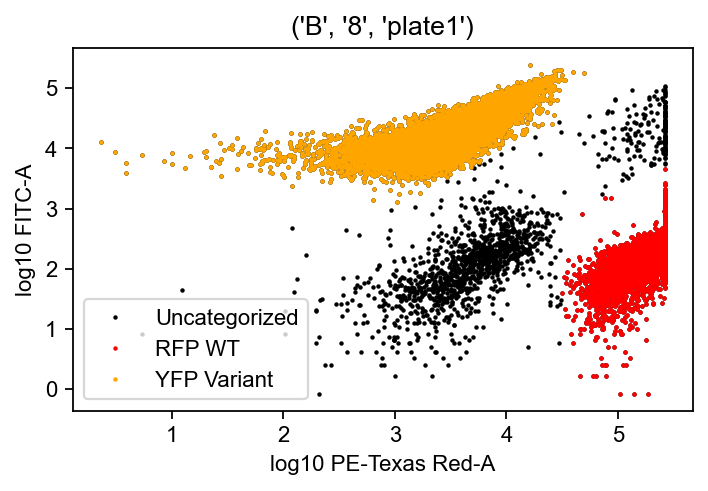

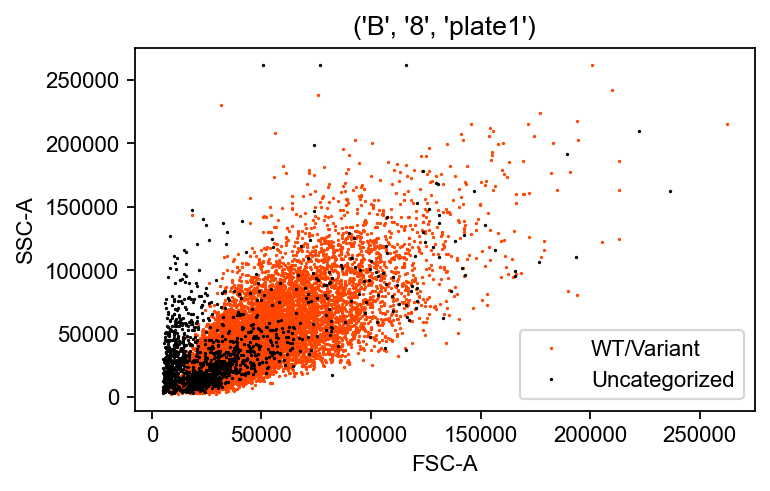

0.6403658603779823
('B', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


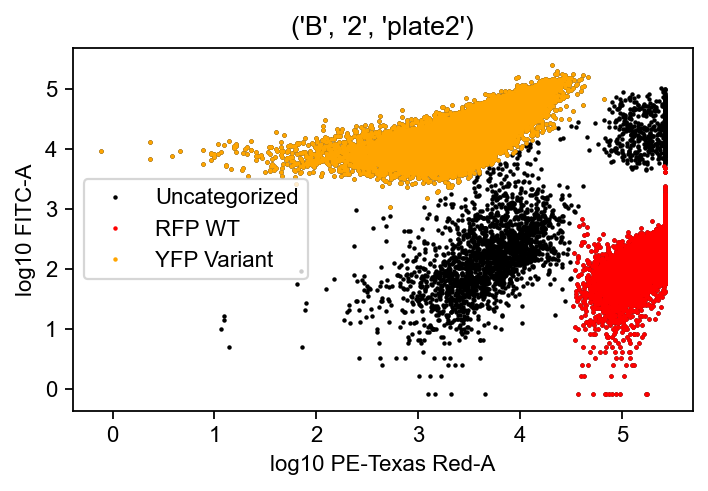

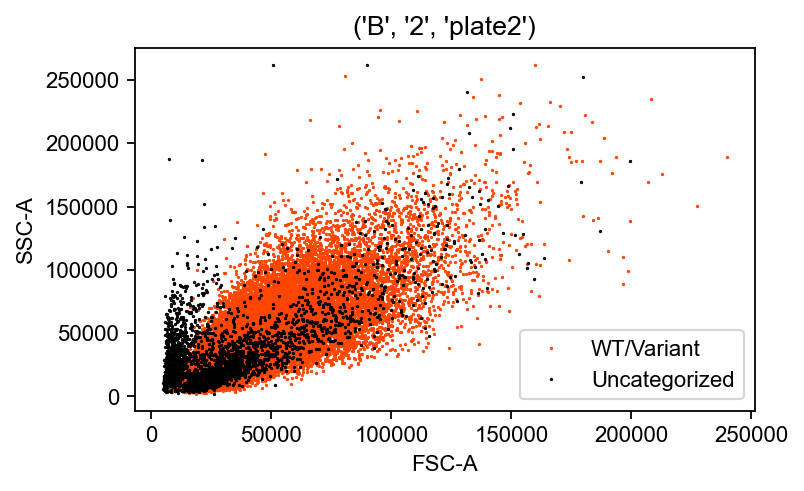

0.6659787992006256
('F', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


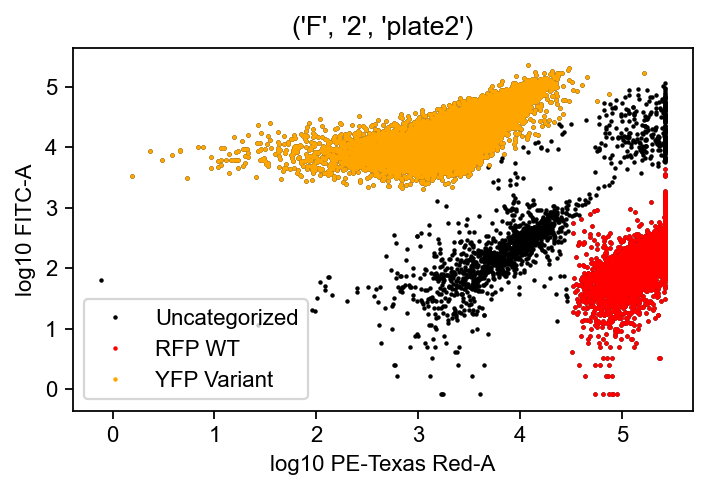

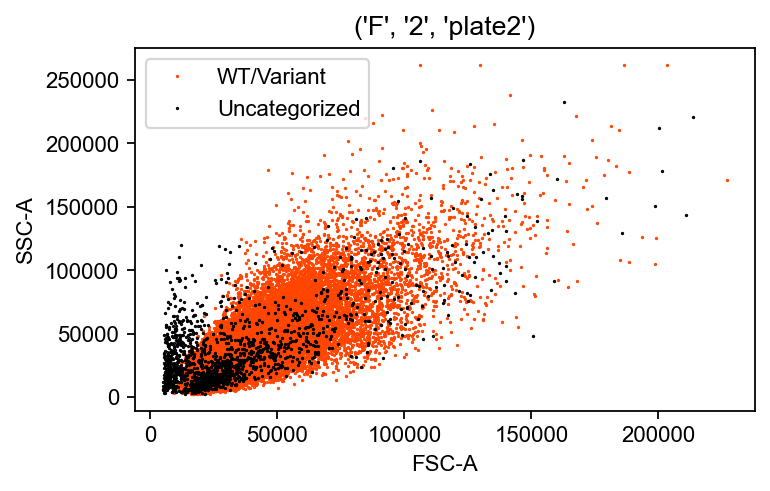

0.6872829861111112
('B', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


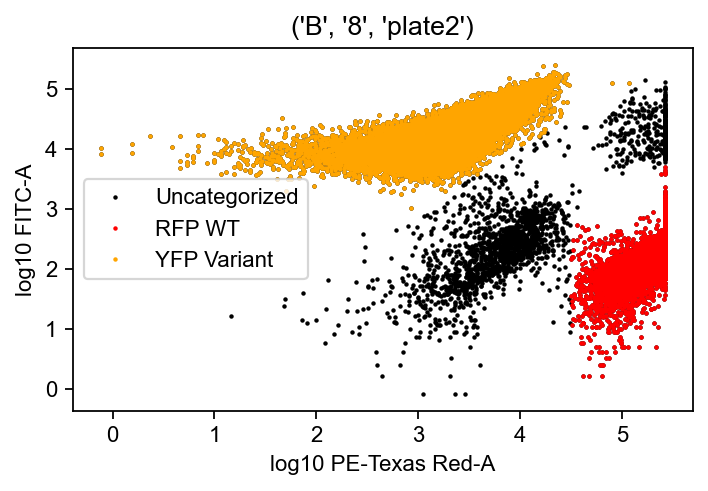

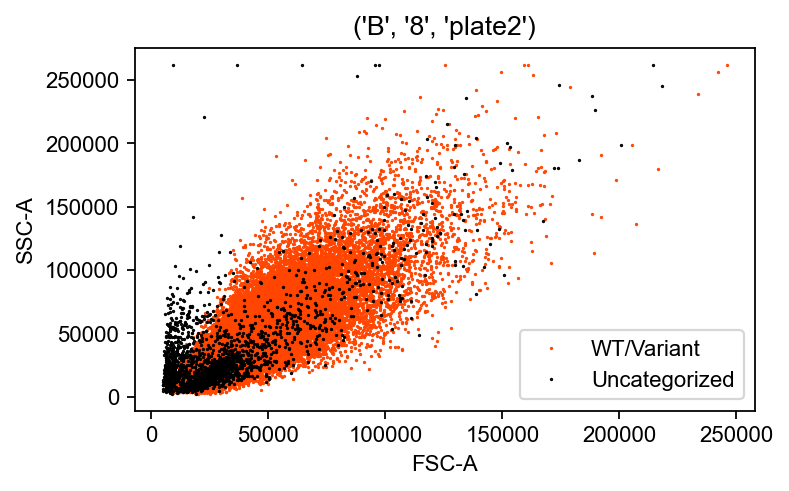

0.7193752005991227
('F', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


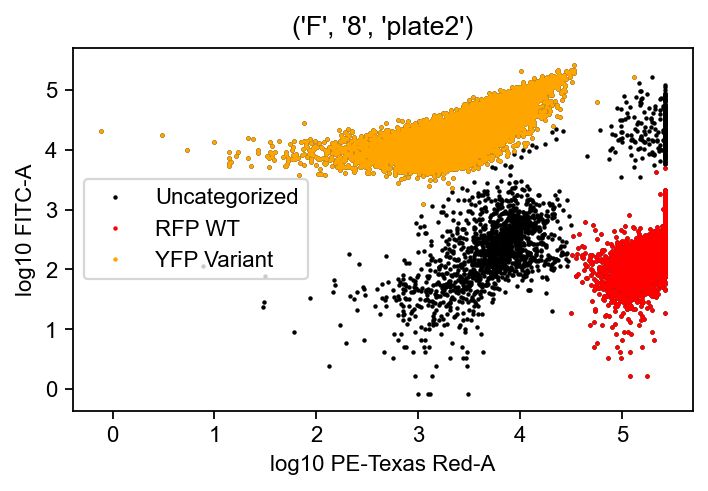

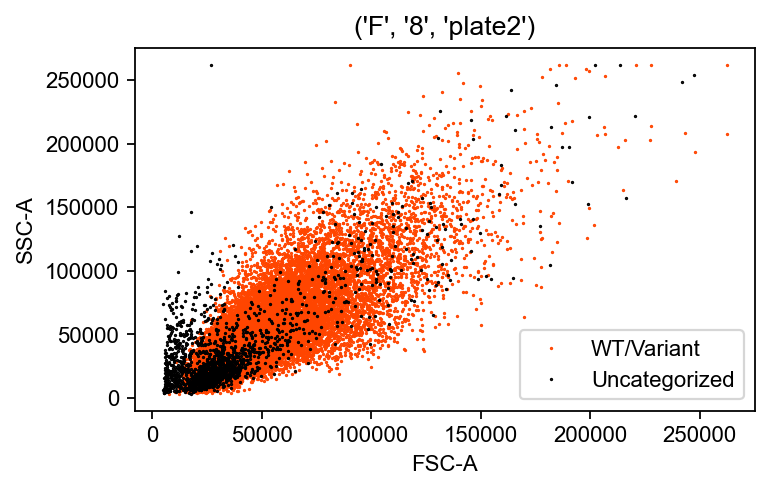

0.7491932592326999
('B', '9', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


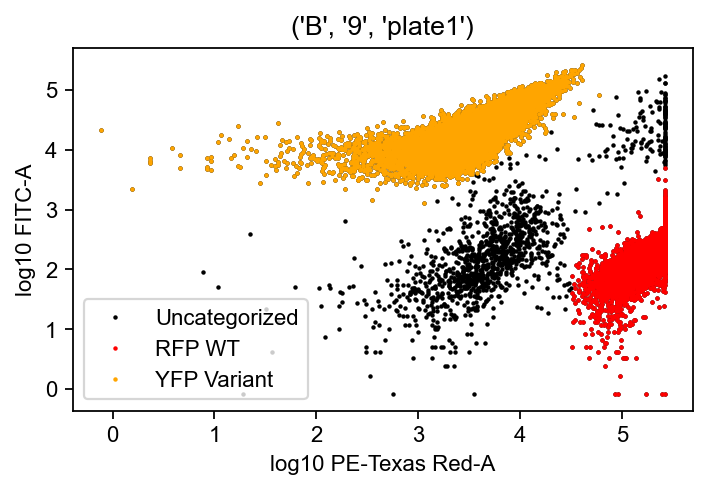

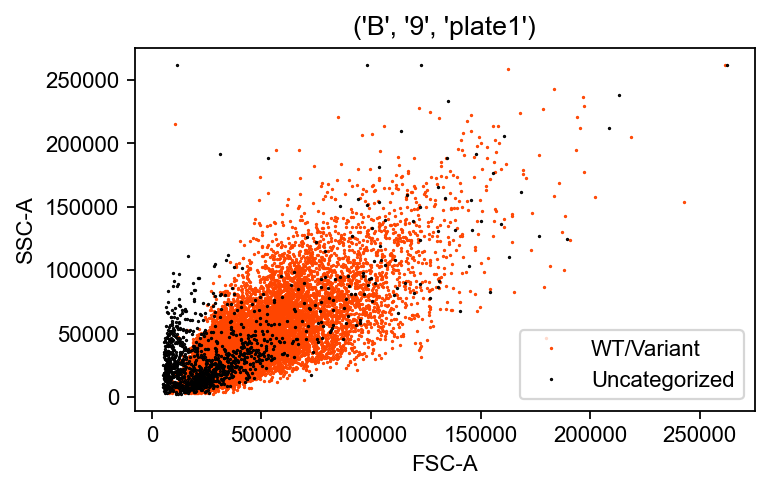

0.6357197759964862
('B', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


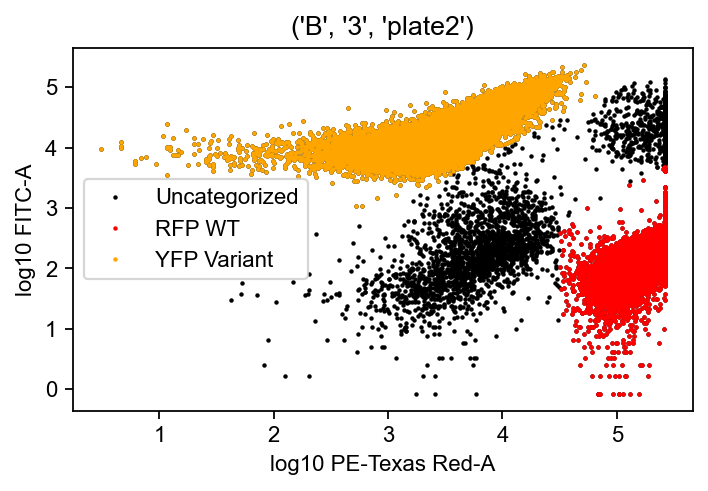

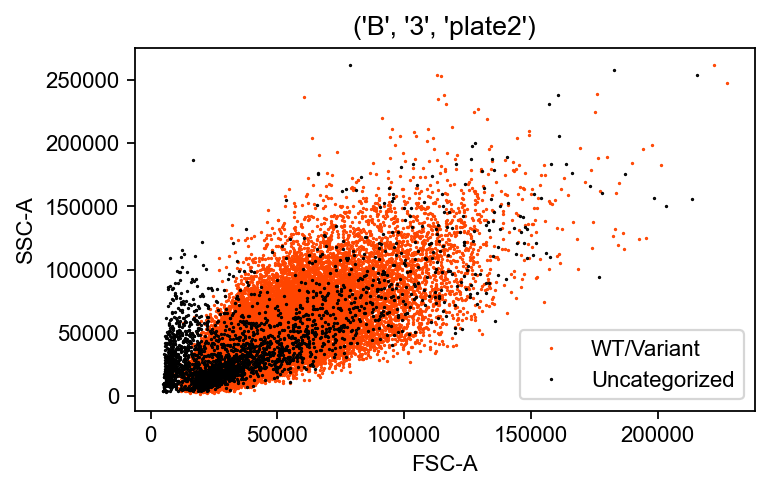

0.6737561059957636
('F', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


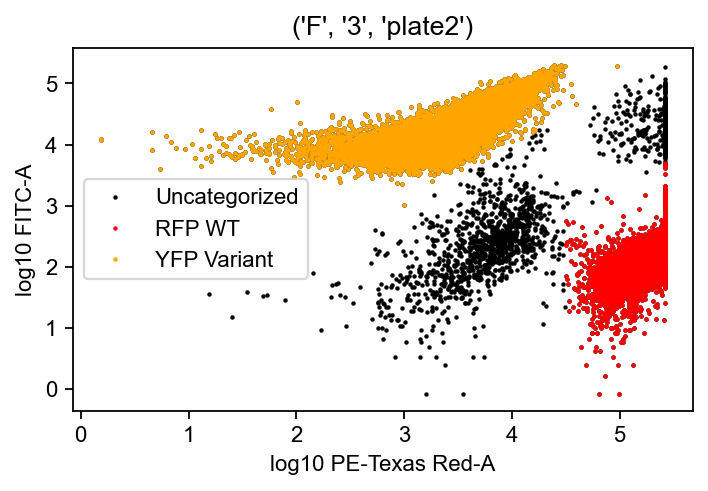

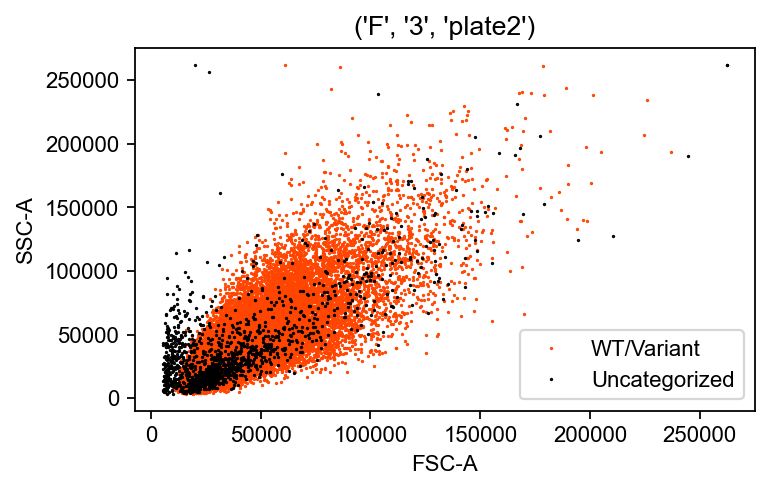

0.6963132979486444
('B', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


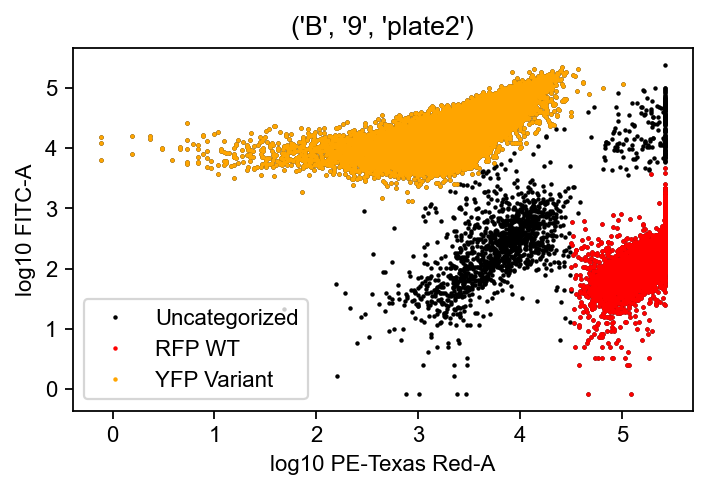

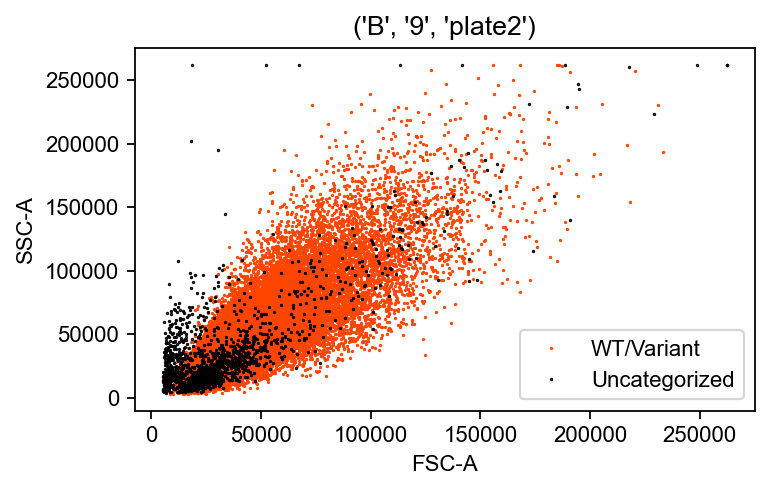

0.7295307125874287
('F', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


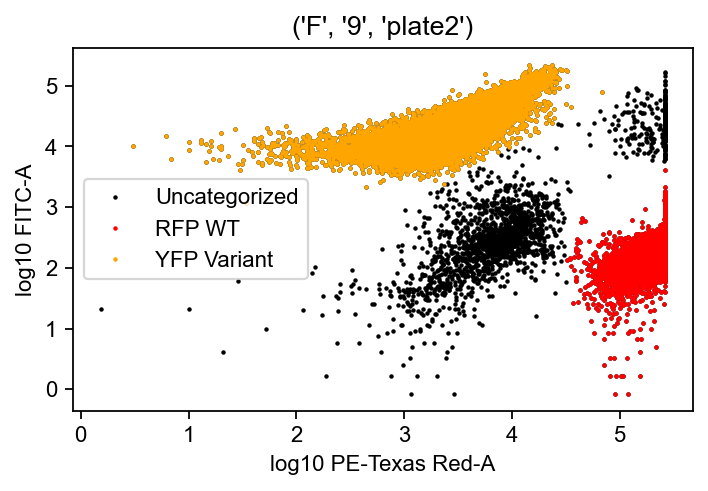

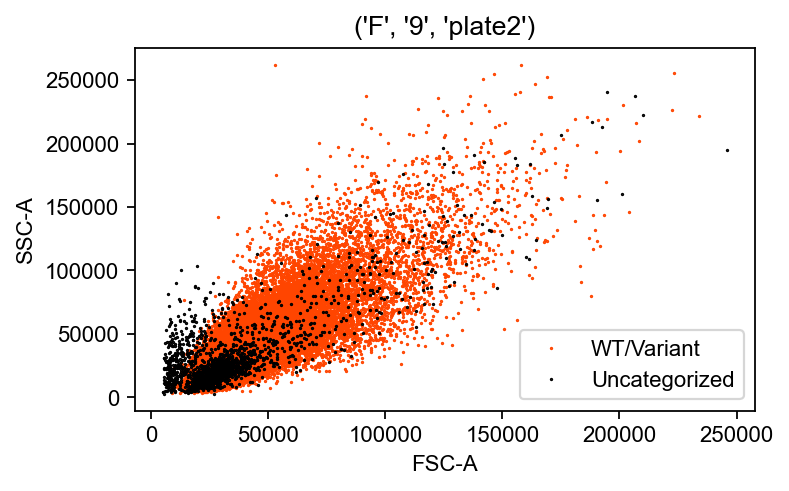

0.7555923777961889
('B', '10', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


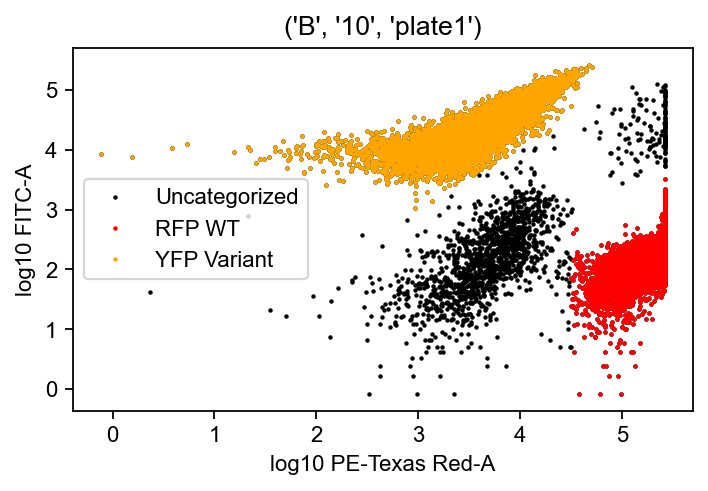

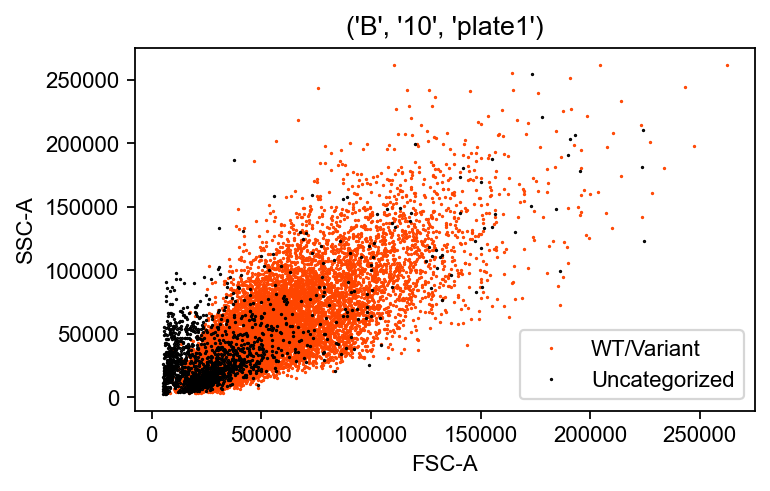

0.49905963049009844
('B', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


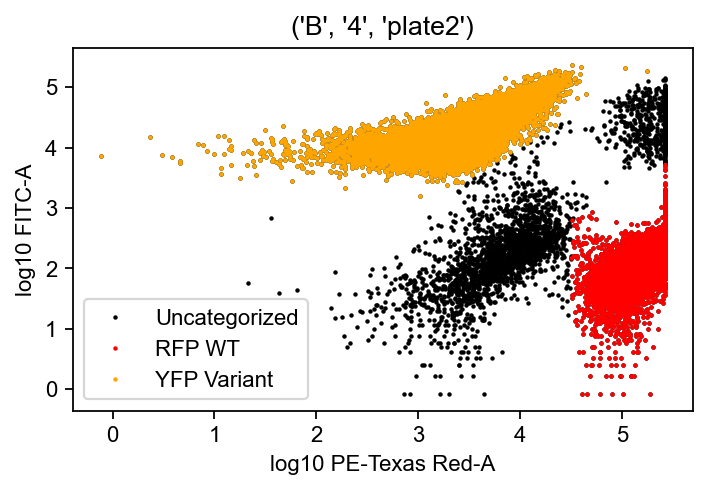

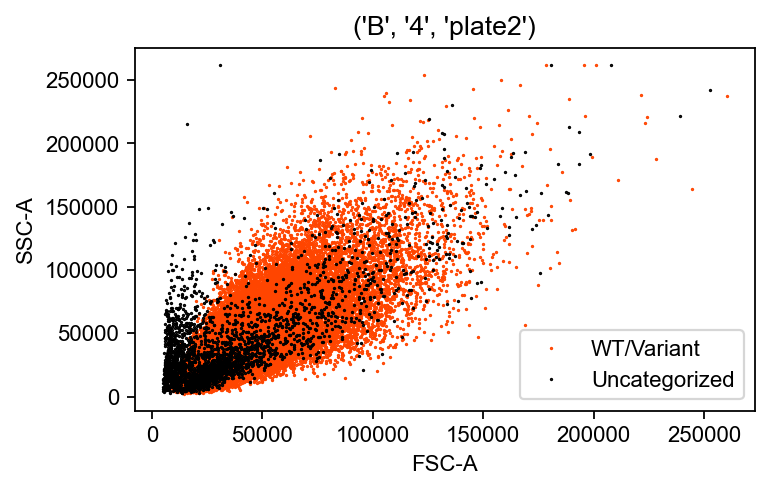

0.5136593080439351
('F', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


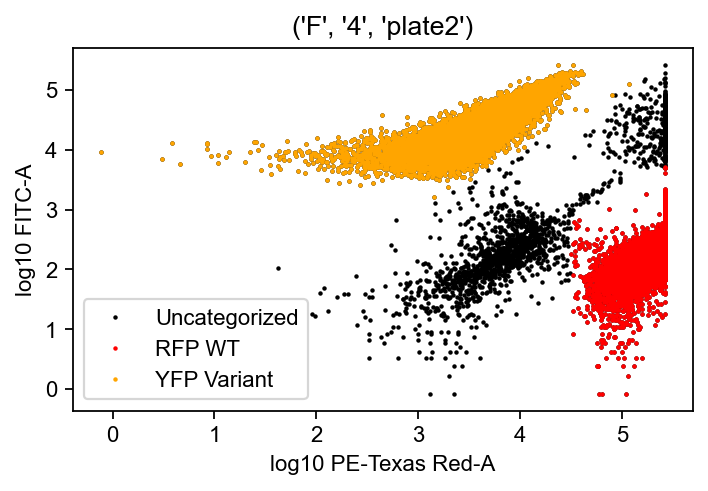

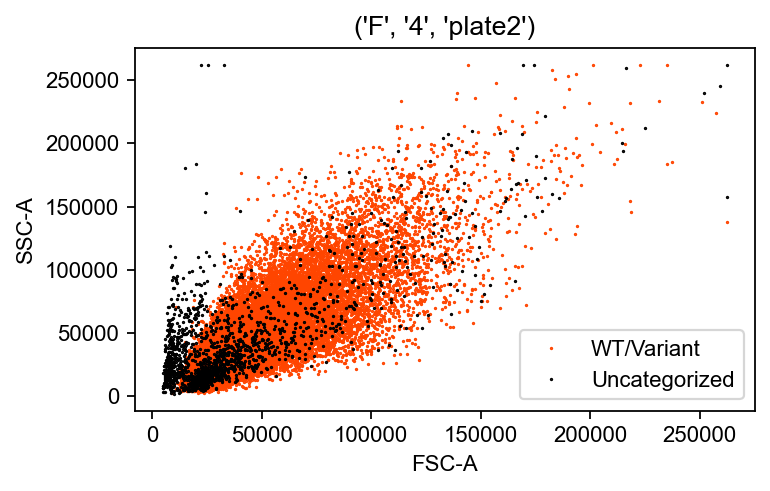

0.5249570938215103
('B', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


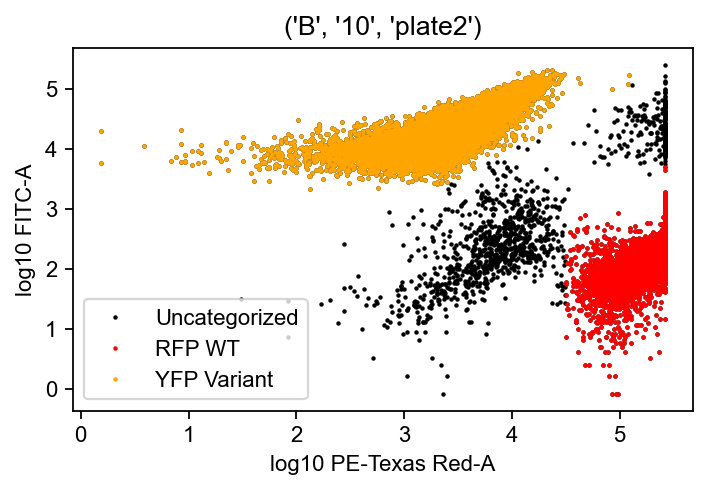

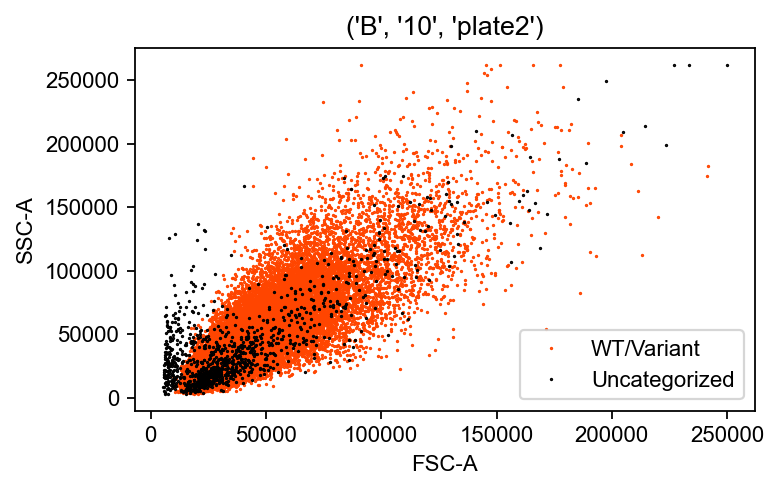

0.5358679551386047
('F', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


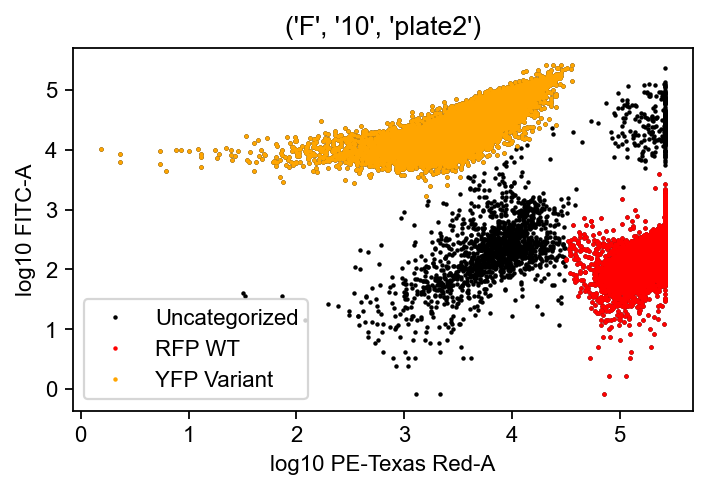

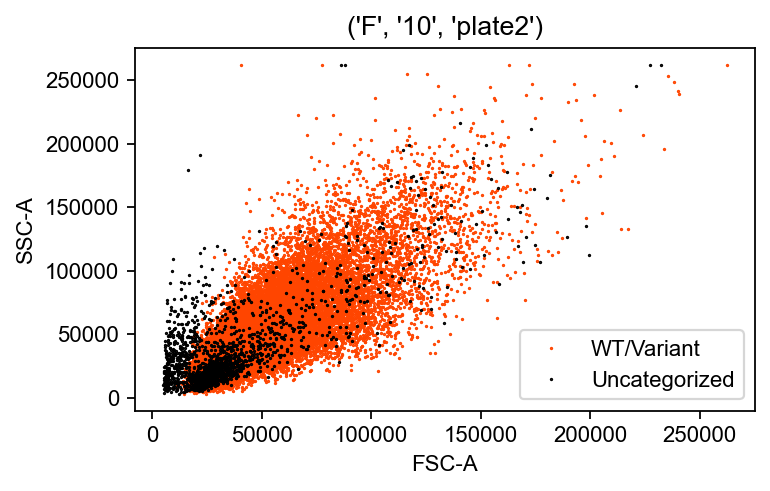

0.5479835095895321
('B', '11', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


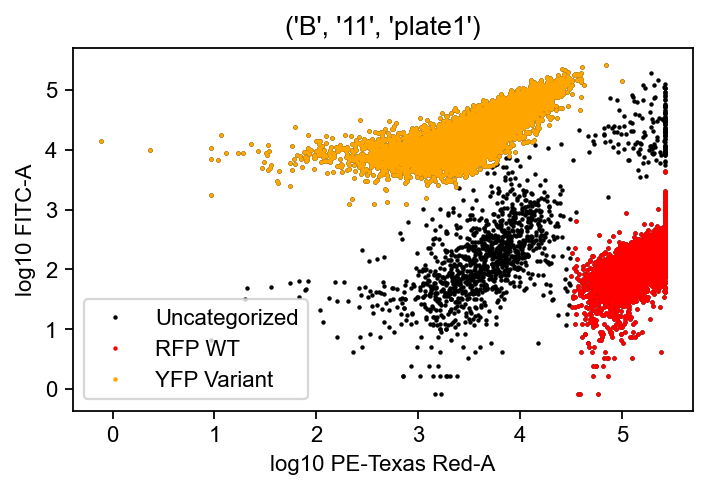

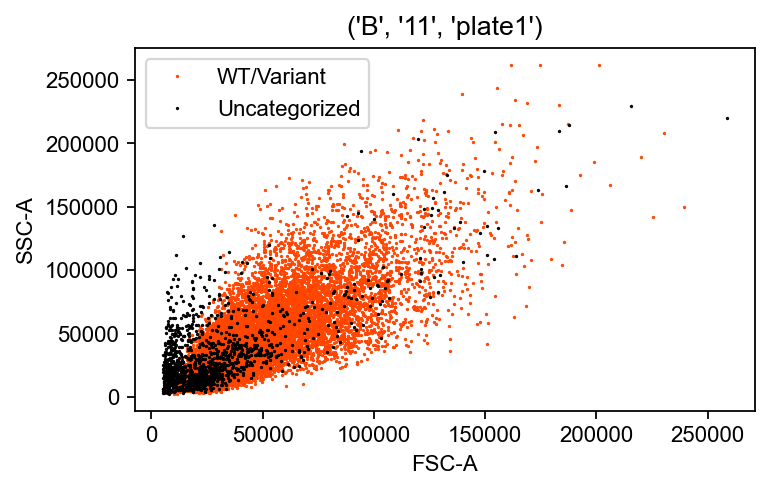

0.5230146133216572
('B', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


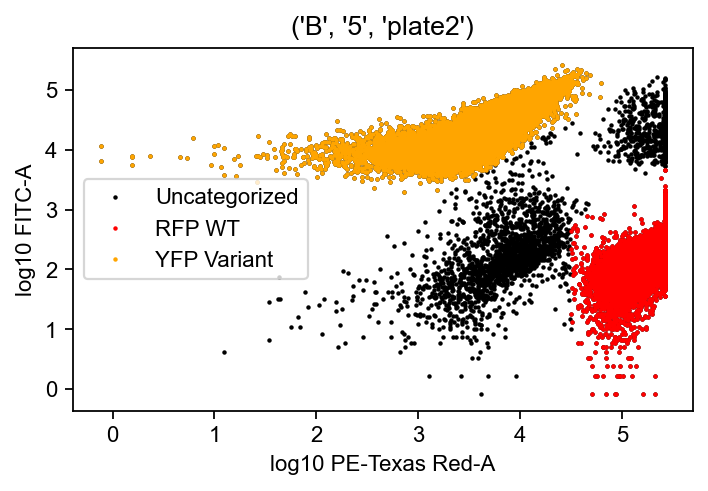

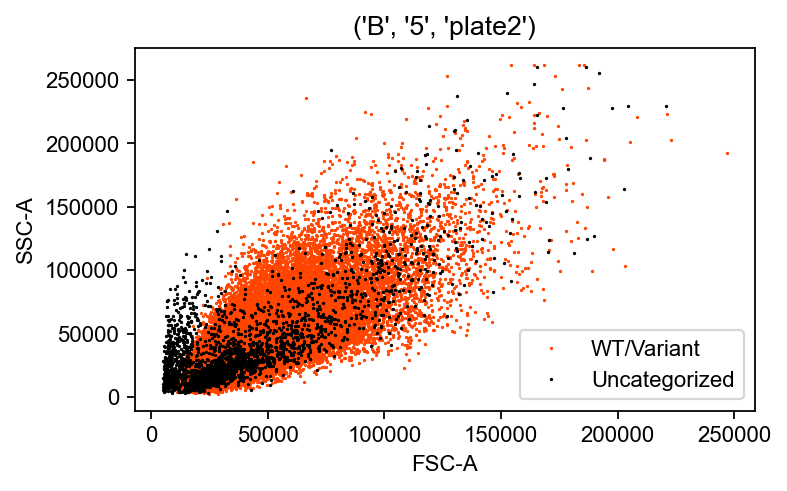

0.5308271321652978
('F', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


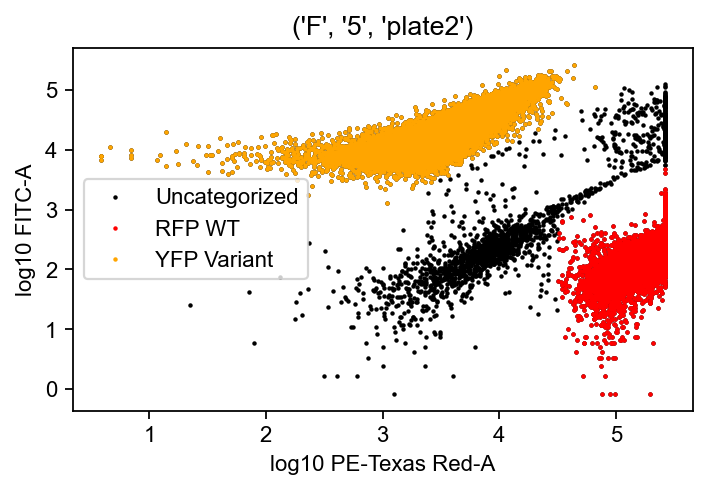

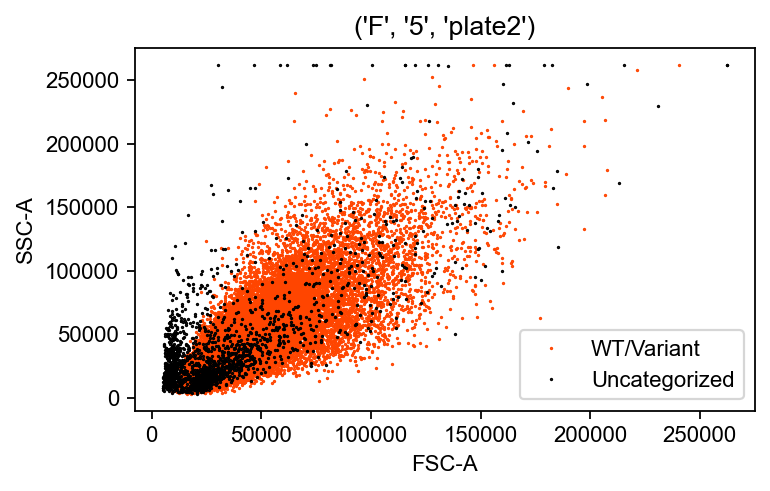

0.5394618672989187
('B', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


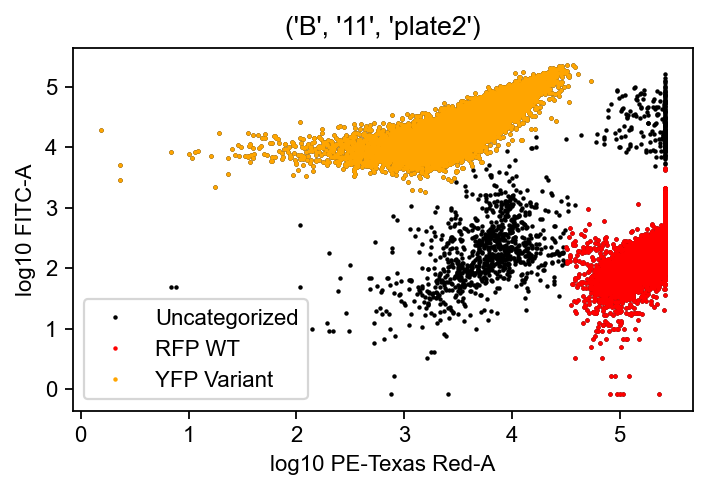

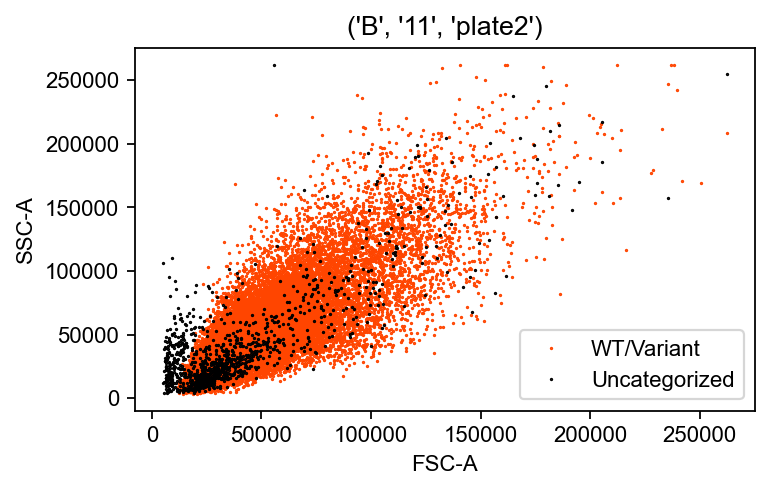

0.5529337627783224
('F', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


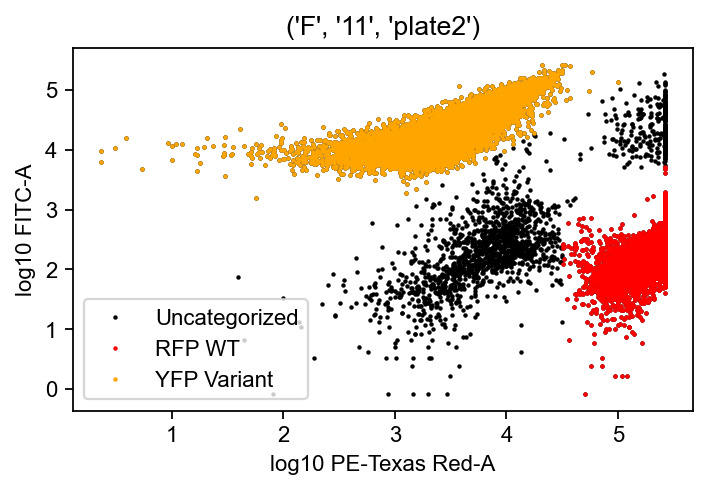

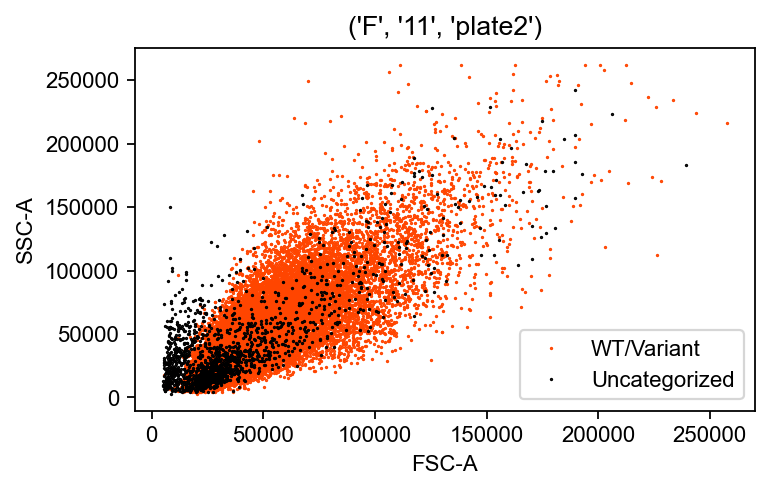

0.5556071760417411
('B', '12', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


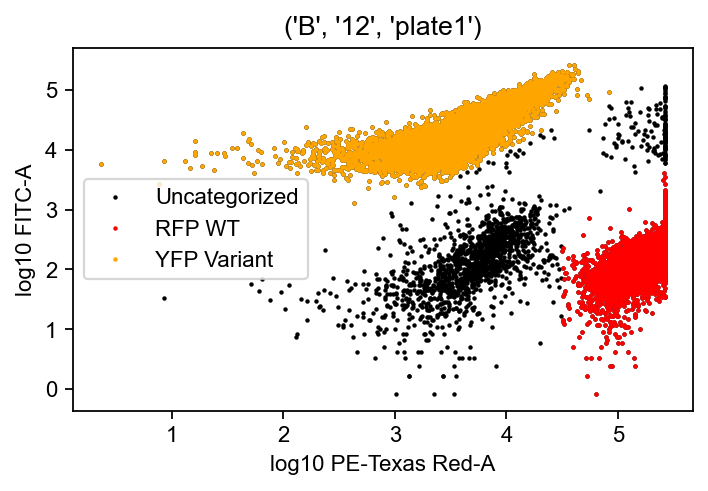

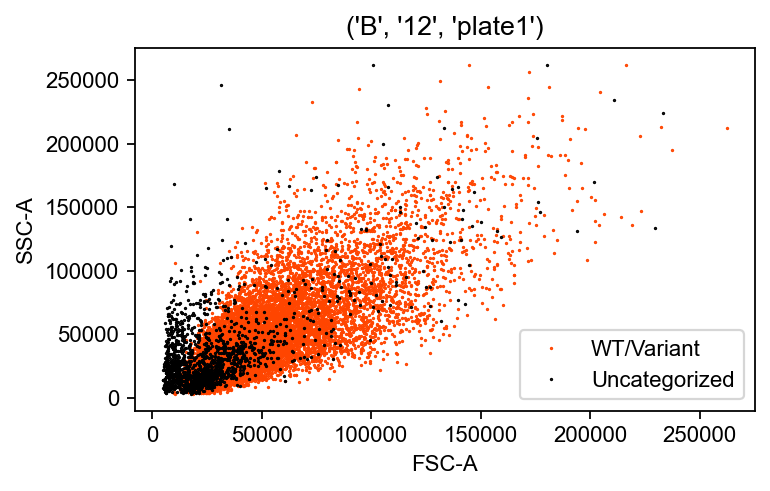

0.5909996678844238
('B', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


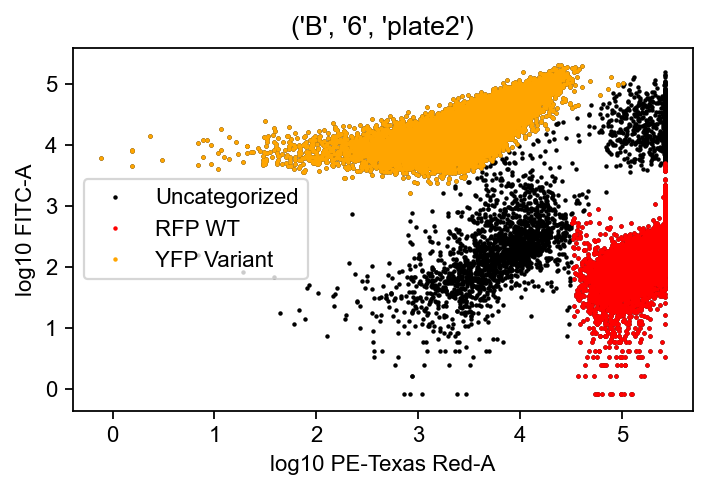

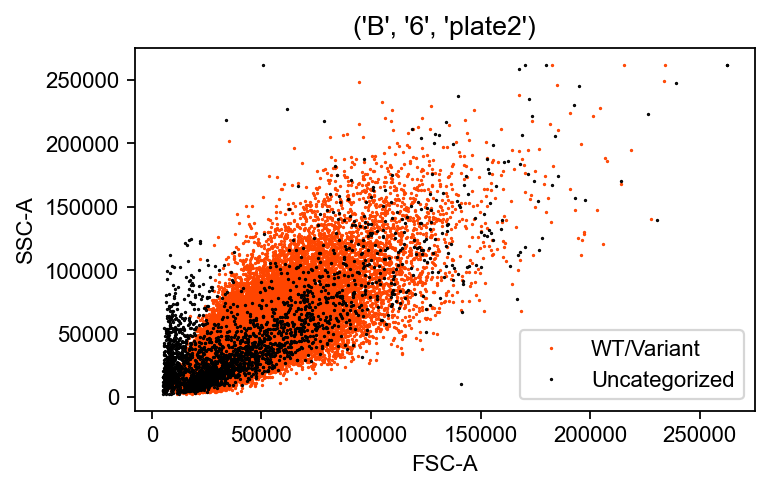

0.5957774261374721
('F', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


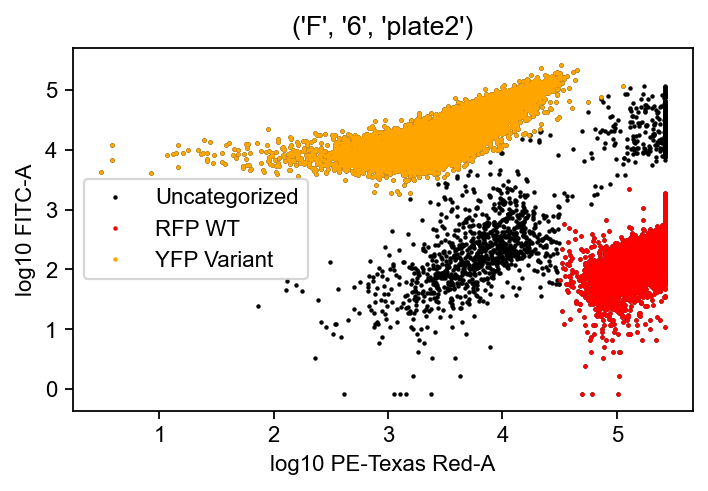

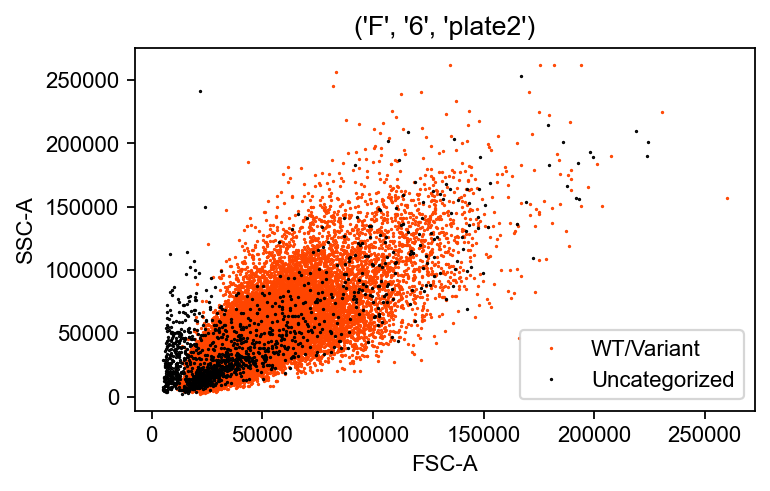

0.6062758401356938
('B', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


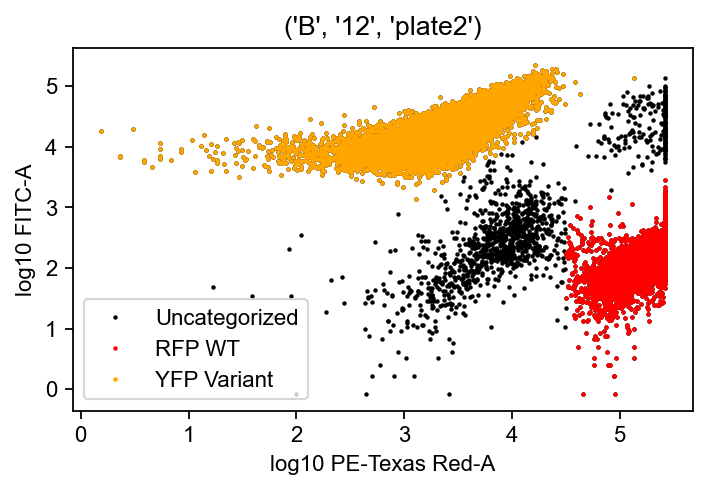

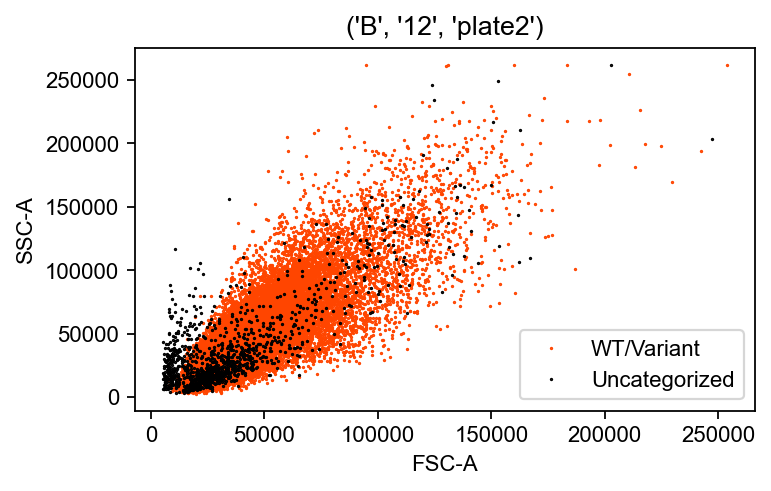

0.6110442477876106
('F', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


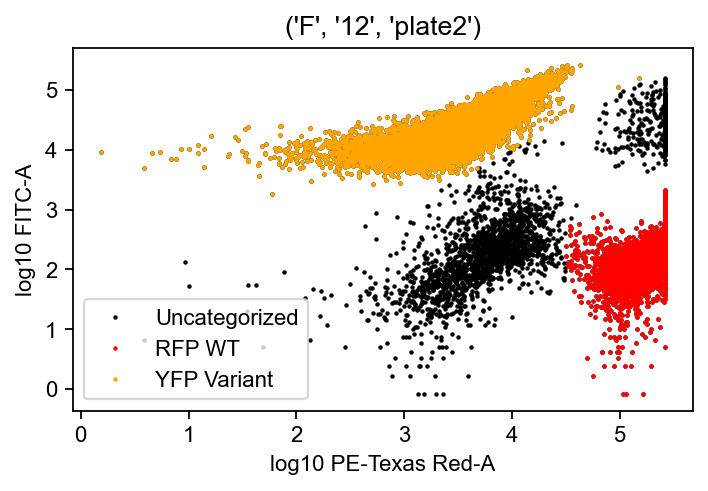

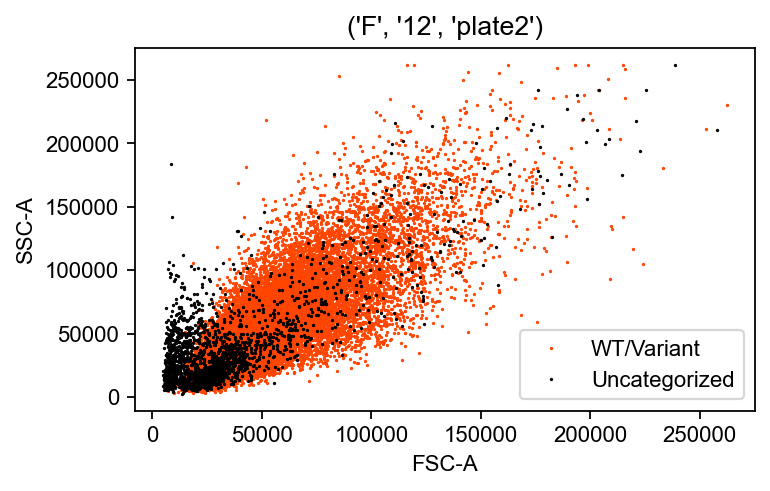

0.6276209823695857
('C', '7', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


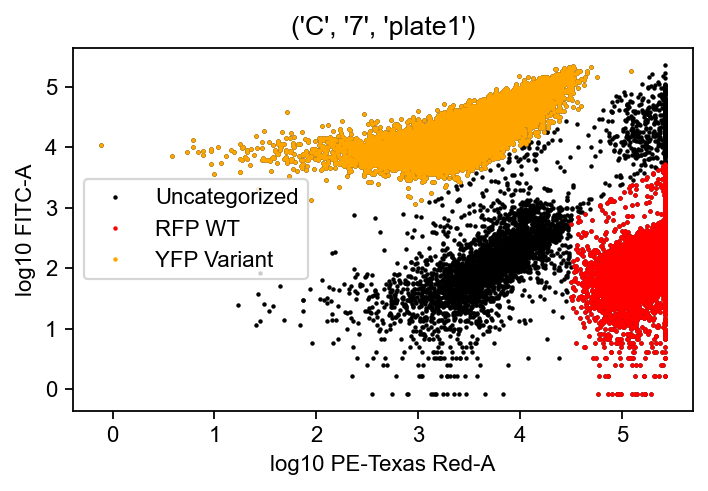

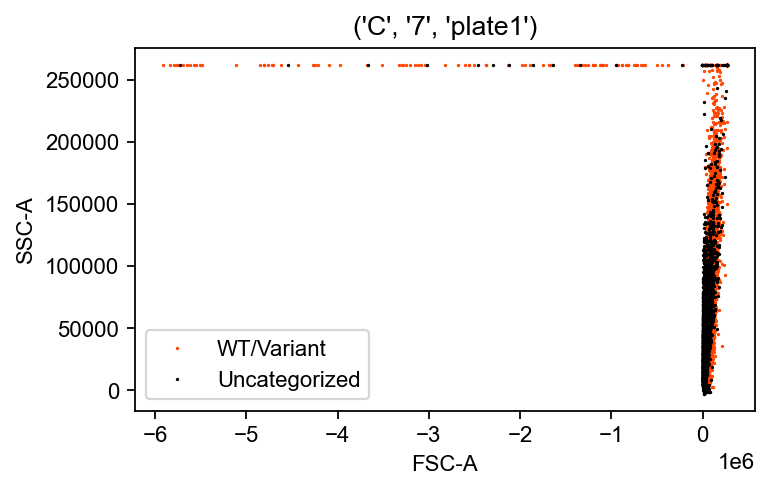

0.551241130680383
('C', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


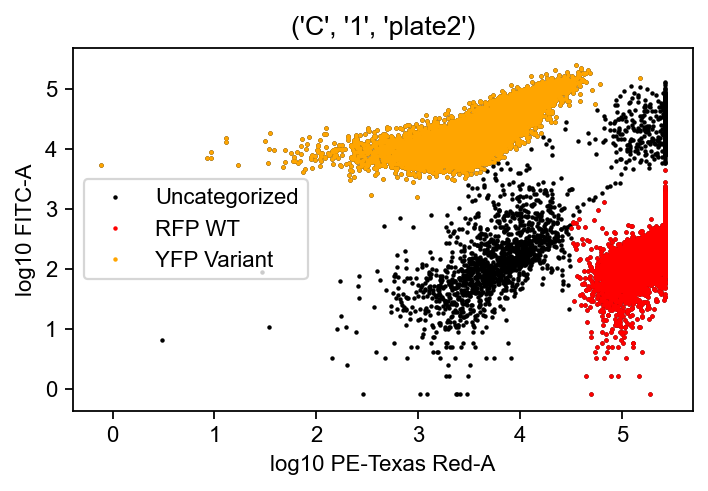

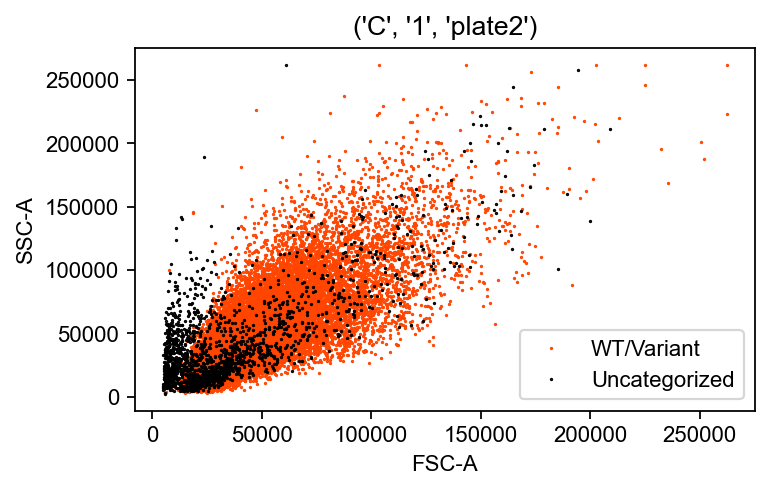

0.5451961137099676
('G', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


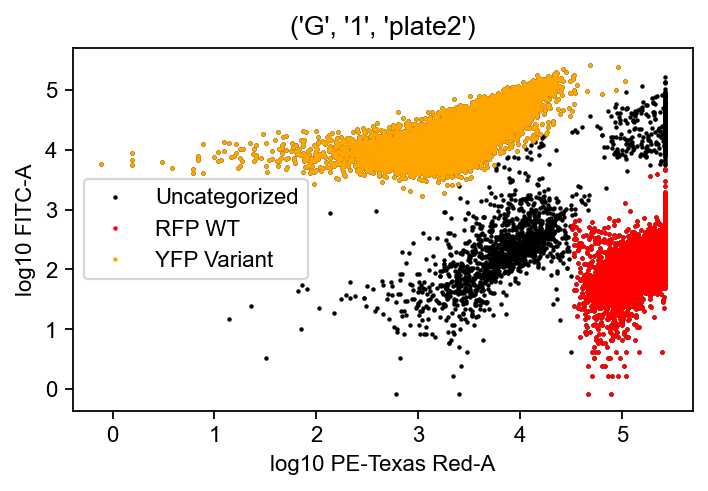

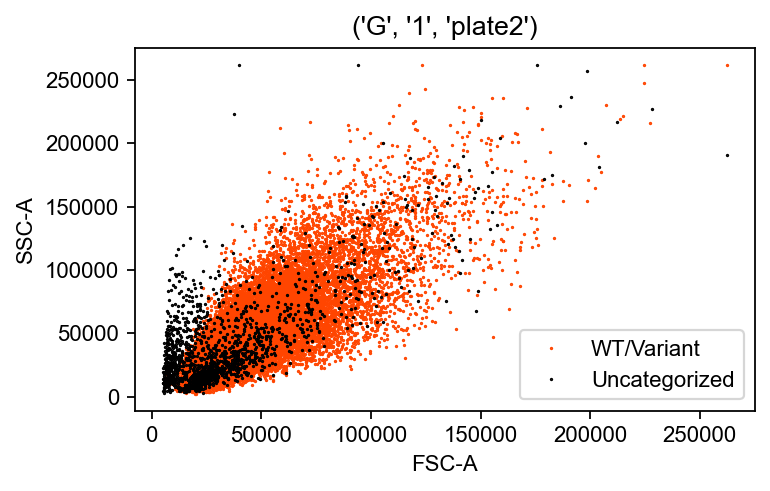

0.5376057605760576
('C', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


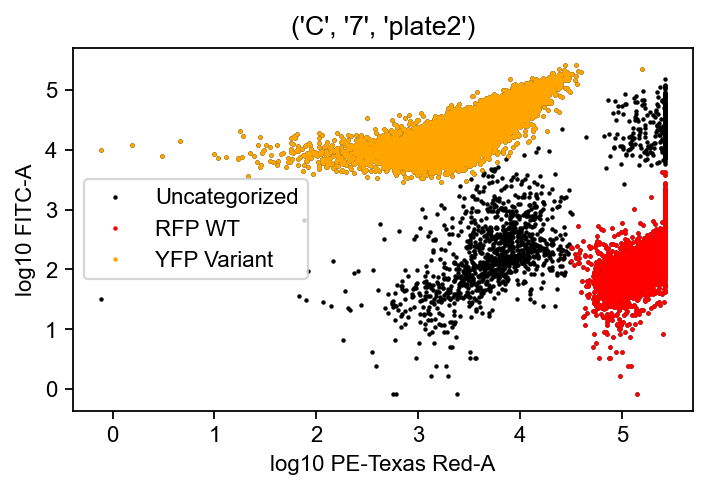

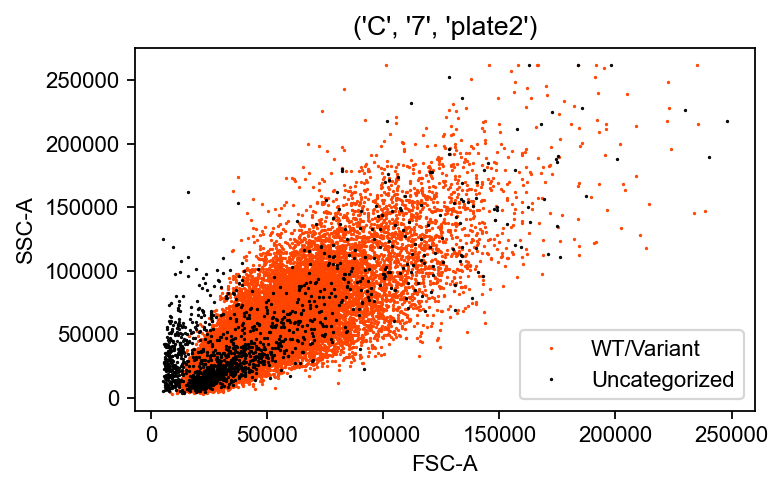

0.5415838773772353
('G', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


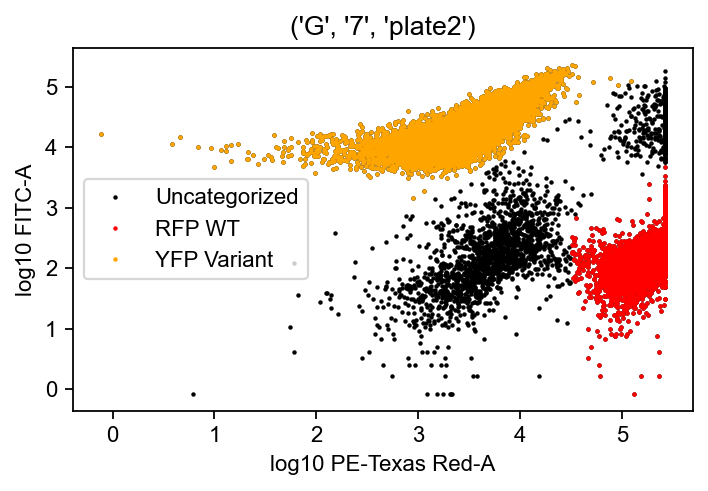

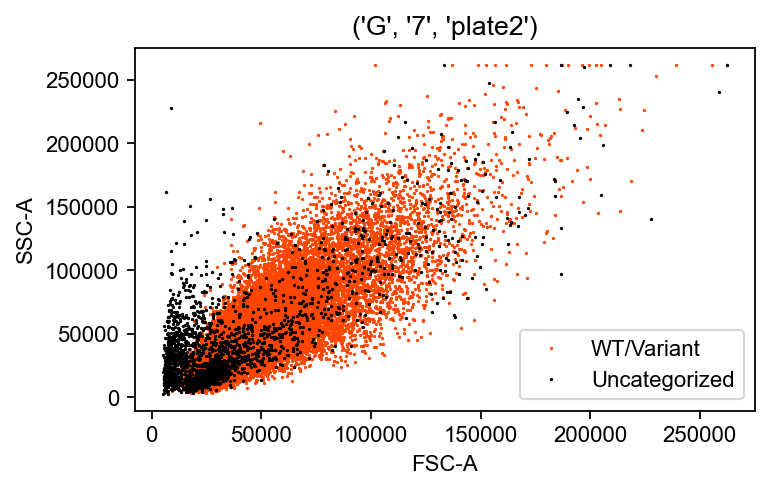

0.543961247086247
('C', '8', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


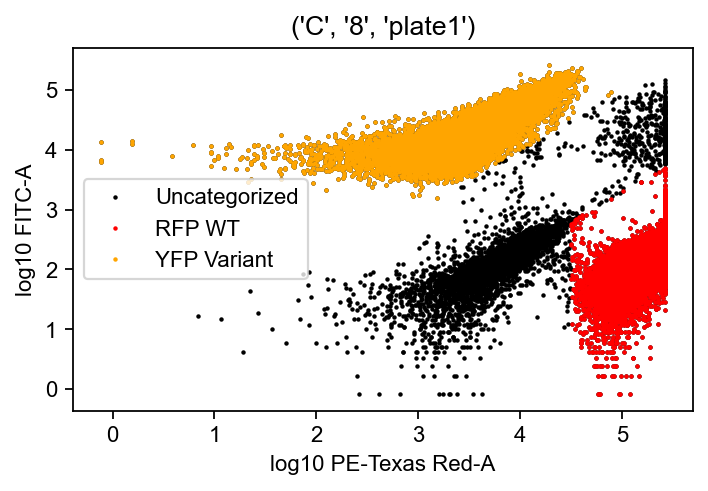

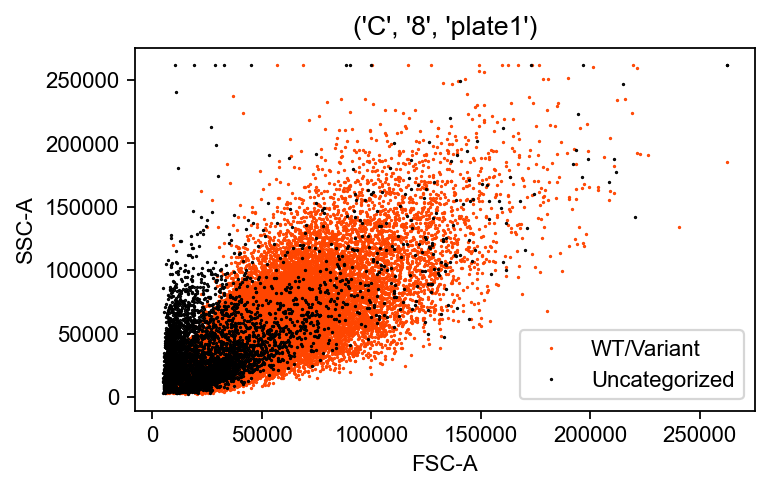

0.43306787168359356
('C', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


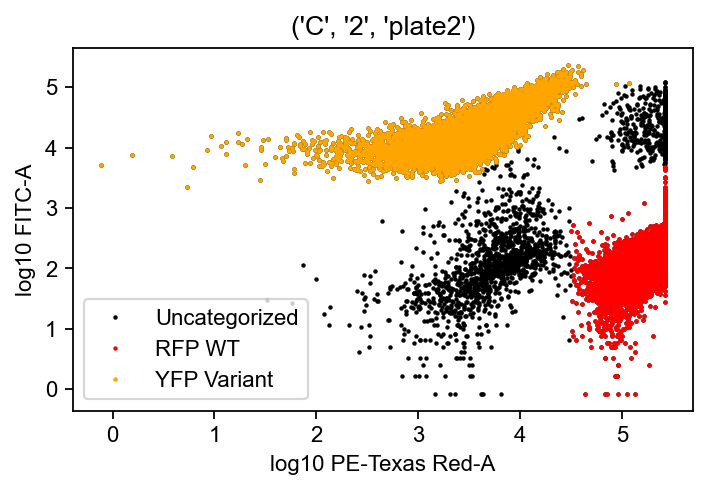

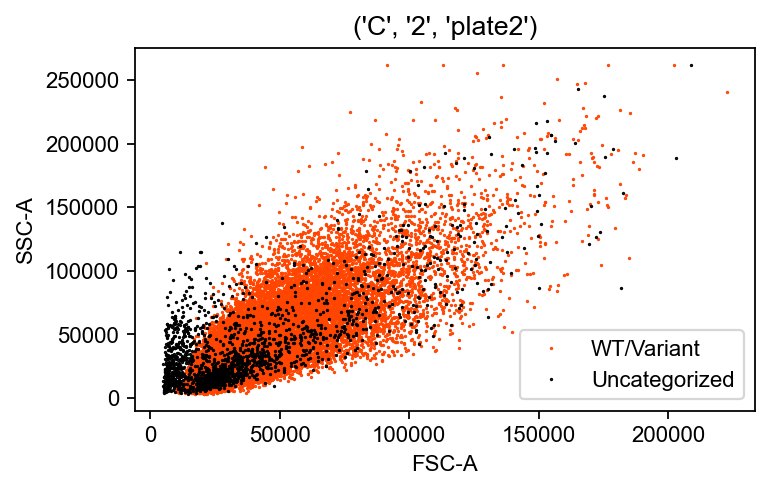

0.4161141904865413
('G', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


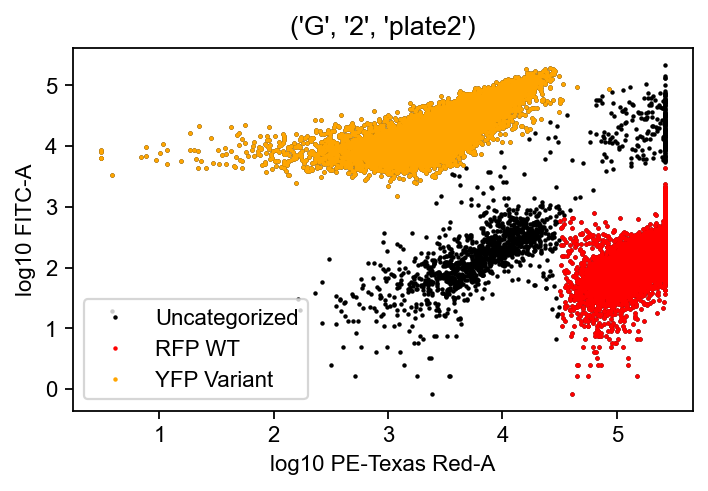

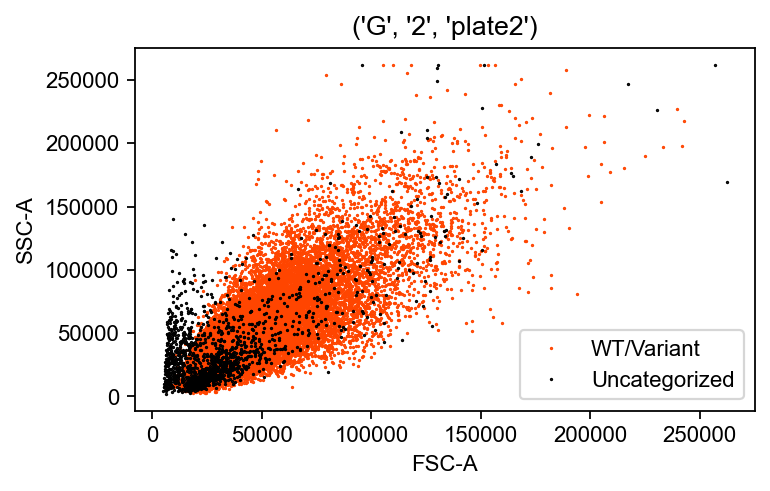

0.42218093468629414
('C', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


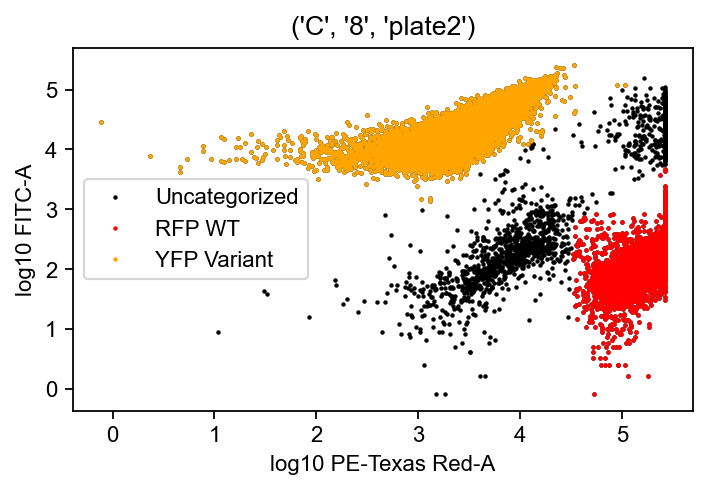

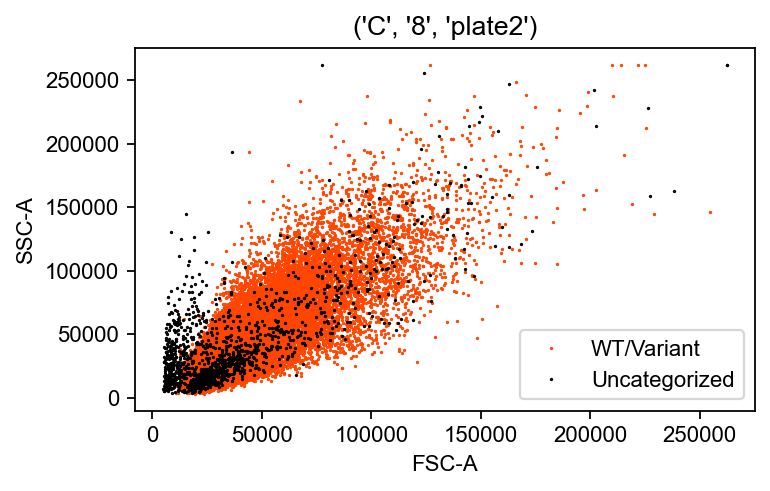

0.41271024057909306
('G', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


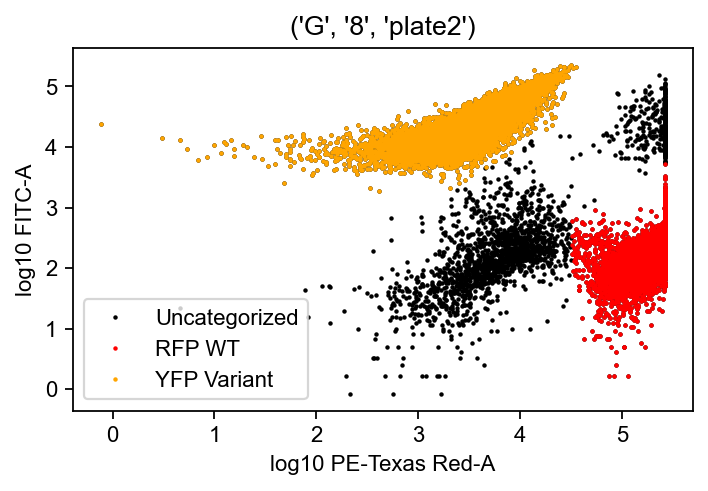

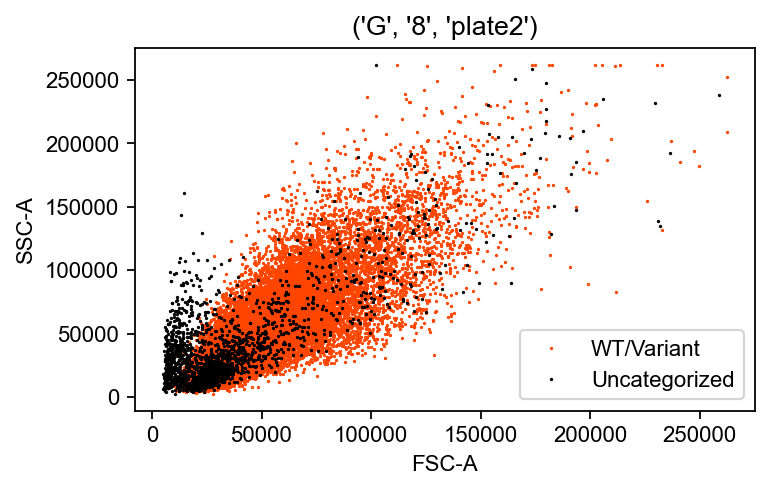

0.4114848058829891
('C', '9', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


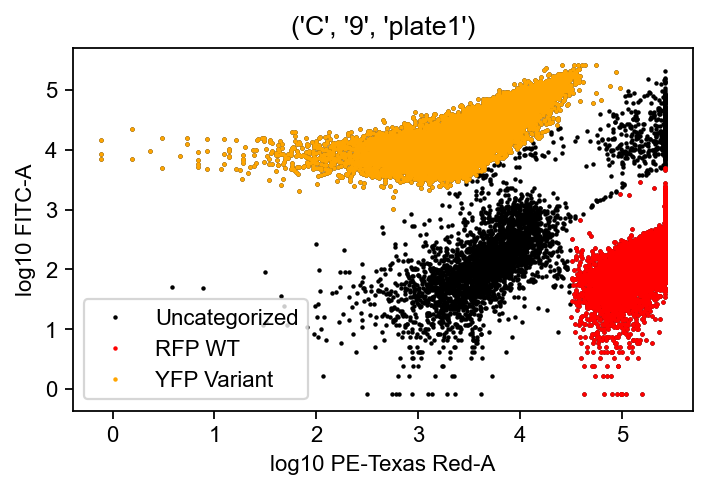

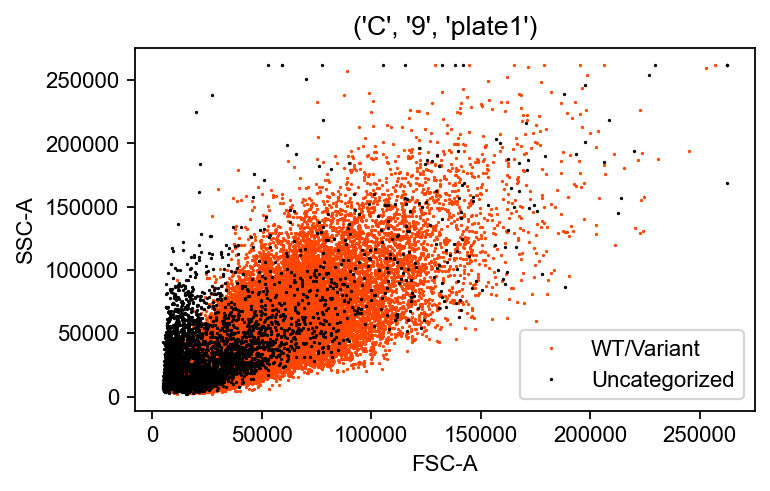

0.5593848475433847
('C', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


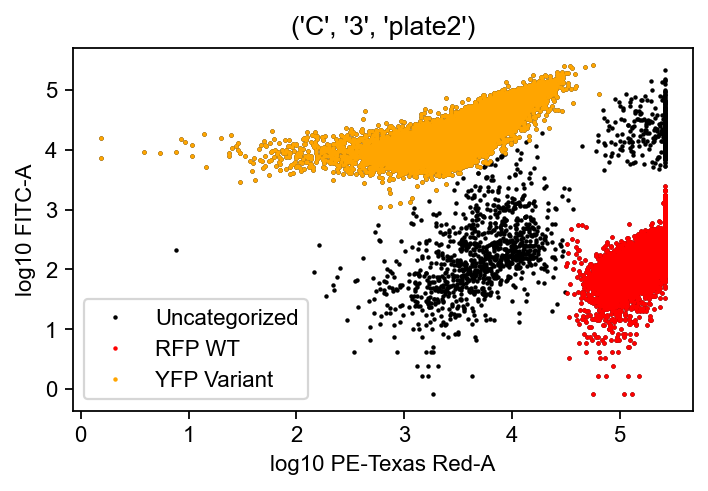

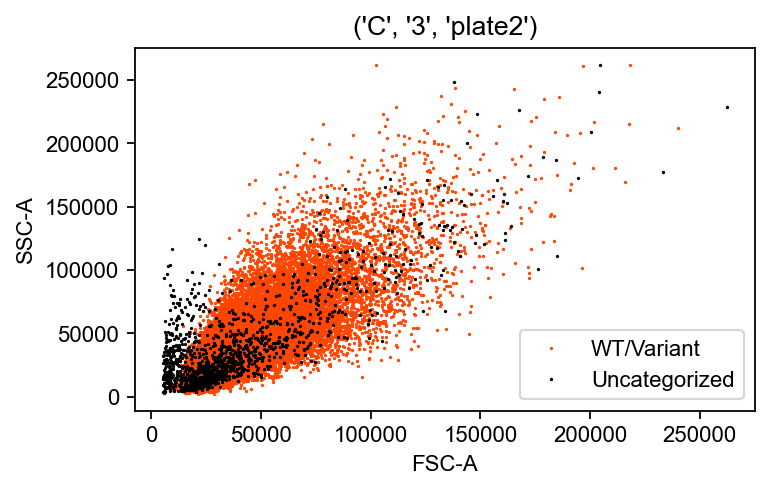

0.5589354964955349
('G', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


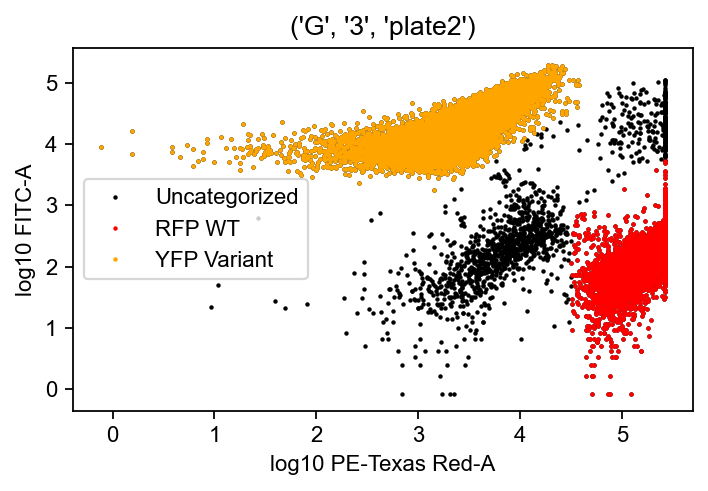

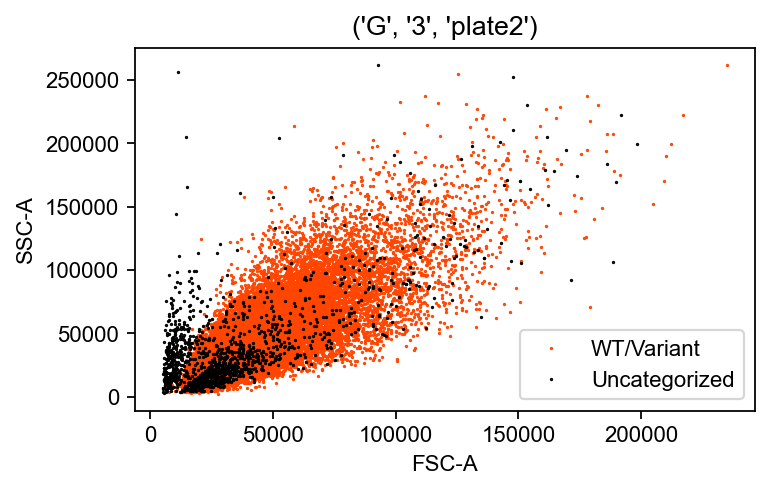

0.5539319018185715
('C', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


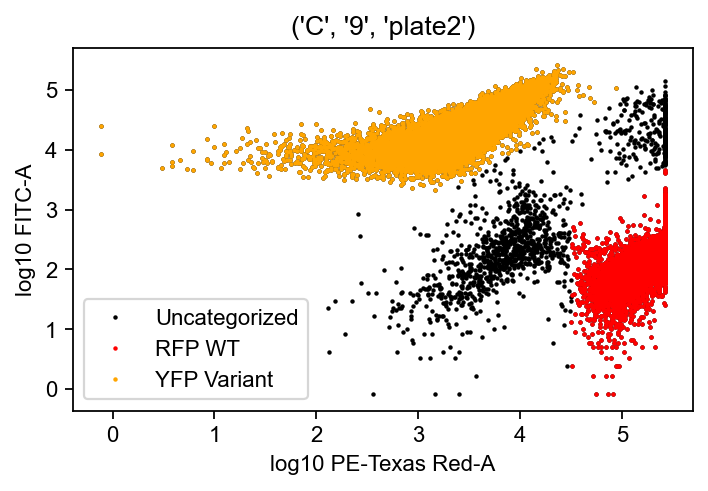

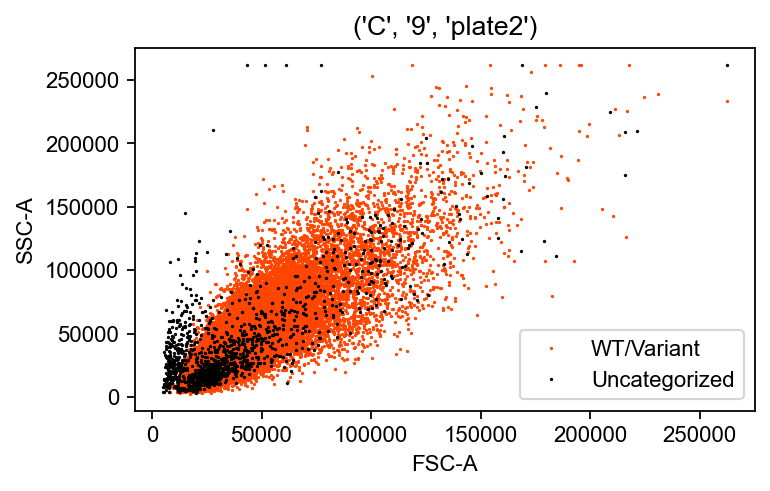

0.5385959282632724
('G', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


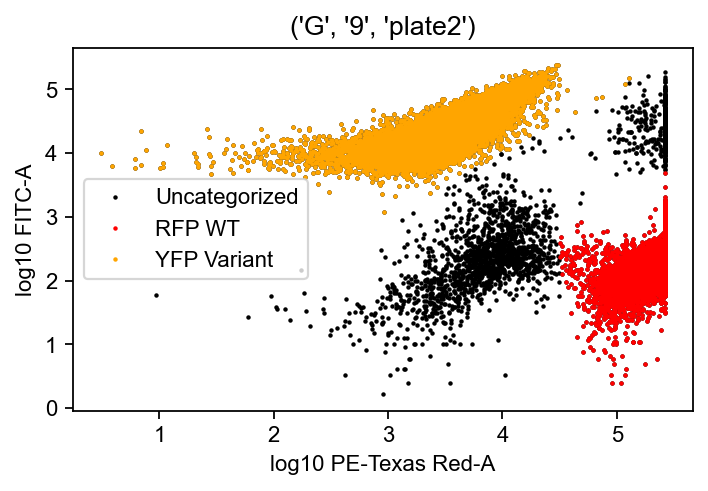

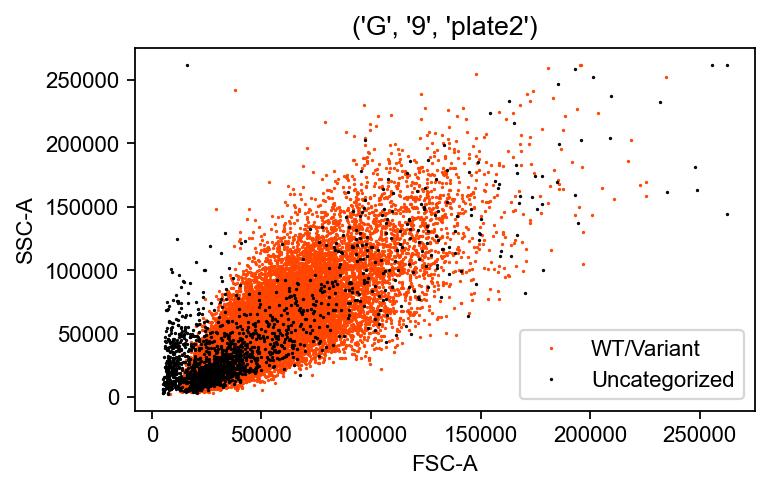

0.5495232955567548
('C', '10', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


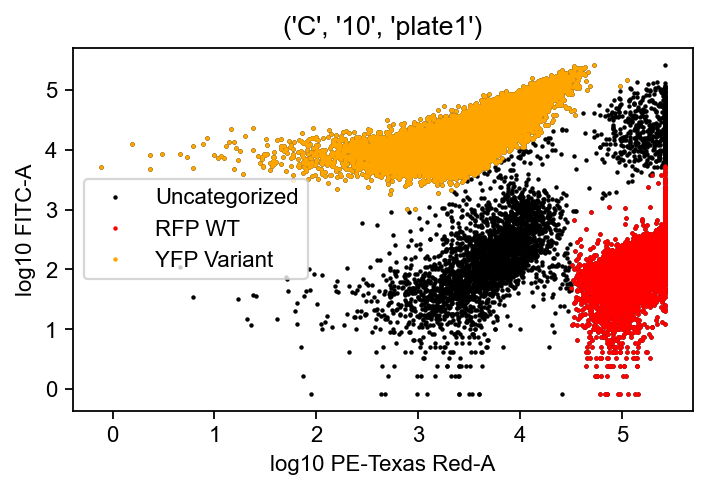

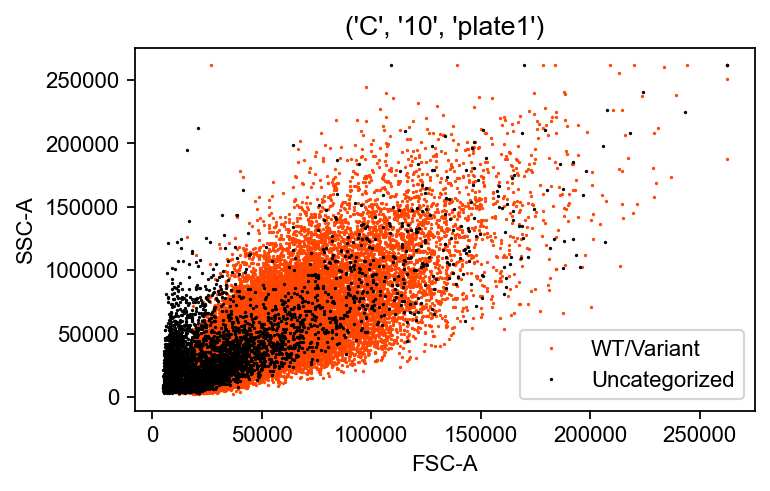

0.5331228881380046
('C', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


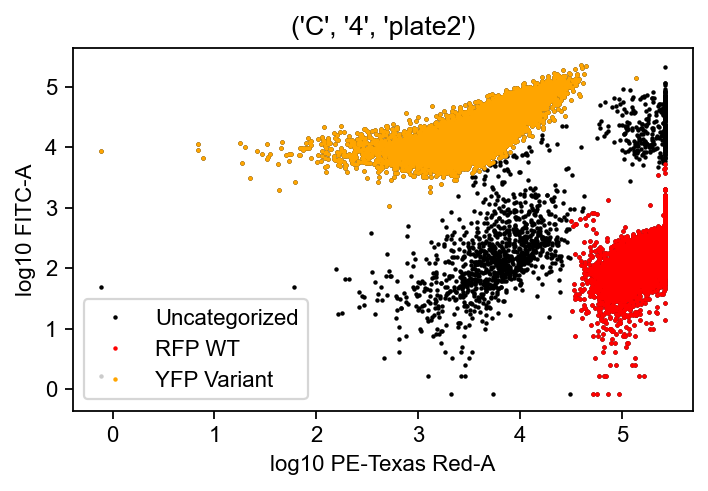

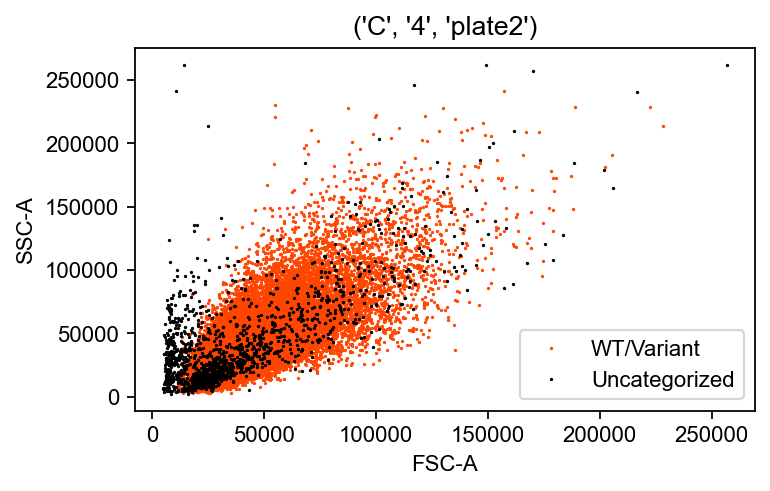

0.5412402382056128
('G', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


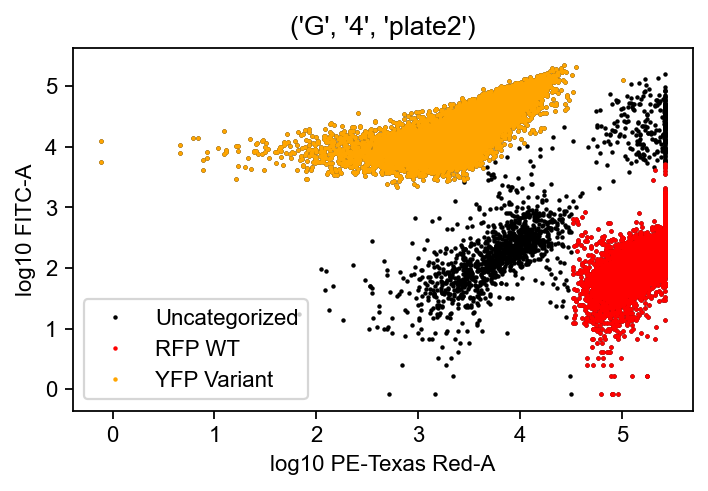

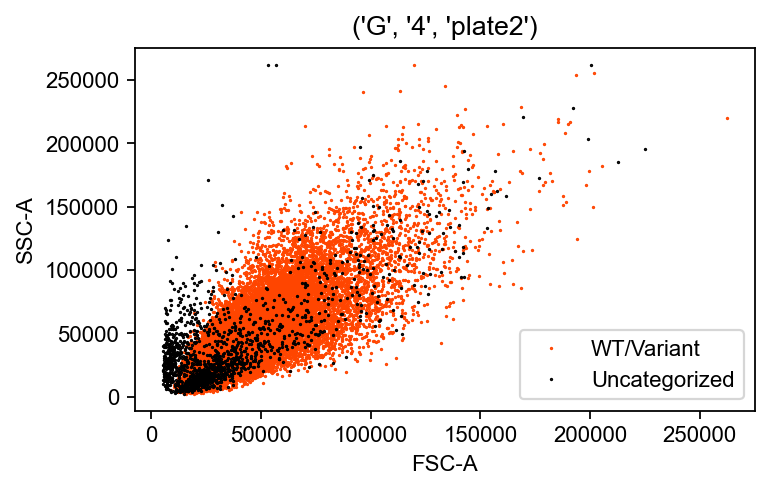

0.5605040504050405
('C', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


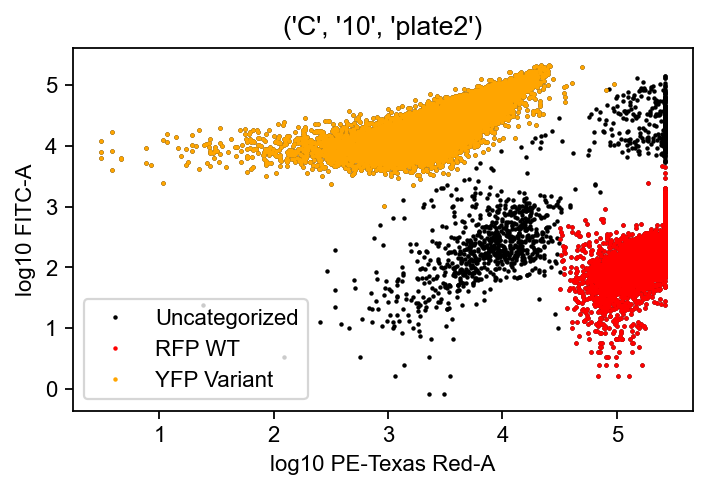

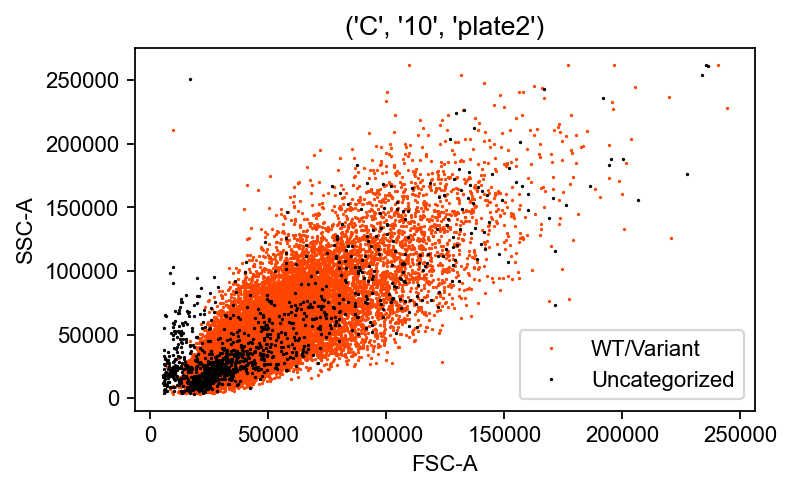

0.5837593878918232
('G', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


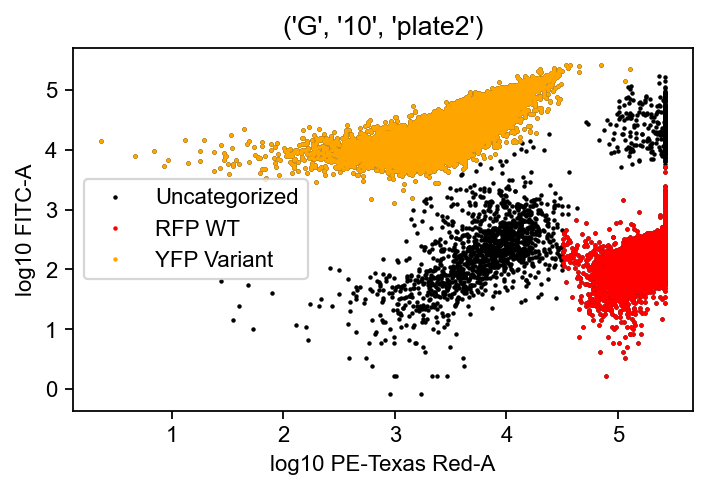

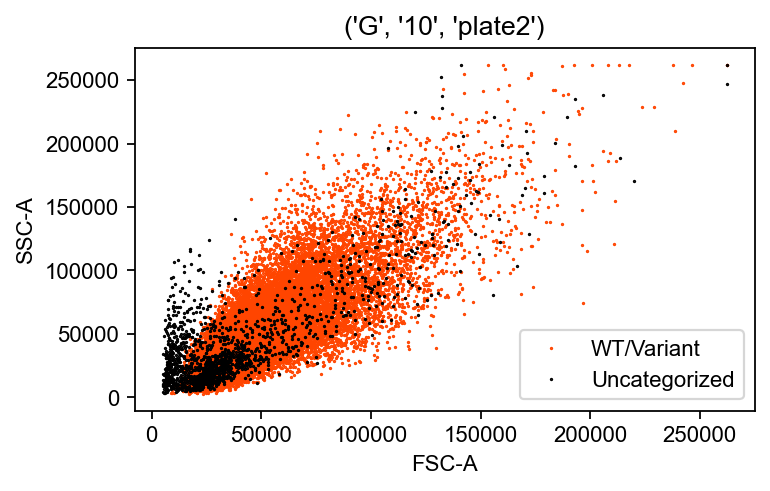

0.5994769087456558
('C', '11', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


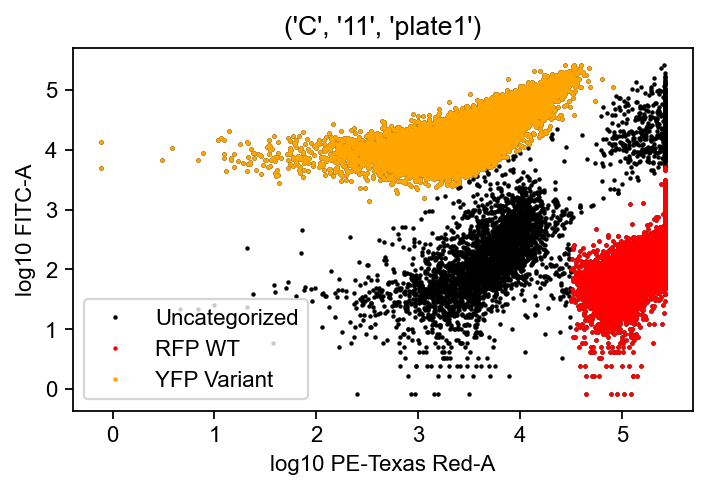

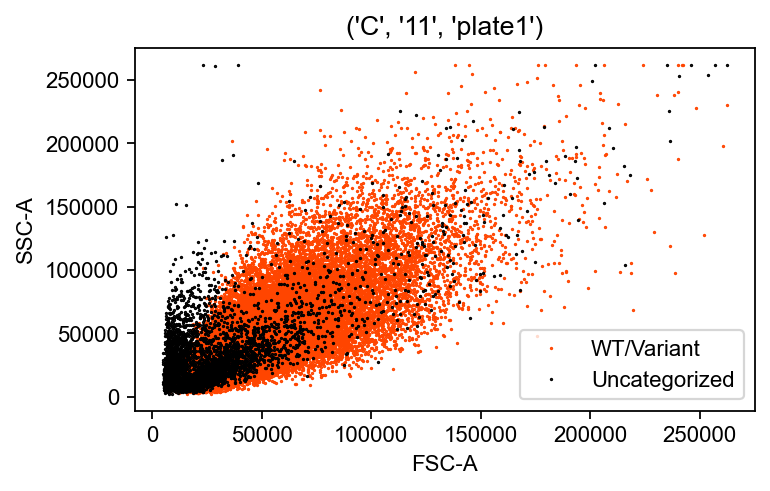

0.5106387679798493
('C', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


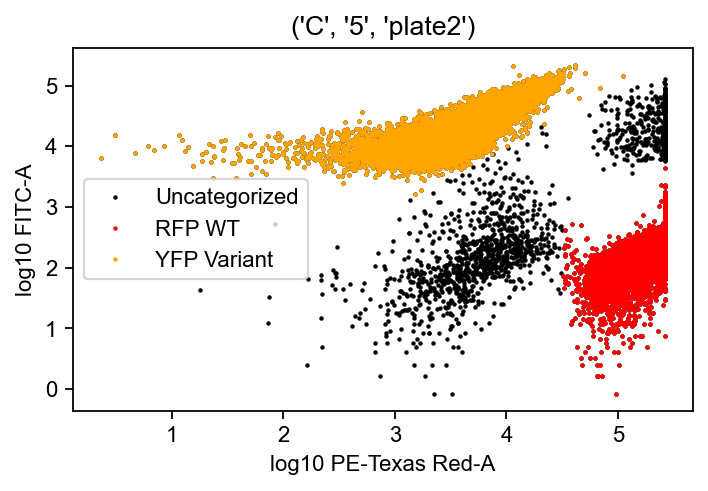

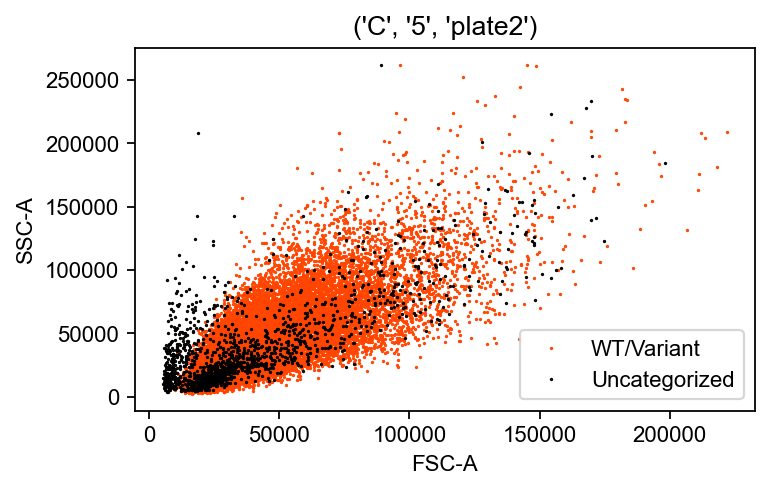

0.5444670014602699
('G', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


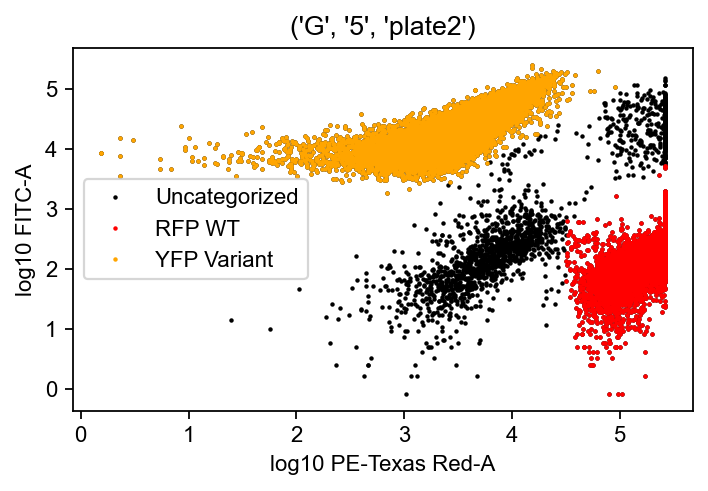

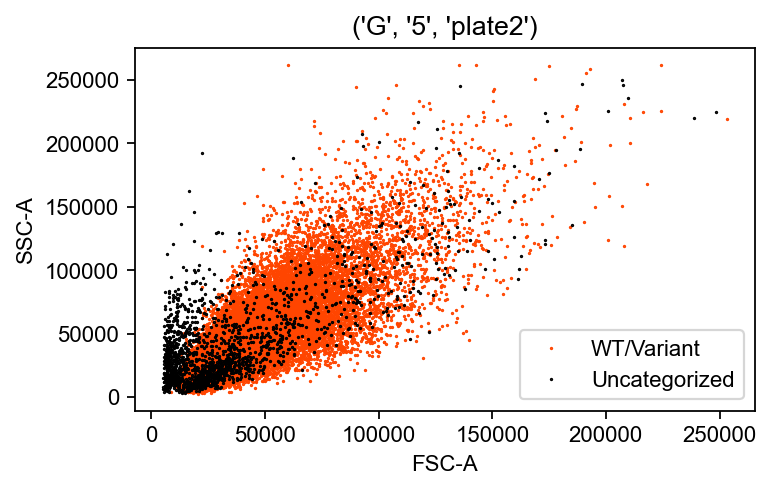

0.5518748645329095
('C', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


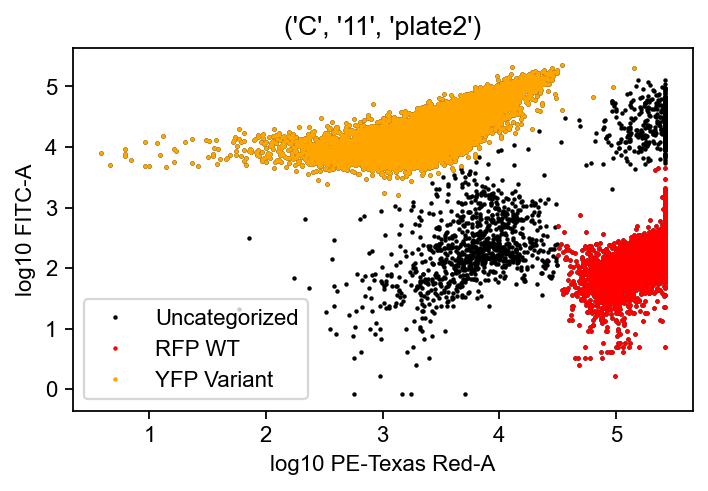

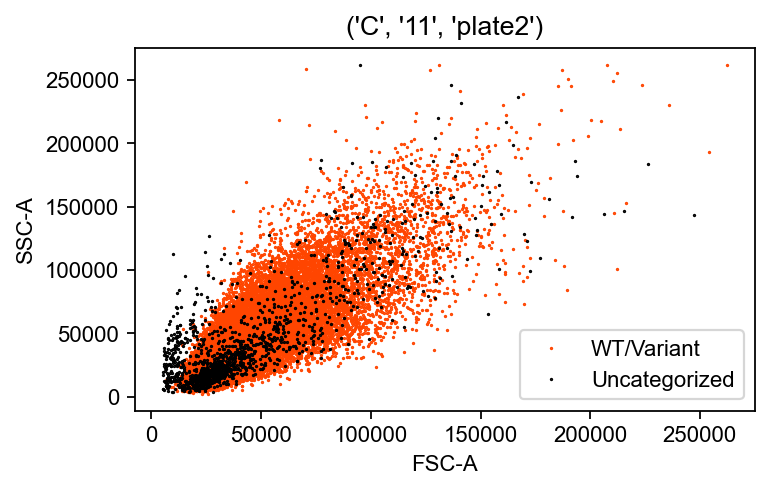

0.5690394359210573
('G', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


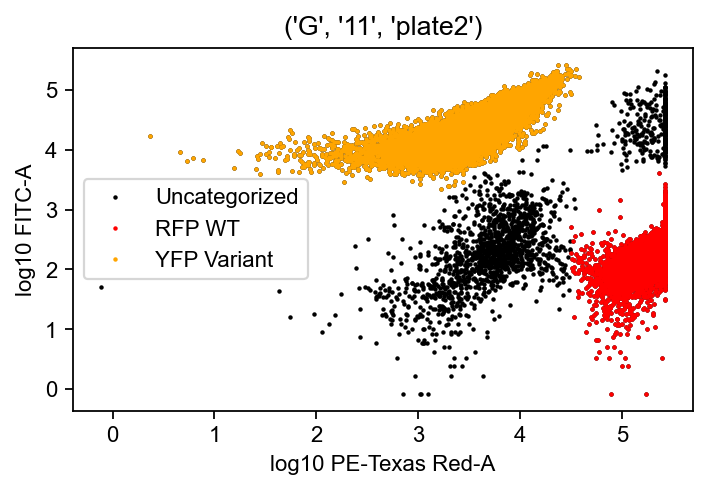

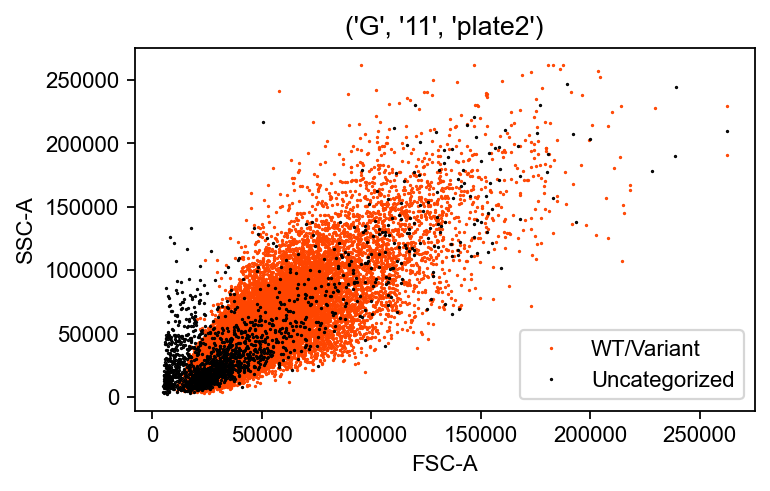

0.5857255351134655
('C', '12', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


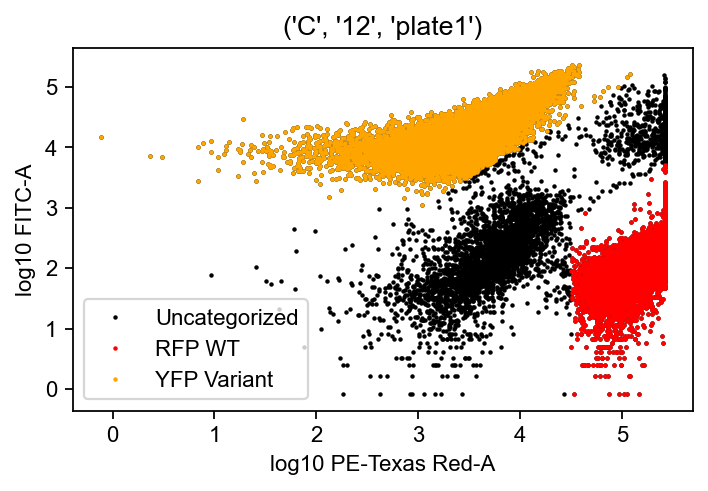

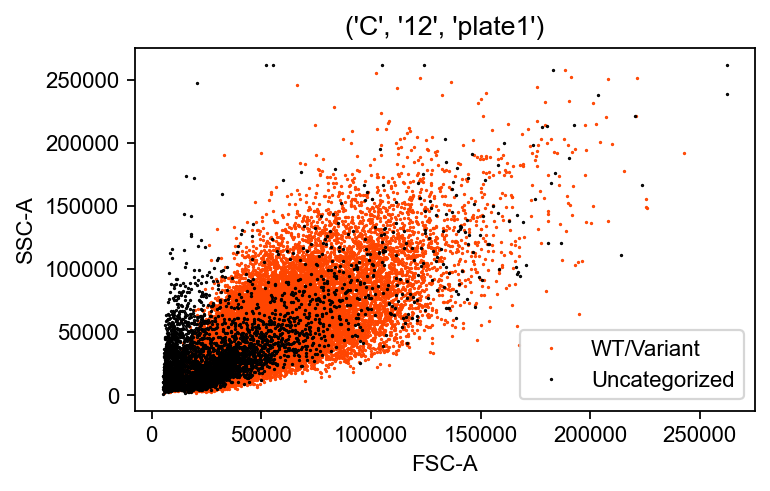

0.48565244555515885
('C', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


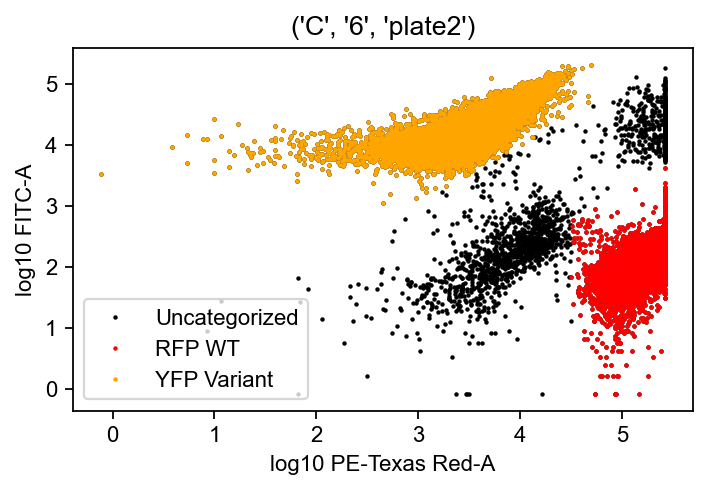

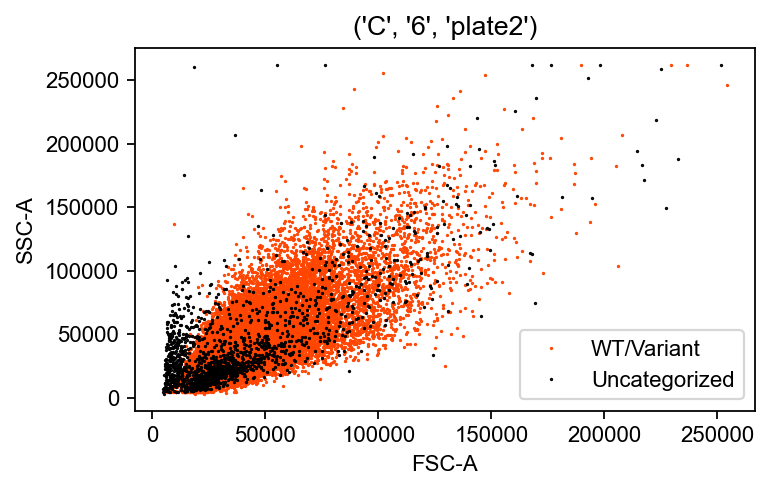

0.4829161271759459
('G', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


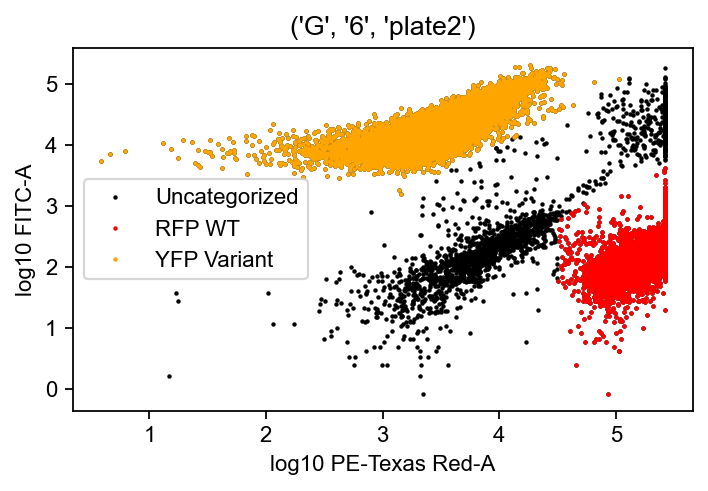

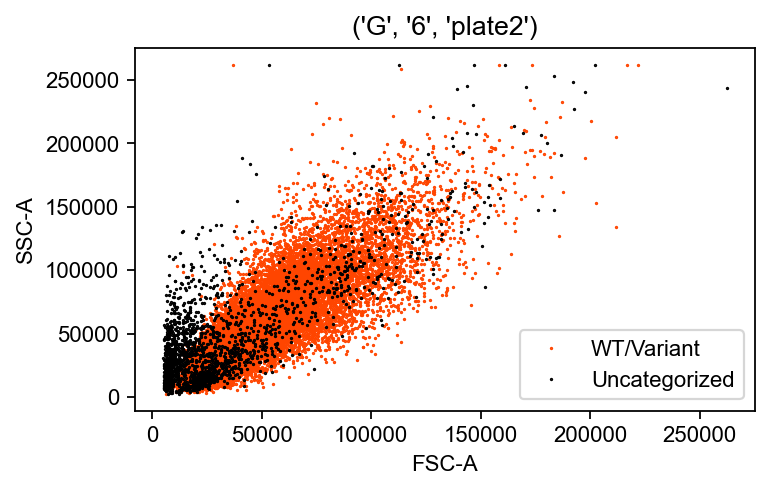

0.48774096277416806
('C', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


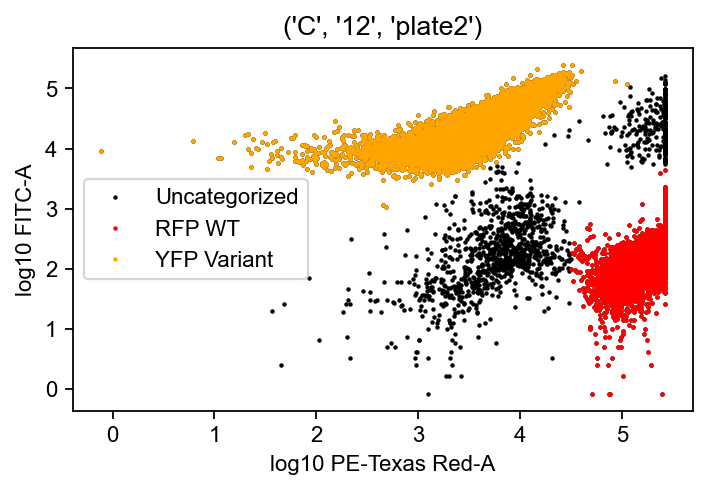

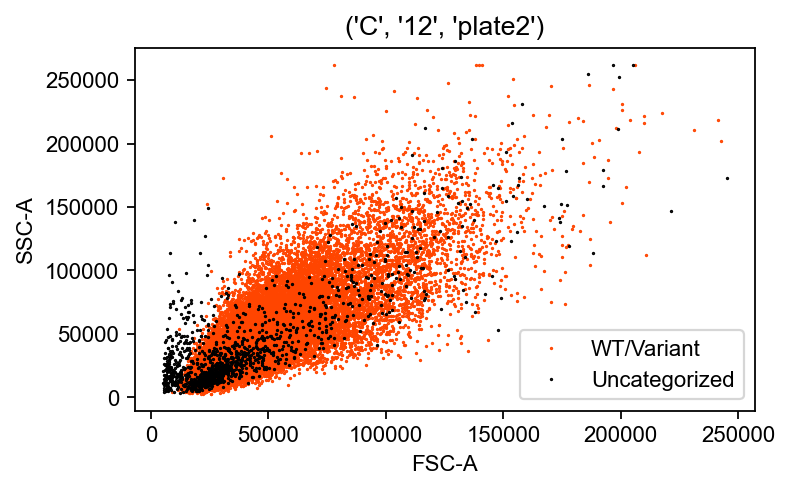

0.500421289144783
('G', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


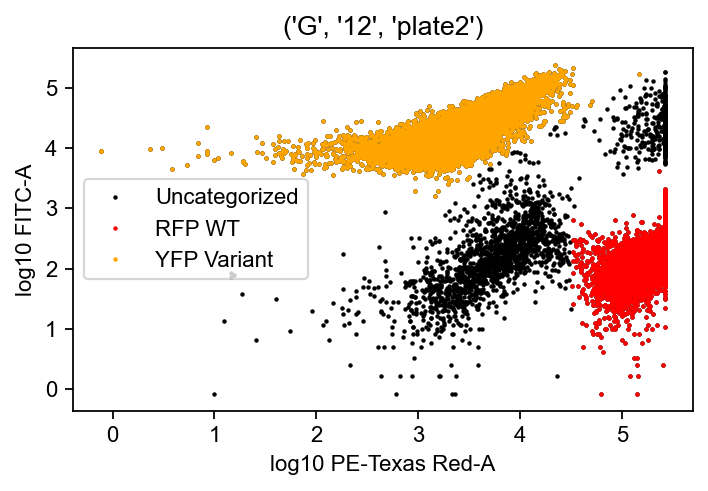

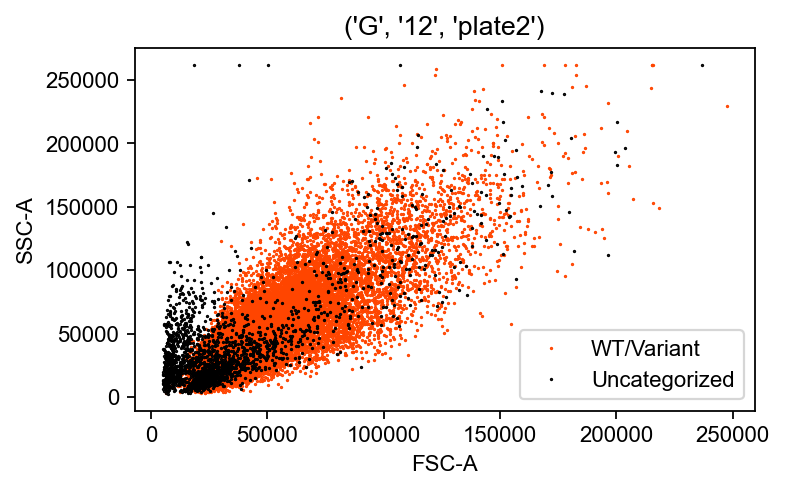

0.5042449749655322
('D', '7', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


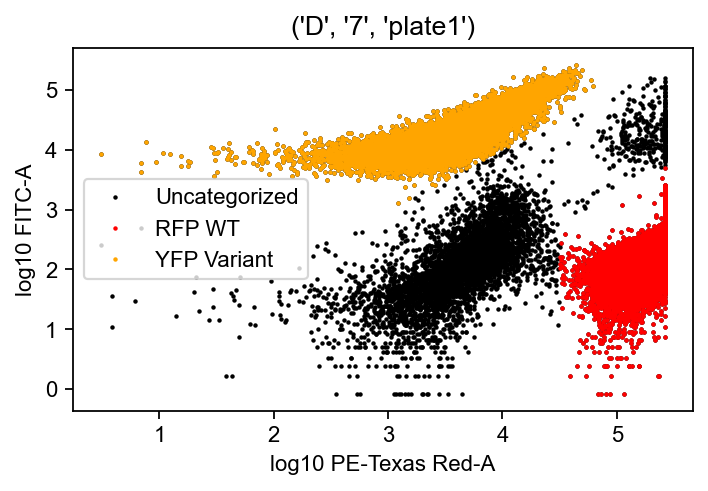

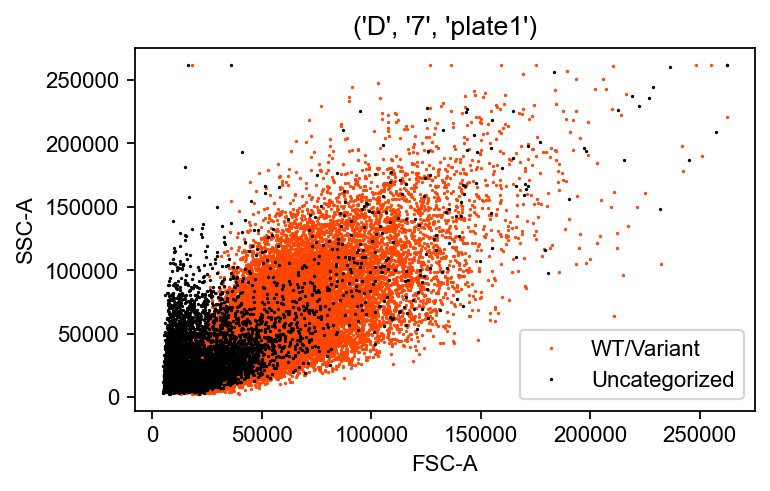

0.44359200669880283
('D', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


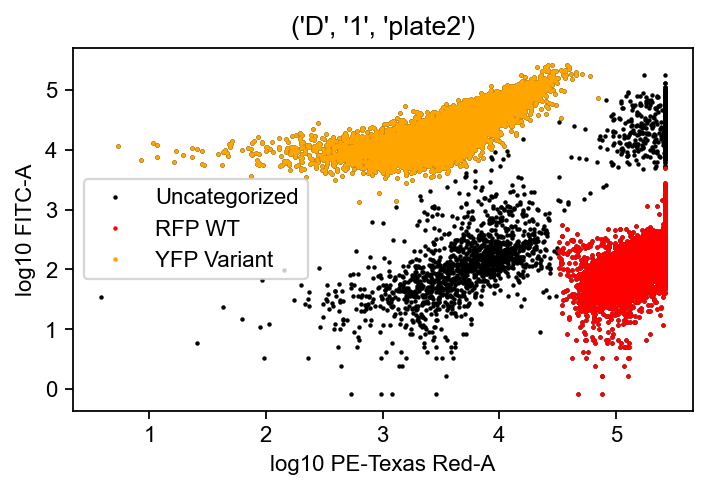

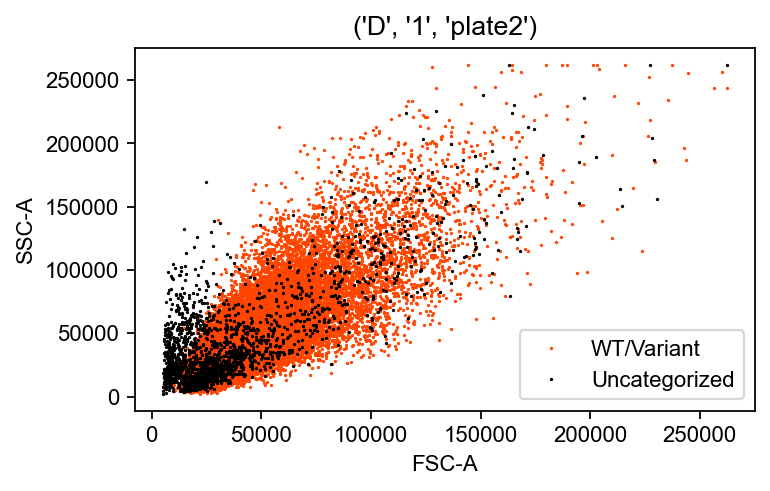

0.37791978049749086
('H', '1', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


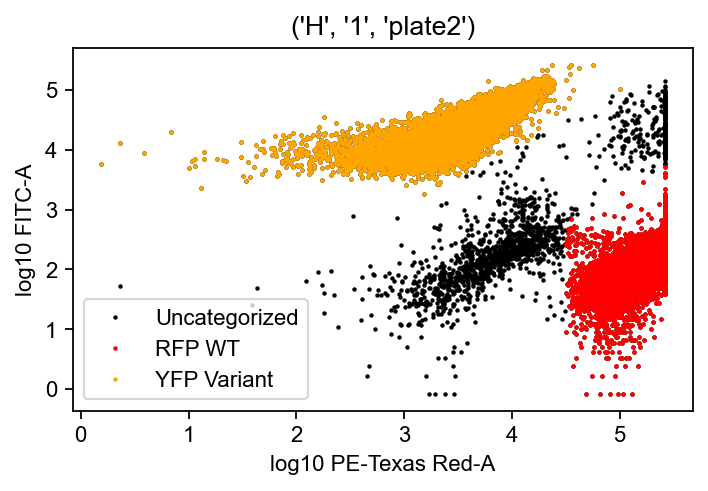

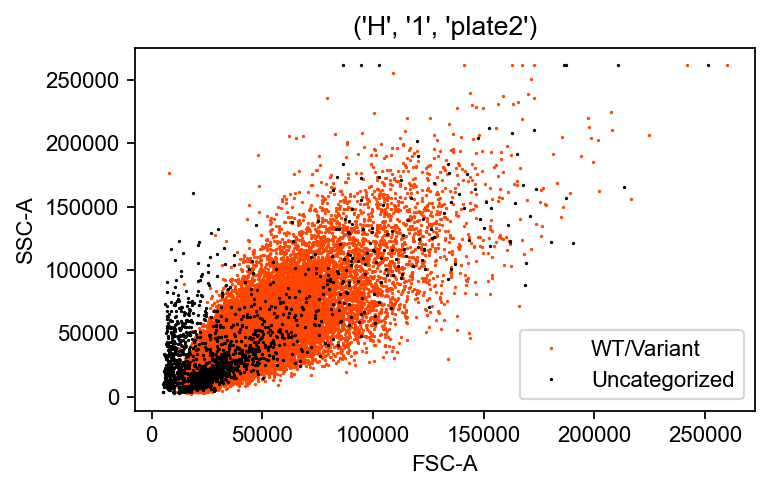

0.3405807466742955
('D', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


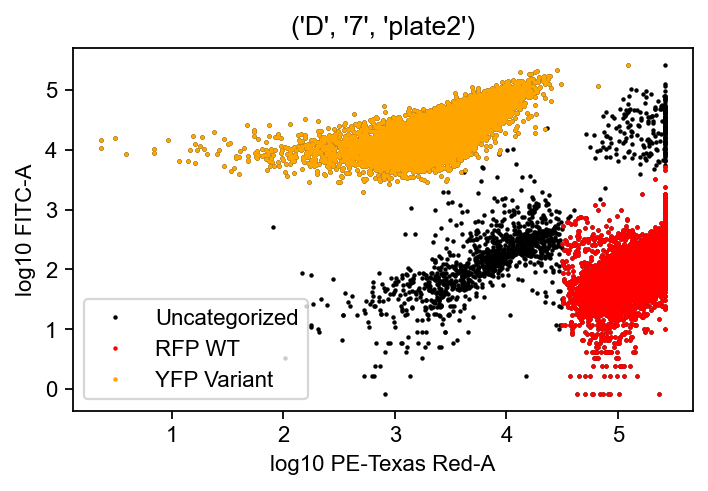

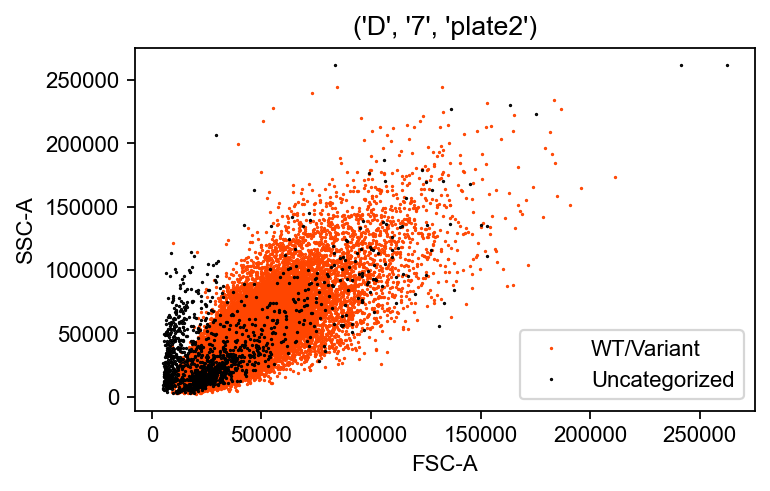

0.293668900613147
('H', '7', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


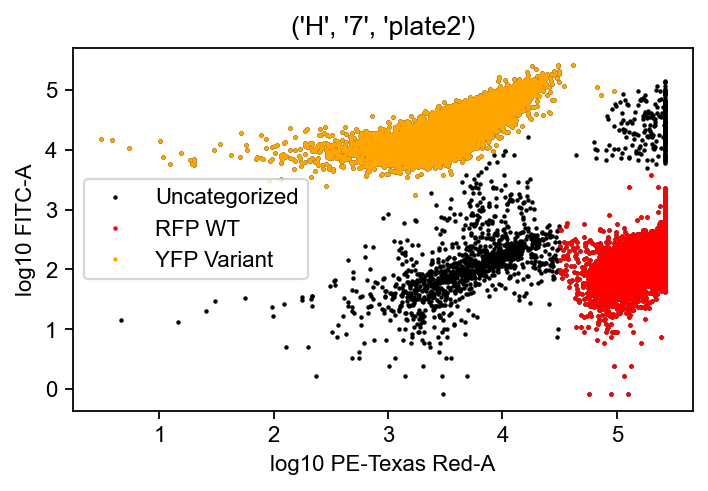

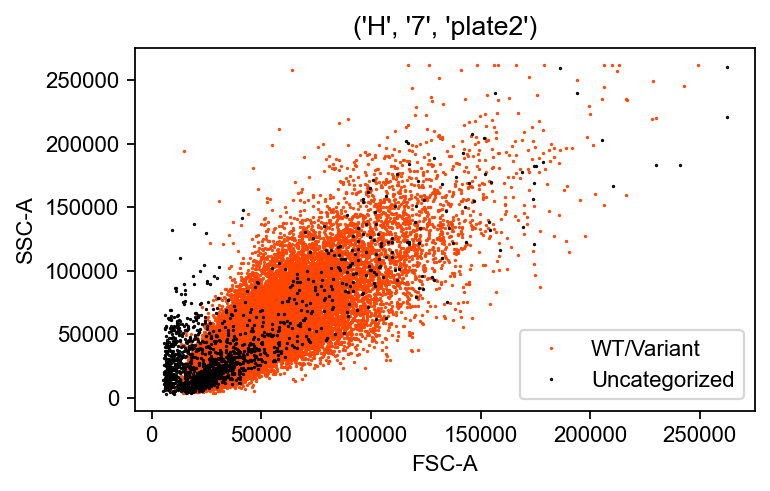

0.26962842725572533
('D', '8', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


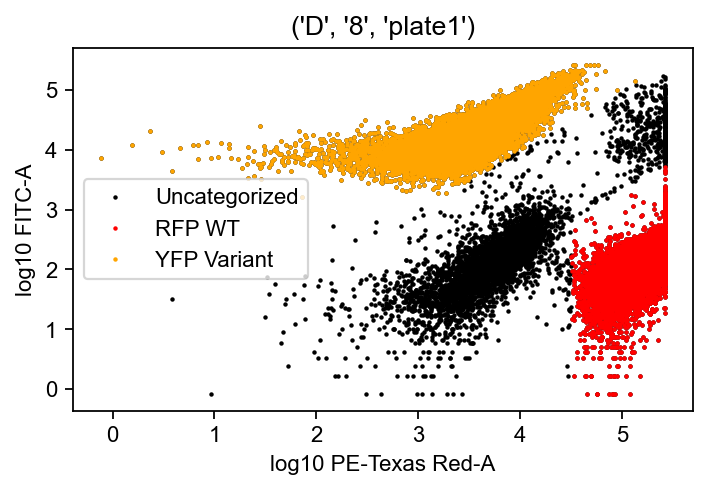

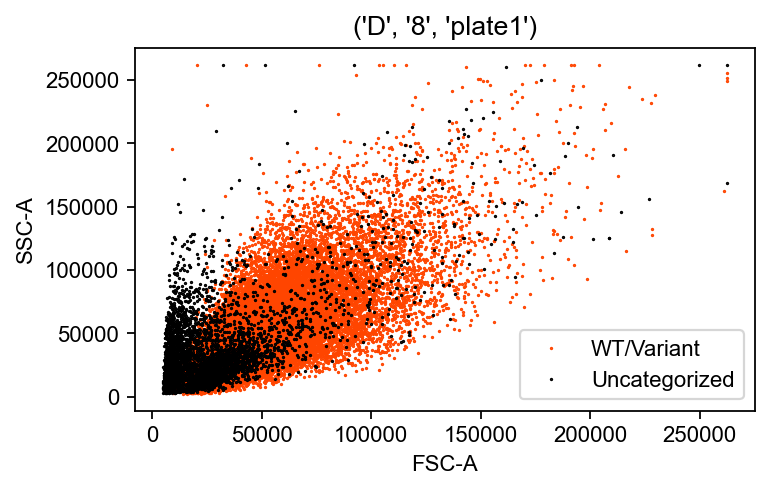

0.4017258338549584
('D', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


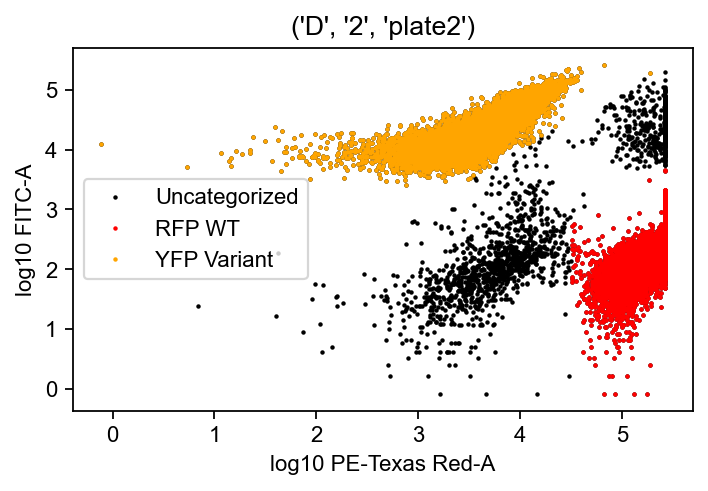

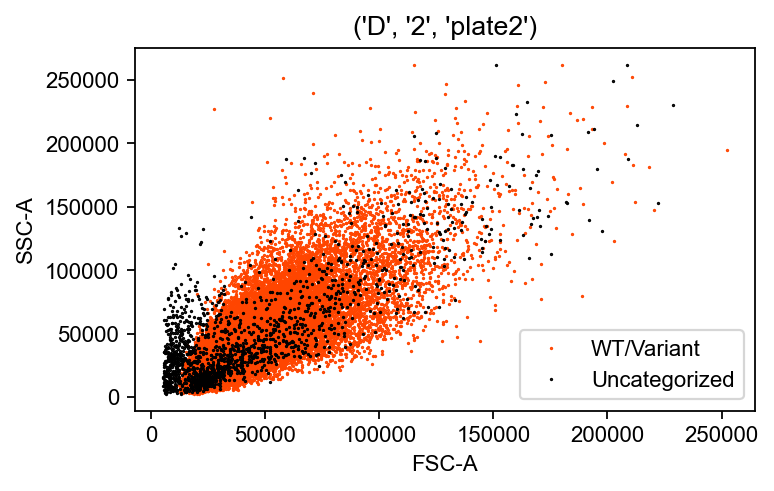

0.35389065457272434
('H', '2', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


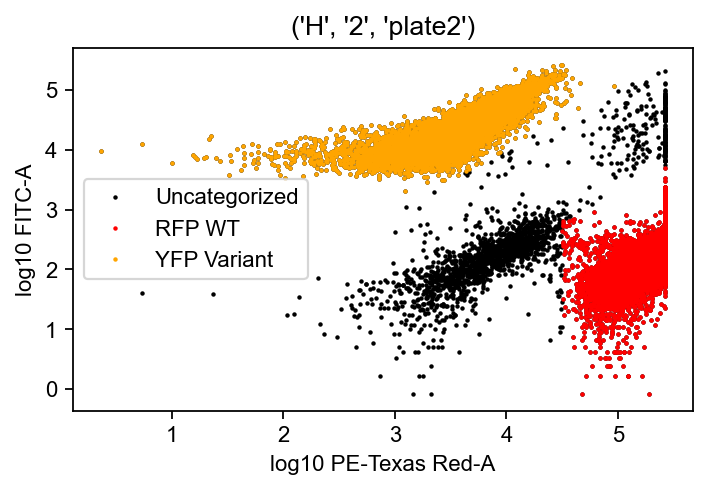

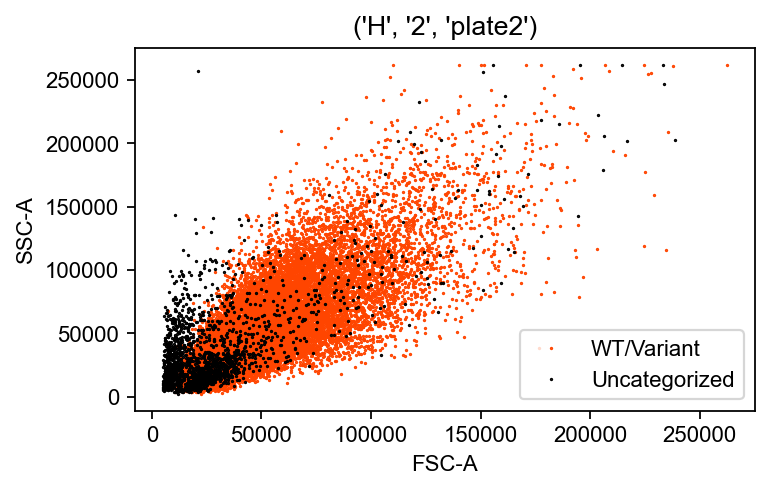

0.32873414537745677
('D', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


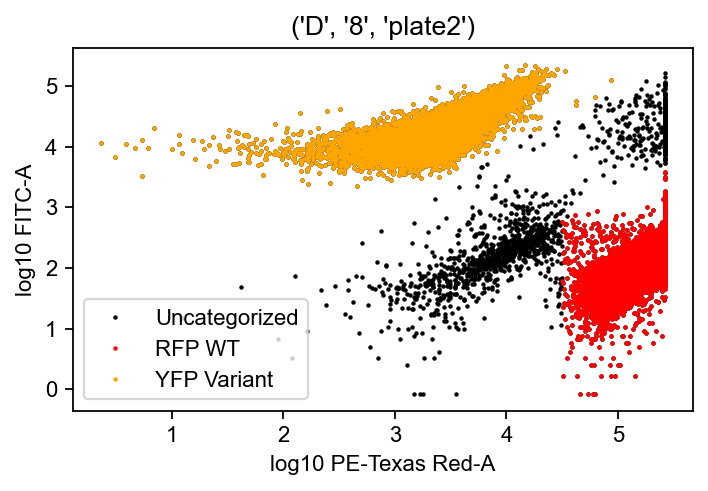

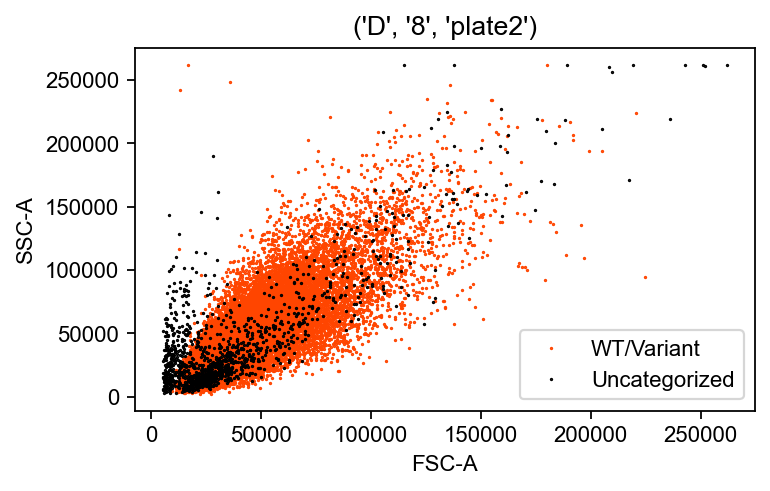

0.28792284235160626
('H', '8', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


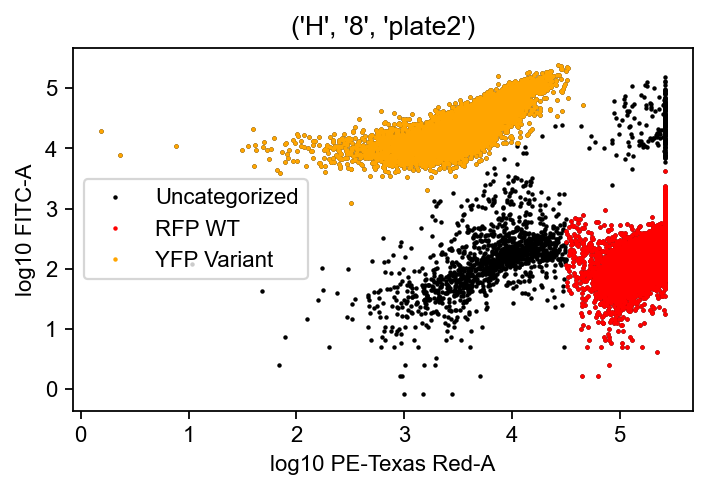

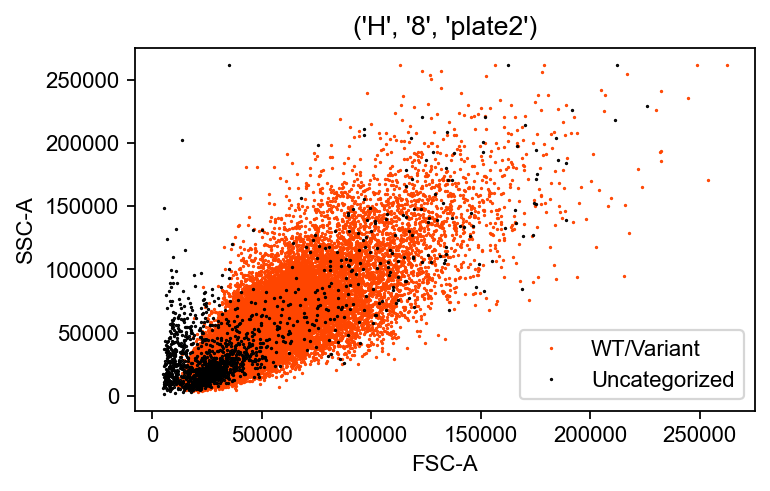

0.2643747344568758
('D', '9', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


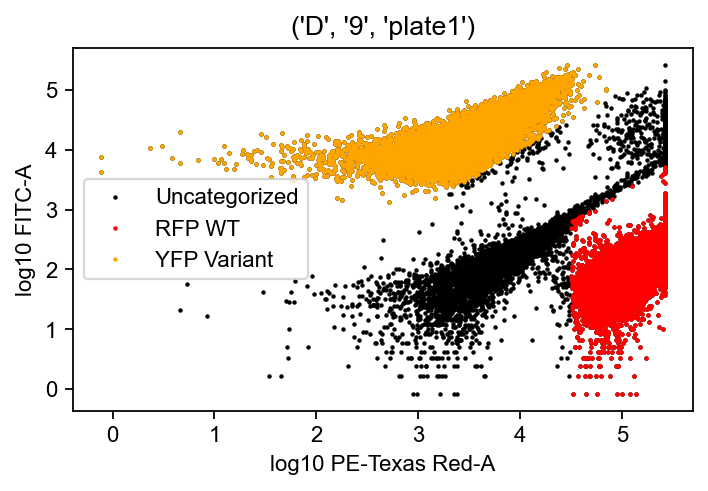

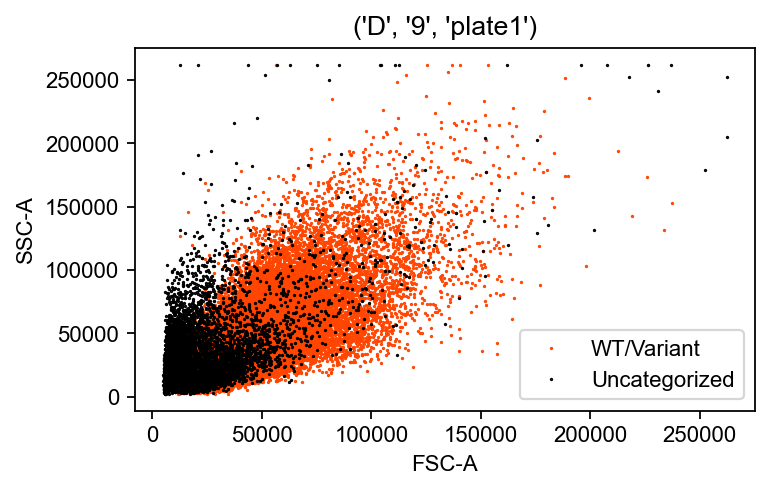

0.40540415597623836
('D', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


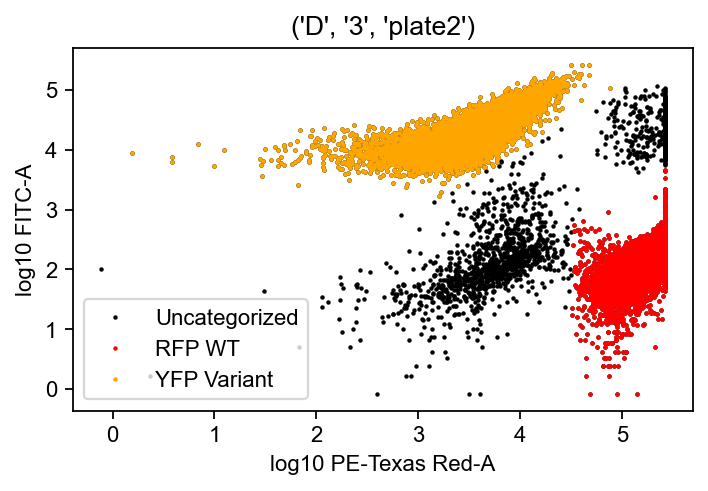

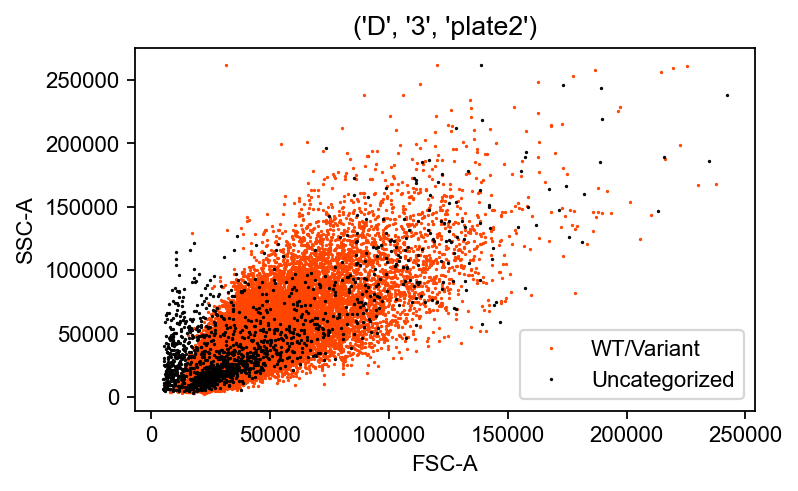

0.35479036574487066
('H', '3', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


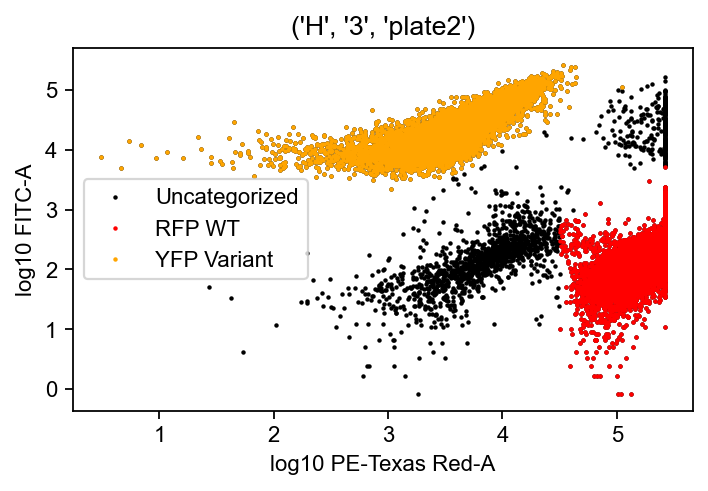

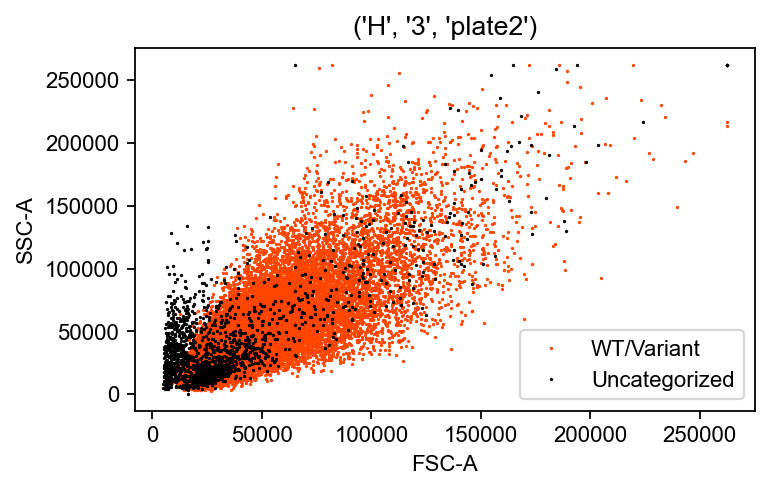

0.31884109745641614
('D', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


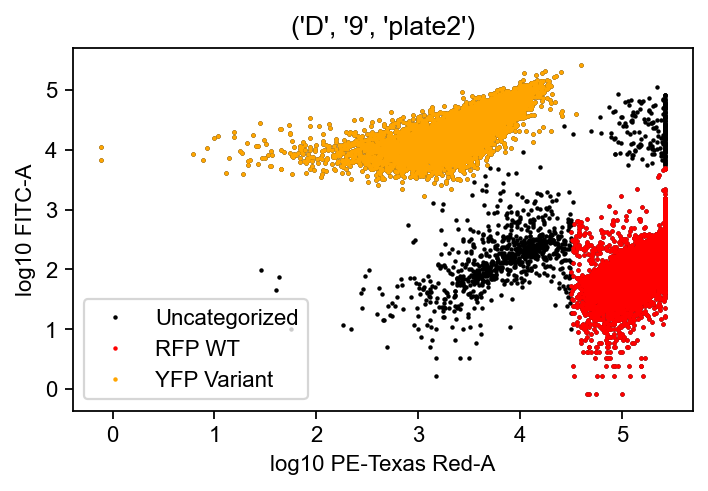

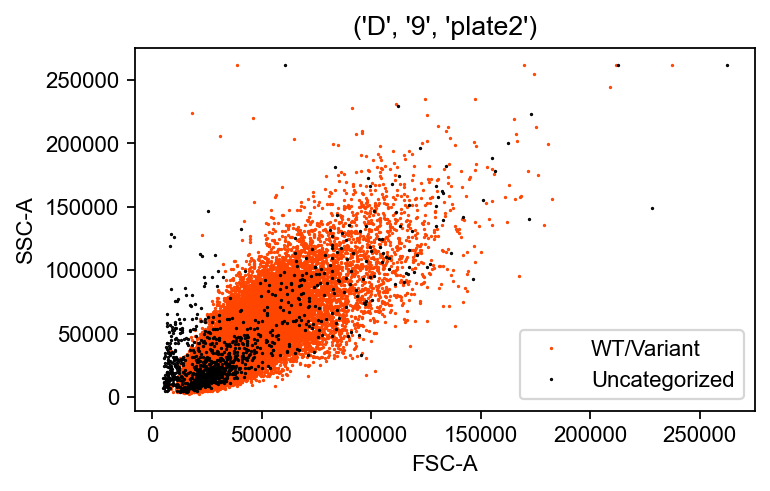

0.2712365402209867
('H', '9', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


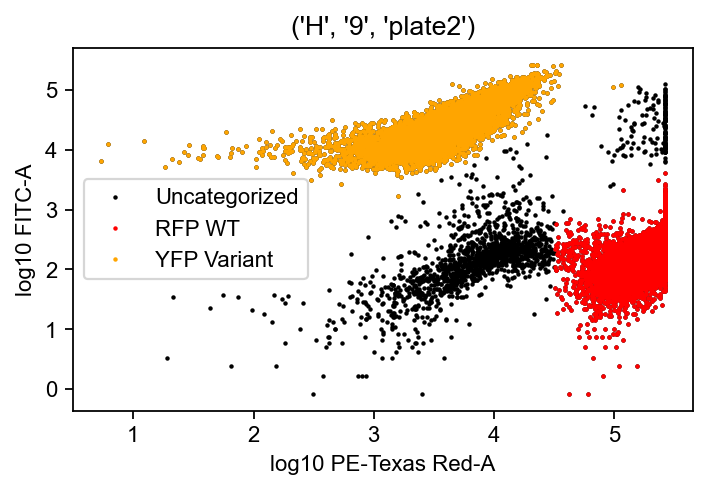

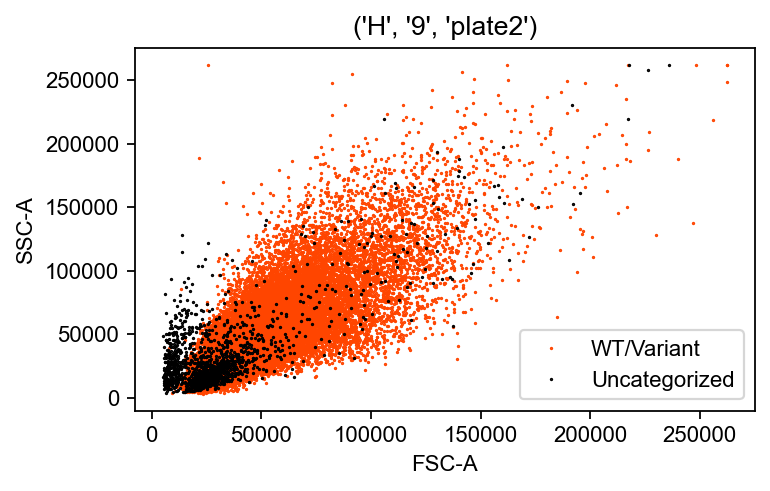

0.256822853902318
('D', '10', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


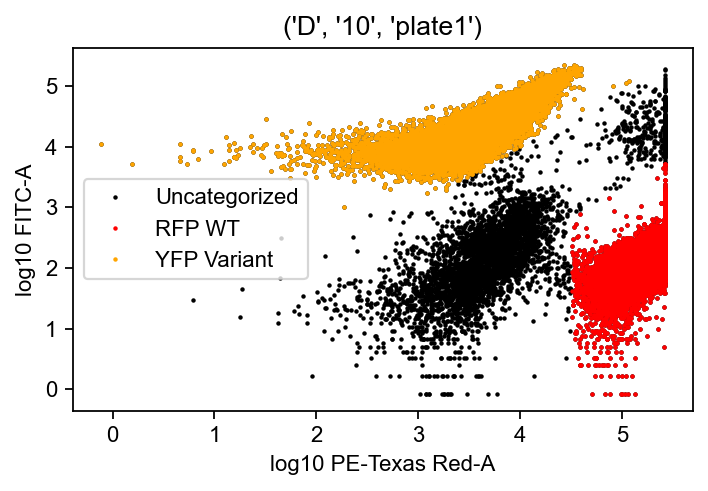

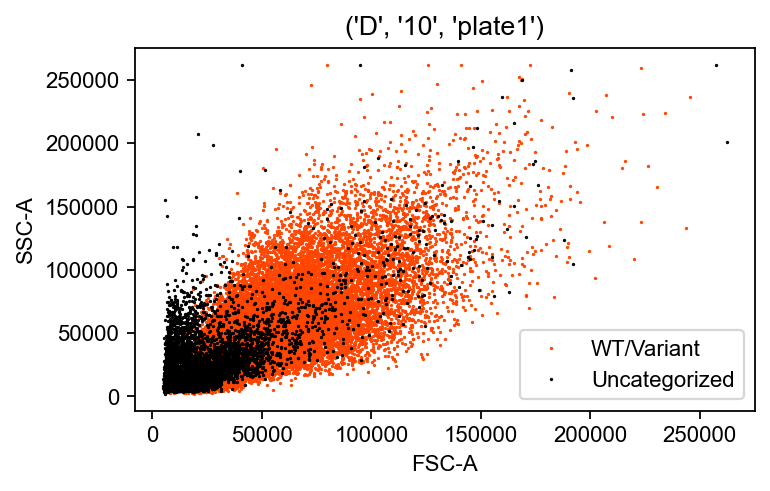

0.43521363687338793
('D', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


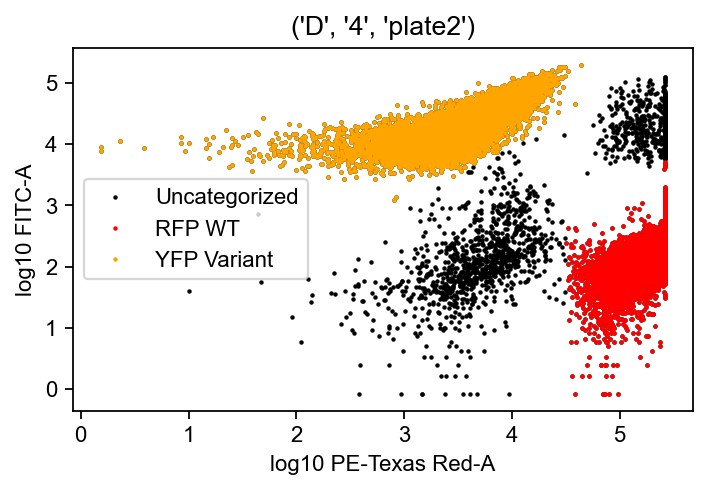

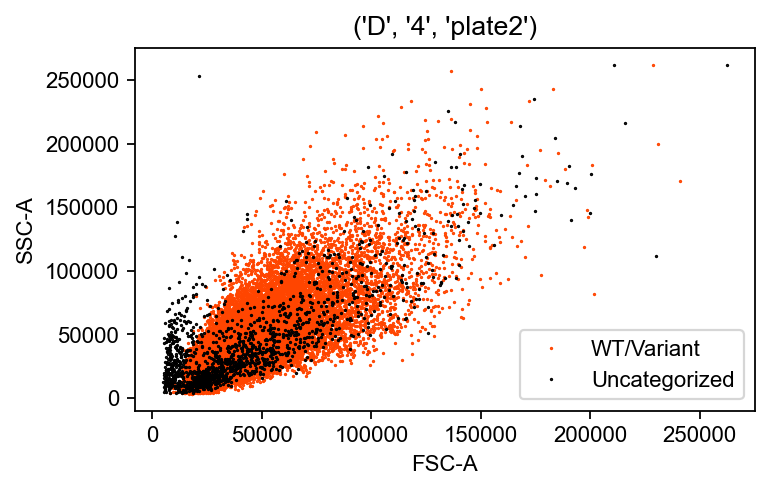

0.43099535285853235
('H', '4', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


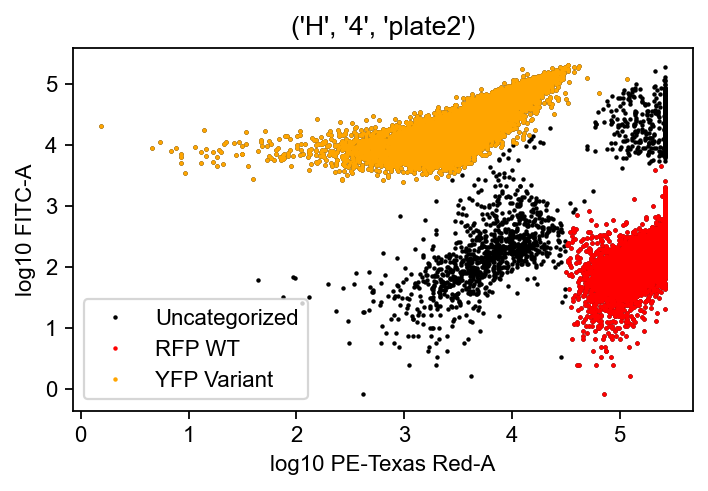

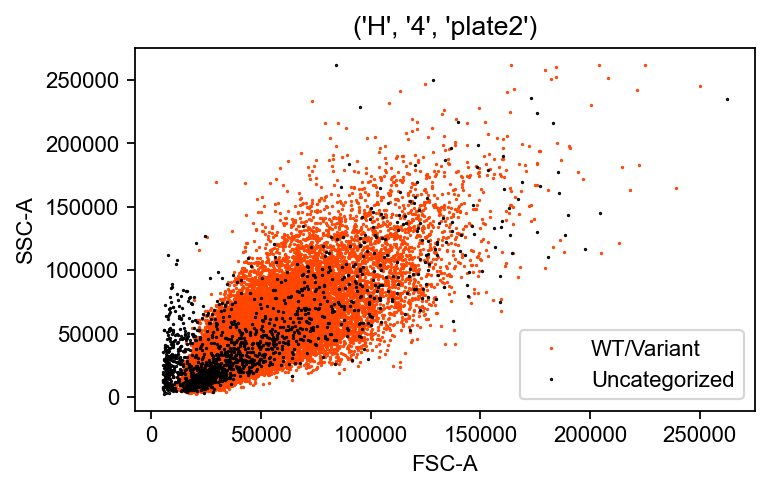

0.4452108369480196
('D', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


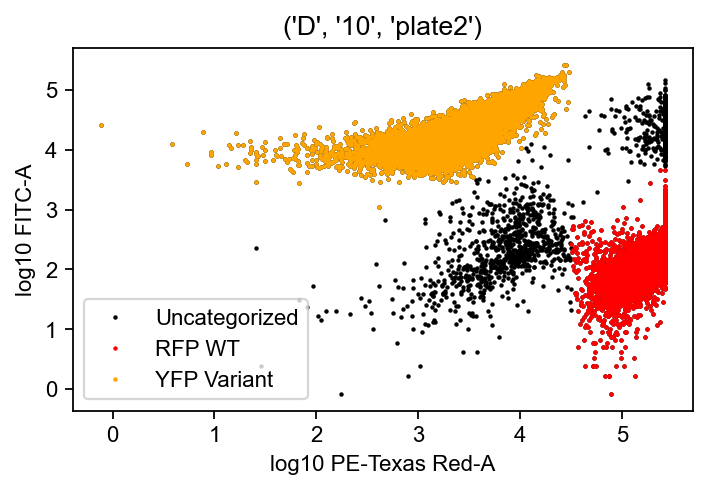

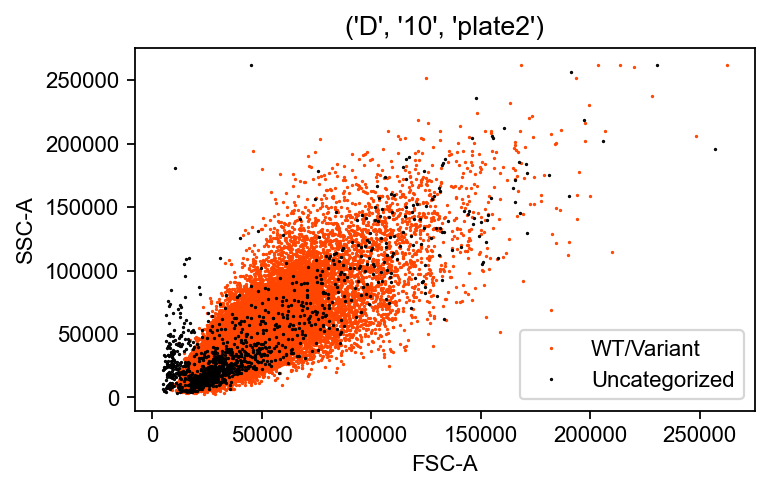

0.44902409002989274
('H', '10', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


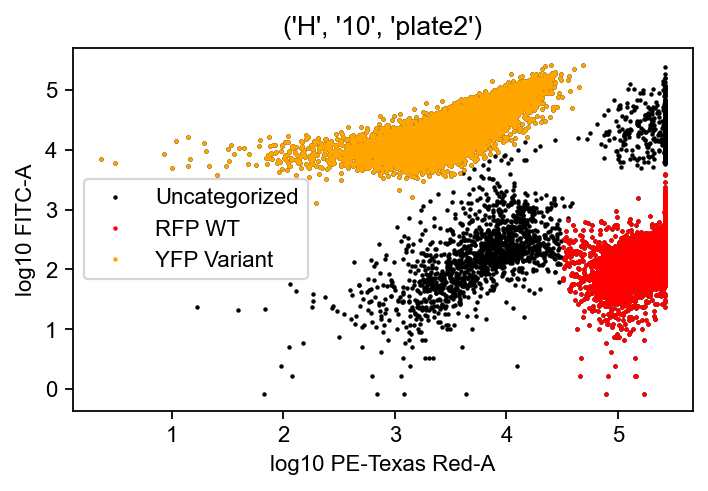

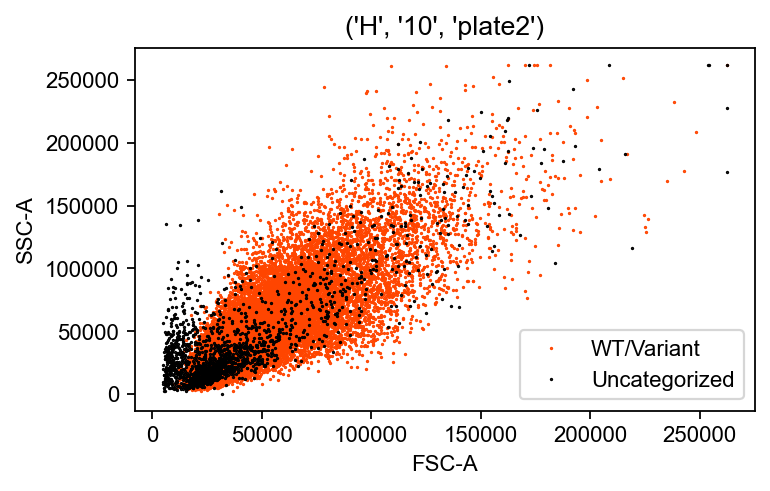

0.46689595872742906
('D', '11', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


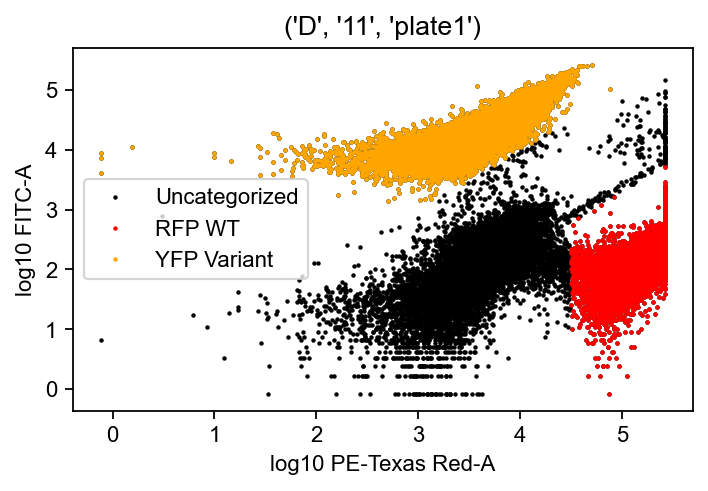

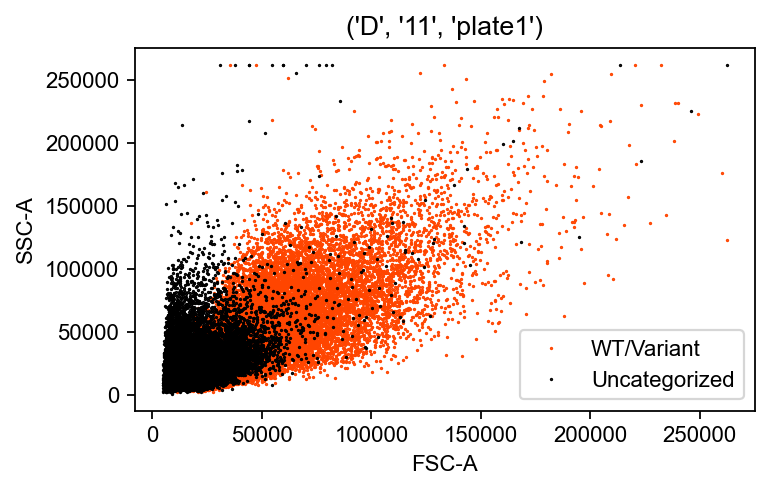

0.571580642519857
('D', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


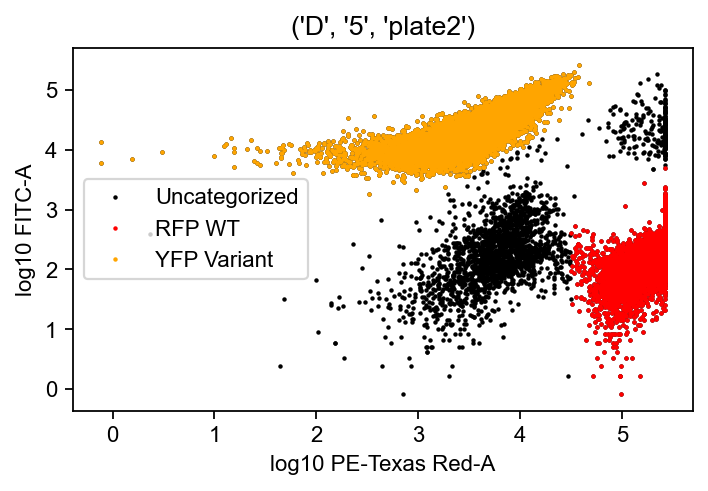

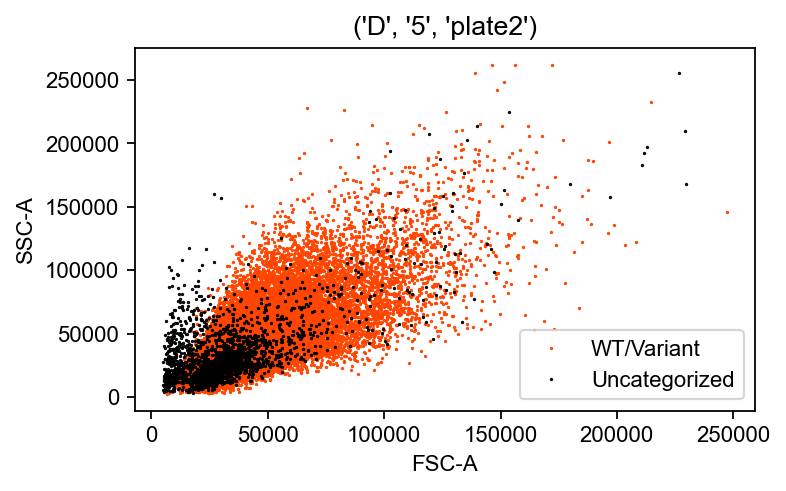

0.578993467391701
('H', '5', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


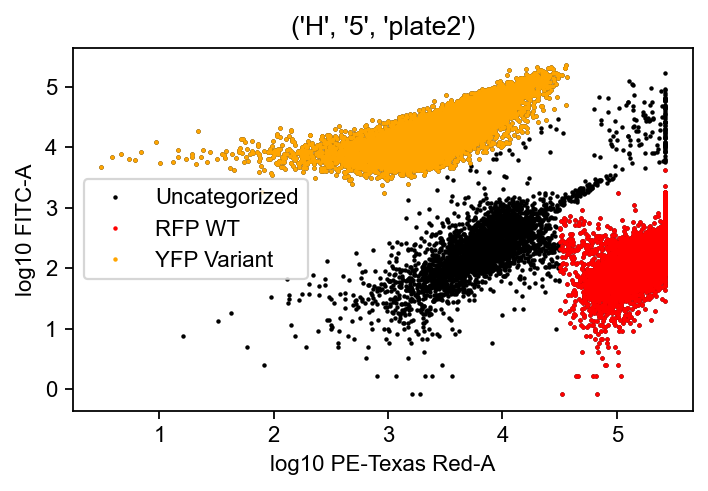

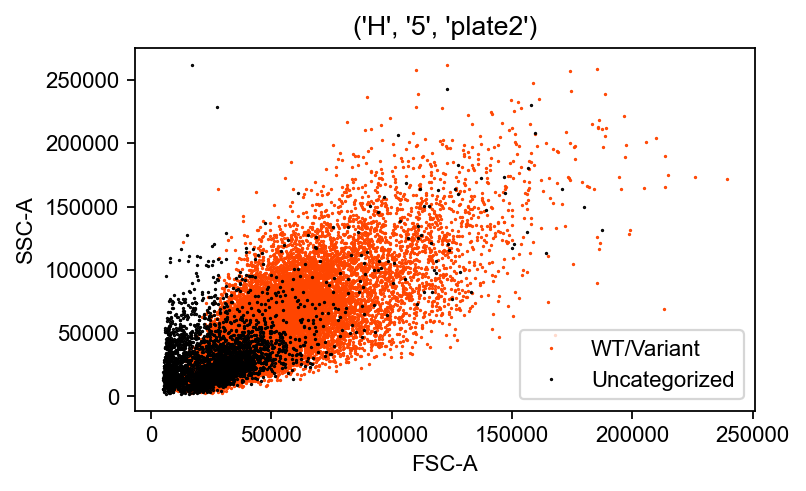

0.5853284223449969
('D', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


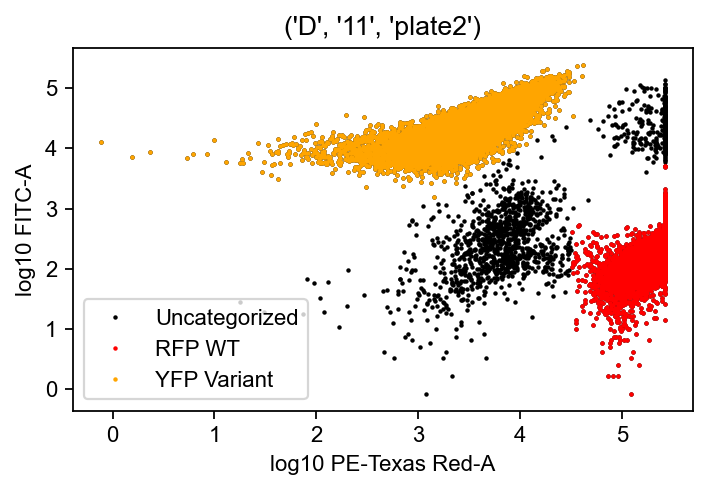

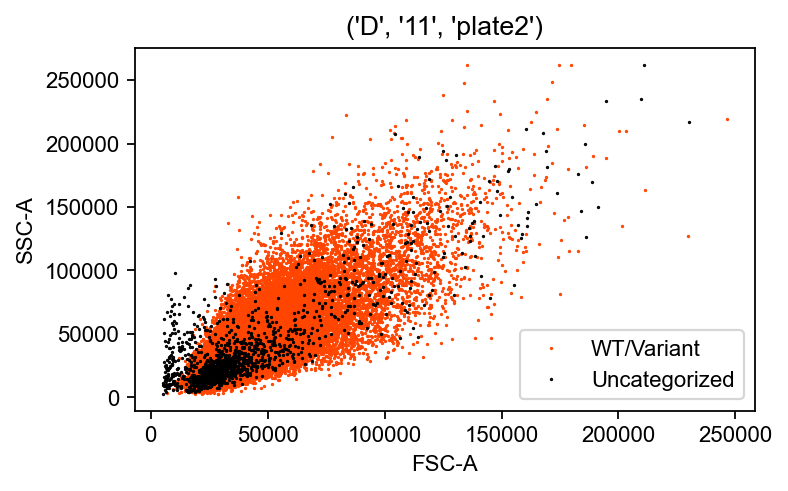

0.6057130721036423
('H', '11', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


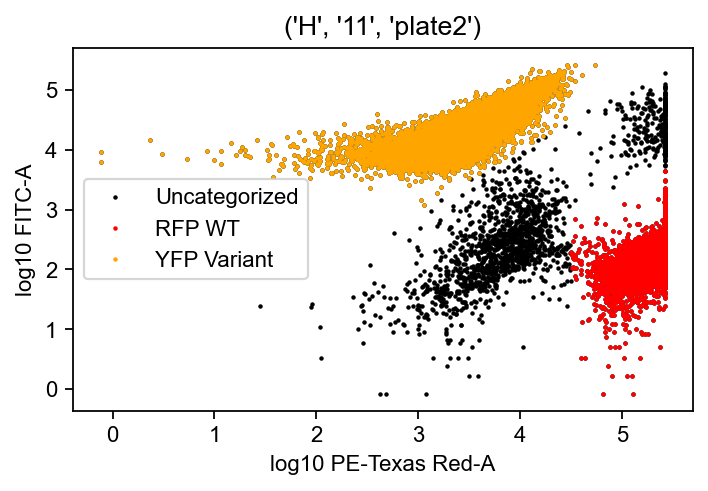

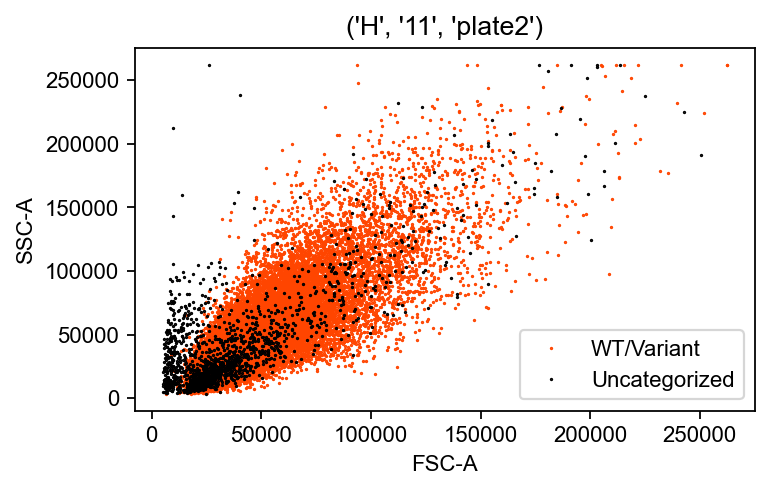

0.6211899231731285
('D', '12', 'plate1')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


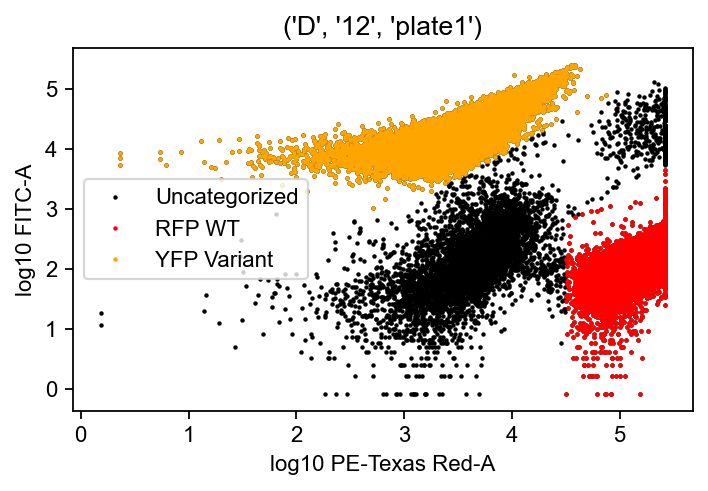

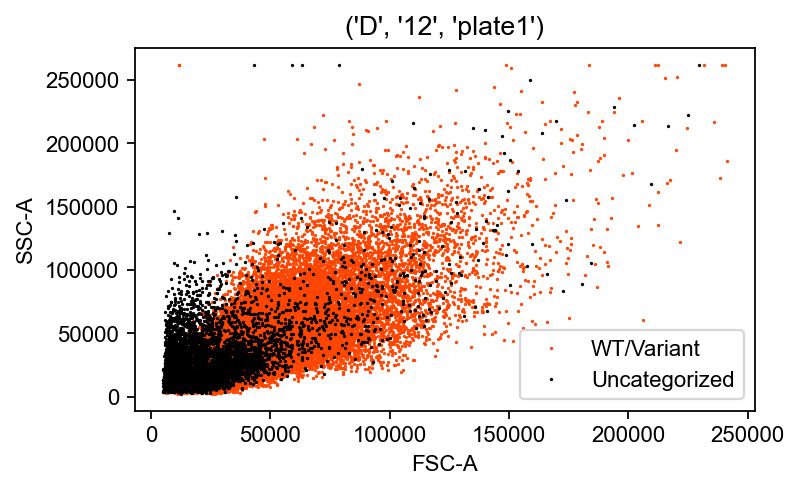

0.4803476336476175
('D', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


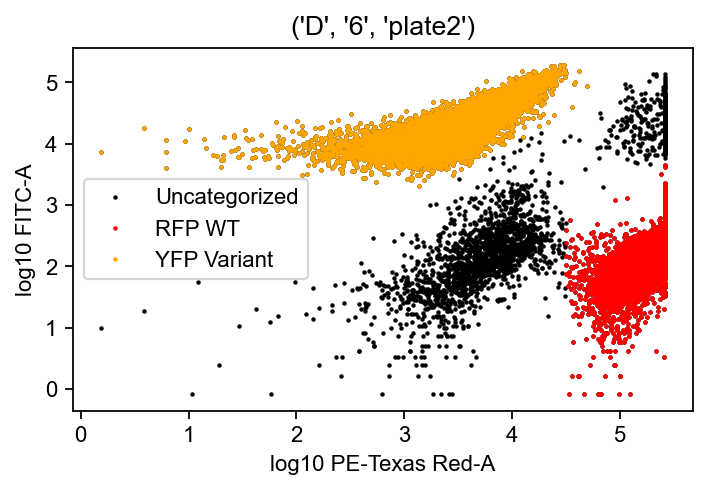

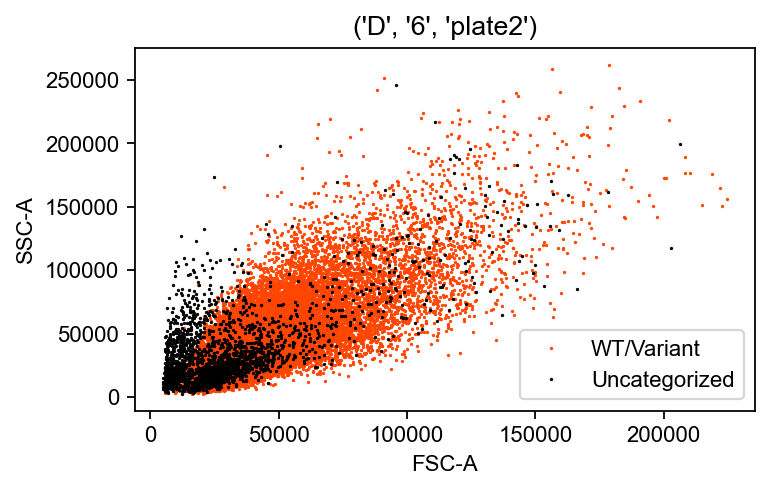

0.49710982658959535
('H', '6', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


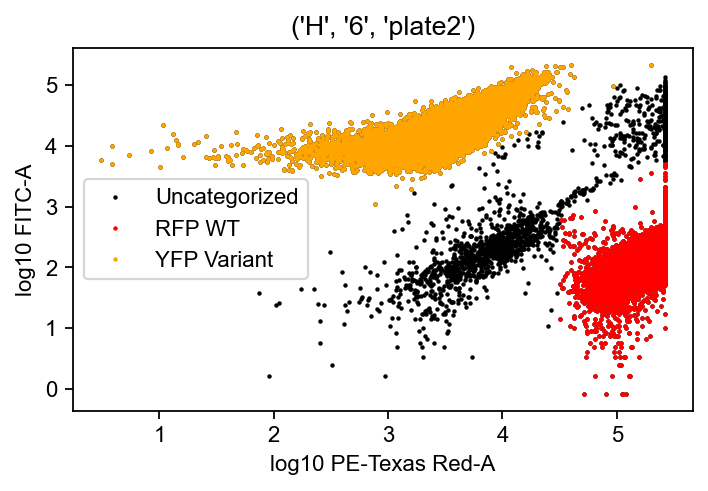

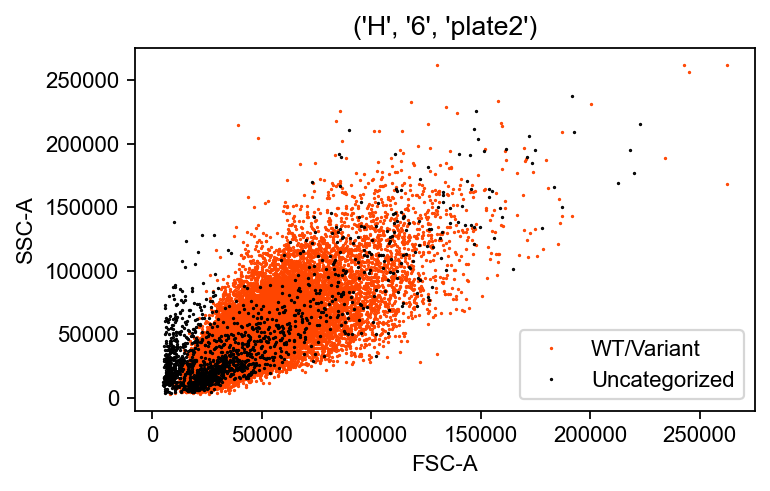

0.5026955621407405
('D', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


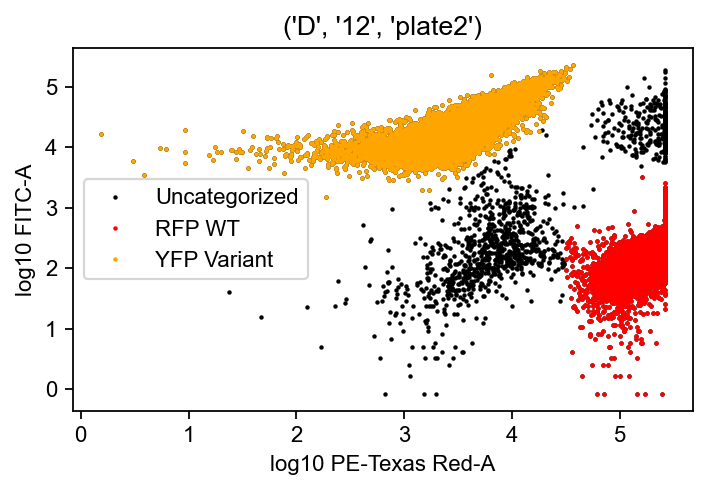

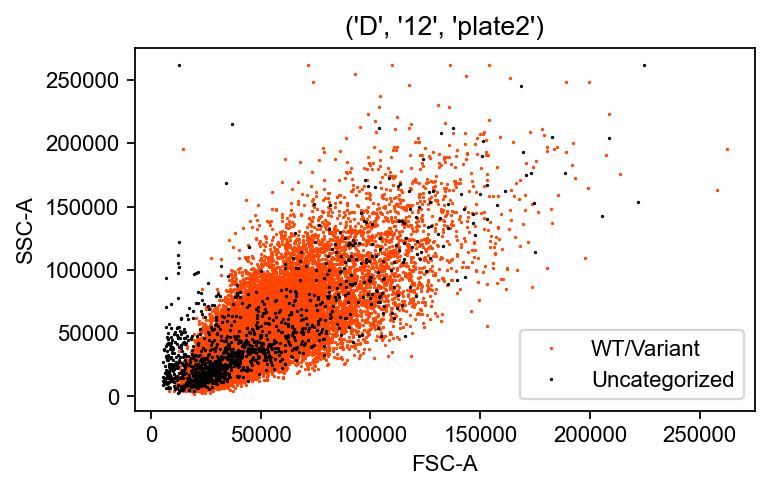

0.5153156321434852
('H', '12', 'plate2')


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in log10
  after removing the cwd from sys.path.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in log10
  # This is added back by InteractiveShellApp.init_path()


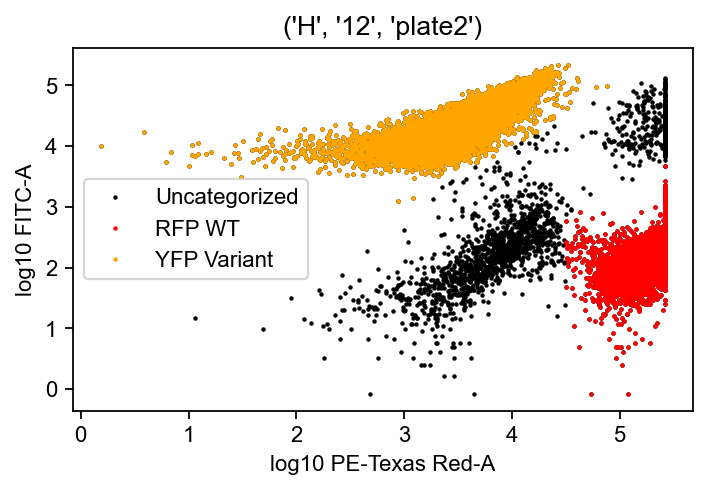

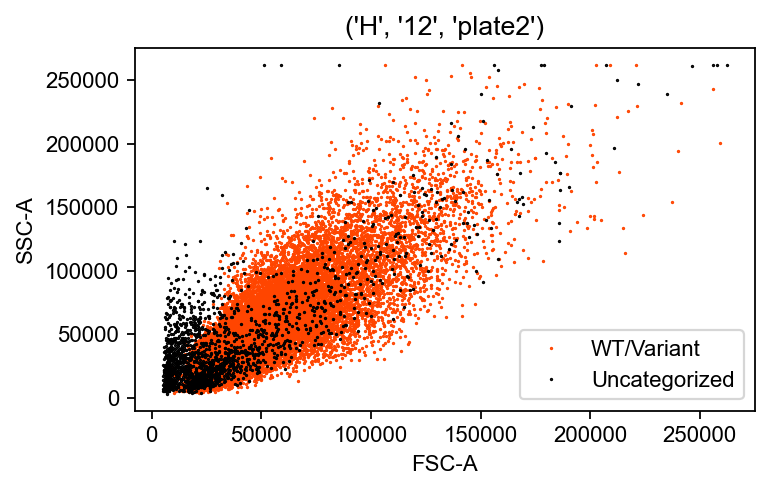

0.5315695387915624


In [7]:
results={}
for well in wells:
    print(well)
    fcs=FlowCal.io.FCSData(exp_dir+spec_names[well])
    title=str(well)
    results[well] = split_red_yellow(fcs, title=title) 
    print(results[well])

In [17]:
exp_results = {} #compile timepoints for each replicate
for exp in exp_to_pos.keys():
    exp_results[exp] = np.array([results[well] for well in pos_to_wells[exp_to_pos[exp]]])
    
variants=['YC1','YC3','YC4','YC7','YC8','J','Y']
#Note: YC5 is a non-significant slow-to-fast variant included in the competition by mistake and is excluded from the figures

    
var_results = {} #calculate mean and stdev of log2fold change across replicates for each variant
for var in variants:
    var_results[var] = {}
    all_exp_for_var = [x for x in exp_results.keys() if x.split('.')[0]==var]
    all_var = np.concatenate([exp_results[exp] for exp in all_exp_for_var])
    all_var = all_var.reshape((len(all_exp_for_var),-1))
    log2fc = np.concatenate([np.log2(exp_results[exp]/exp_results[exp][0]) for exp in all_exp_for_var])
    log2fc = log2fc.reshape((len(all_exp_for_var),-1))
    var_results[var]["mean"] = np.mean(all_var, axis=0)
    var_results[var]["stdev"] = np.std(all_var, axis=0)
    var_results[var]["stdev_of_log"] = np.std(np.log2(all_var), axis=0)
    var_results[var]["log2fc_mean"] = np.mean(log2fc, axis=0)
    var_results[var]["log2fc_stdev"] = np.std(log2fc, axis=0)

In [9]:
inserts = pd.read_csv('../data/fluor/pooled_results.csv') #the results for the 5 slow-to-fast mutations from a previous 19-generation pooled competition 

In [10]:
variant_to_gene = {'YC1':('YML049C', 15, 'RSE1'),
                   'YC3':('YER018C', 185, 'SPC25'),
                   'YC4':('YHR070W', 460, 'TRM5'),
                   'YC7':('YOR026W', 105, 'BUB3'),
                   'YC8':('YPR183W', 158, 'DPM1')}

In [18]:
init_growth = {}
init_growth_stdev = {}
for v in variant_to_gene:  
    print('\n',v, variant_to_gene[v][2])
    x = variant_to_gene[v]
    idb = inserts[inserts.target == 'w1_'+x[0]+'_'+str(x[1])]
    print('mean growth rate:', 1+(np.mean(np.log(2**idb['l2fc_init_fixed']))/19))
    init_growth[v] = (np.mean(idb['l2fc_init_fixed'])/19)
    init_growth_stdev[v] = np.sum((idb.l2fc_SE_init_fixed**2)/len(idb.l2fc_SE_init_fixed))**0.5 / 19 #pooled stdev across guides making the same mutation
    print('pooled stdev', init_growth_stdev[v])


for x in 'J', 'Y':
    init_growth[x] = 'n/a'
    init_growth_stdev[x] = 'n/a'


 YC1 RSE1
mean growth rate: 0.9909263711639782
pooled stdev 0.003327007115359389

 YC3 SPC25
mean growth rate: 1.0229270753396553
pooled stdev 0.004320118074842592

 YC4 TRM5
mean growth rate: 1.0085329542599917
pooled stdev 0.002501751610283522

 YC7 BUB3
mean growth rate: 0.9896125539266145
pooled stdev 0.002730936782763384

 YC8 DPM1
mean growth rate: 1.0116917607397995
pooled stdev 0.0030161761544413115


In [19]:
#calculating slopes just for the control 
#assuming OD goes from roughly 
#0.1 to 0.5 (2.3 doublings), and then 0.025 to 1  (5.3 doublings) [v rough whatev]
#there are 
#Changed 
x = np.array([0,7.6,15.2,22.8,30.4]) #could this be an overestimate?
df = pd.DataFrame(columns = ['Variant', 'Pooled', 'Pooled_stdev', 'Growth Rate (pre-norm)', 'Paired', 'Paired_stdev', 'Zscore'])
for i, var in enumerate(variants):
    slopes = []
    for exp in [var+'.'+num for num in ["1","2","3"]]:
        slopes.append(1+np.polyfit(x, np.log2(exp_results[exp]), 1)[0])
    control_mean = np.mean([1+np.polyfit(x, np.log2(exp_results[exp]),1)[0] for exp in ['Y.1','Y.2','Y.3']])
    zscore = (np.mean(slopes) - control_mean) / np.std(slopes)
    df.loc[len(df.index)] = (var, init_growth[var], init_growth_stdev[var], np.mean(slopes), np.mean(slopes)/control_mean - 1, np.std(slopes),  zscore)

#SO looks like YC1 and YC7 might be slow
#YC3 and YC4 might be fast
#YC5 and YC8 are too close.
#J is indeed growing slowly

#is this the right way to do this? the have different starting values after all....
df = df.set_index('Variant')
df

,Pooled,Pooled_stdev,Growth Rate (pre-norm),Paired,Paired_stdev,Zscore
Variant,,,,,,
YC1,-0.0130905,0.00332701,0.988703,-0.015234,0.001172,-13.045369
YC3,0.0330768,0.00432012,1.011269,0.007243,0.001049,6.932071
YC4,0.0123105,0.00250175,1.009456,0.005437,0.002433,2.243566
YC7,-0.0149859,0.00273094,0.998631,-0.005345,0.000598,-8.966051
YC8,0.0168676,0.00301618,1.004679,0.000679,0.001823,0.374063
J,n/a,n/a,0.978027,-0.025867,0.001620,-16.032138
Y,n/a,n/a,1.003997,0.000000,0.000443,0.000000


Pooled [-0.013090479324595686, 0.033076777894608264, 0.012310450795022292, -0.014985916937574792, 0.01686764523856916]
Paired [-0.015233818546580236, 0.007243172665656328, 0.005436915859687863, -0.0053447579270442525, 0.0006793360218950717]
[0.35 1.35 2.35 3.35 4.35] ['YC1', 'YC3', 'YC4', 'YC7', 'YC8']


/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:19: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "o" (-> marker='o'). The keyword argument will take precedence.
/mnt/lareaulab/shelen/anaconda3/envs/gen_env/lib/python3.7/site-packages/ipykernel_launcher.py:19: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "o" (-> marker='o'). The keyword argument will take precedence.


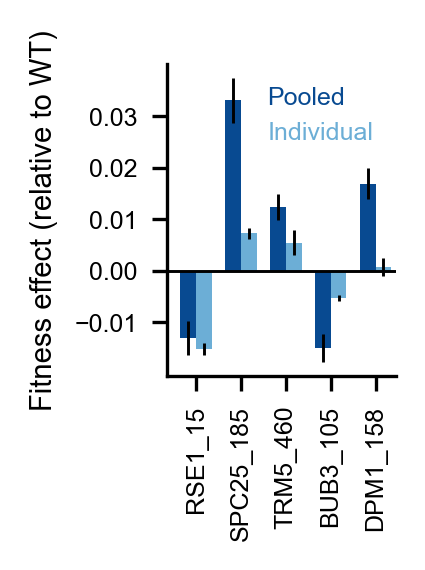

In [20]:
v_list = ['YC1', 'YC3', 'YC4','YC7','YC8']
x = np.arange(len(v_list))  # the label locations
width = 0.35  # the width of the bars
multiplier = 0

fig, ax = plt.subplots(figsize=(2.5*cm,3.5*cm)) 

import matplotlib as mpl
cmap = mpl.cm.Blues.reversed()
colors = {'Pooled':cmap(0.1), 'Paired':cmap(0.5)}
labels = {'Pooled':'Pooled', 'Paired':'Individual'}


for attribute in ['Pooled', 'Paired']:
    measurement = [df[attribute][v] for v in v_list]
    print(attribute, measurement)
    offset = width * multiplier
    ax.bar(x + offset+width/2, measurement, width, color = colors[attribute], label=labels[attribute])
    ax.errorbar(x + offset+width/2, measurement, [df[attribute+'_stdev'][v] for v in v_list], fmt='o', marker=' ', color='black', linewidth=0.7)
    multiplier += 1

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Fitness effect (relative to WT)', fontsize=7)
plt.axhline(0, linewidth=0.7, color='black')
ax.set_xlim((-0.3, 4.8))
plt.yticks([-0.01, 0, 0.01, 0.02, 0.03], fontsize=6)
print(x + width, v_list)
ax.set_xticks(x + width)
ax.set_xticklabels([variant_to_gene[v][2]+'_'+str(variant_to_gene[v][1]) for v in v_list], fontsize=6, rotation=90)

exps_ = ['Pooled','Paired']
handles = [mlines.Line2D([],[],color='none',label=labels[x]) for x in exps_]
ax.legend(handles=handles, labelcolor=[colors[x] for x in exps_], 
                                       loc='upper right', frameon=False, fontsize=6, handlelength=1)

ax.spines[['top','right']].set_visible(False)
plt.savefig(fig_dir + 'pooled_individual_comparison.pdf', format='pdf', bbox_inches='tight')
plt.show()

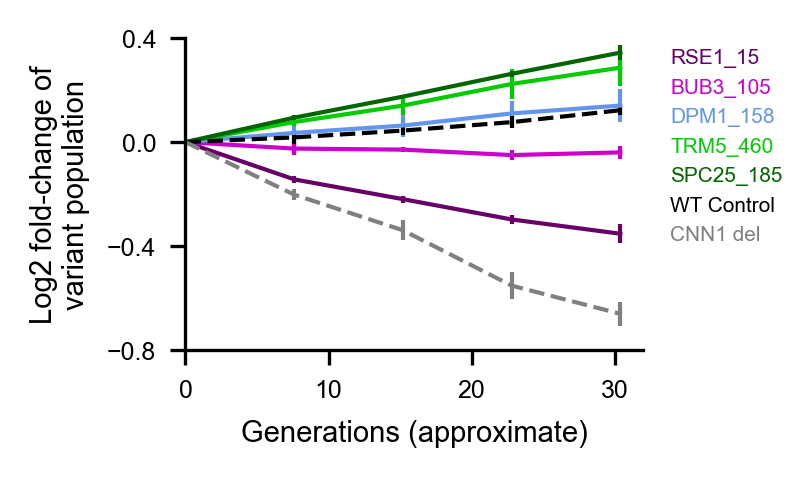

In [21]:
var_to_gene = {x:variant_to_gene[x][2]+'_'+str(variant_to_gene[x][1]) for x in v_list} #add names later
var_to_gene['Y'] = 'WT Control'
var_to_gene['J'] = 'CNN1 del'

x = np.array([0,7.6,15.2,22.8,30.4]) #generations (approx)
fig, ax = plt.subplots(figsize=(5*cm,3.5*cm))

def adjust_lightness(color, amount=0.5):
    import matplotlib.colors as mc
    import colorsys
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], amount, c[2])


colors = {'YC1':adjust_lightness('purple', 0.2), 
          'YC3':adjust_lightness('green', 0.2), 
          'YC4':adjust_lightness('green', 0.4), 
          'YC7':adjust_lightness('purple', 0.4),
          'YC8':'cornflowerblue',
         'Y':'black','J':'gray'}


v_order = ['YC1','YC7','YC8','YC4','YC3','Y','J']

for var in v_order:
    if var is "Y" or var is 'J':
        plt.errorbar(x, var_results[var]["log2fc_mean"], yerr=var_results[var]["log2fc_stdev"], label=var_to_gene[var], 
                     linestyle="dashed", c=colors[var], lw=1)
    else:
        plt.errorbar(x, var_results[var]["log2fc_mean"], yerr=var_results[var]["log2fc_stdev"], 
                     label=var_to_gene[var], c=colors[var], lw=1)
plt.ylabel("Log2 fold-change of\nvariant population", fontsize=7)
plt.xlabel("Generations (approximate)", fontsize=7)
plt.xticks([0,10,20,30], fontsize=6)
plt.xlim(0,32)
plt.yticks([-0.8,-0.4,0,0.4], fontsize=6)


handles = [mlines.Line2D([],[],color='none',label=var_to_gene[v]) for v in  v_order]

plt.legend(handles=handles, labelcolor=[colors[v] for v in v_order], borderpad=0, #loc='lower left', 
           ncol=1, fontsize=5, frameon=False, handlelength=0, columnspacing=0, bbox_to_anchor=(1,1))
plt.ylim(-0.8, 0.4)
ax.spines[['top','right']].set_visible(False)
plt.savefig(fig_dir+'individual_timepoints.pdf', format='pdf', bbox_inches='tight')
plt.show()